# Common code and variables

In [9]:
%%capture
%pip install plotly pandas numpy matplotlib seaborn ipympl itables ipykernel tex latex

#  sudo apt-get install texlive  dvipng  cm-super texlive-latex-extra texlive-fonts-recommended 


In [10]:
%matplotlib widget

pathData = '~/KIT/Messungen/Messung-Dec24/'
path = './graphs/'


import pandas as pd
import numpy as np
import plotly.express as px
import plotly.graph_objects as go
import matplotlib as mpl
# Use the pgf backend (must be set before pyplot imported)
# mpl.use('pgf')

from datetime import datetime as dt
from matplotlib import pyplot as plt, ticker
import seaborn as sns
import itables as it
from itables import init_notebook_mode, show 
init_notebook_mode(all_interactive=True)
sns.set_theme(style="whitegrid")
# plt.style.use('seaborn')
sns.set_context("talk")
sns.set(font_scale=2)
width = 800
plt.legend(loc='upper center')


<IPython.core.display.Javascript object>

In [11]:
def set_size(width, fraction=1, subplots=(1, 1)):
    """Set figure Amount_of_Values to avoid scaling in LaTeX.

    Parameters
    ----------
    width: float or string
            Document width in points, or string of predined document type
    fraction: float, optional
            Fraction of the width which you wish the figure to occupy
    subplots: array-like, optional
            The number of rows and columns of subplots.
    Returns
    -------
    fig_dim: tuple
            Amount_of_Values of figure in inches
    """
    if width == 'thesis':
        width_pt = 426.79135
    elif width == 'beamer':
        width_pt = 307.28987
    elif width == 'acm':
        width_pt = 506.295
    else:
        width_pt = width

    # Width of figure (in pts)
    fig_width_pt = width_pt * fraction
    # Convert from pt to inches
    inches_per_pt = 1 / 72.27

    # Golden ratio to set aesthetic figure height
    # https://disq.us/p/2940ij3
    golden_ratio = (5**.5 + 1) / 2

    # Figure width in inches
    fig_width_in = fig_width_pt * inches_per_pt
    # Figure height in inches
    fig_height_in = fig_width_in / golden_ratio * (subplots[0] / subplots[1])

    return (fig_width_in, fig_height_in)

In [12]:
databases = {'ClickhouseDB': '#orange',
             'ClickHouse': '#orange',
             'DatalayertsDB': '#75BDA7',
             'TimescaleDB': '#c78181',
             'InfluxDB': '#c78351',
             'PostgresDB': 'orange', }
databases_modes = {'ClickhouseDB_dedicated_regular': '#75BBA1',
                   'ClickhouseDB_dedicated_irregular': '#c77581',
                   'DatalayertsDB_dedicated_regular': '#75BDA7',
                   'DatalayertsDB_dedicated_irregular': '#75BBA1',
                   'TimescaleDB_dedicated_regular': '#c78181',
                   'TimescaleDB_dedicated_irregular': '#c78242',
                   'InfluxDB_dedicated_regular': '#8371ff',
                   'InfluxDB_dedicated_irregular': '#8381rr',
                   'PostgresDB_dedicated_regular': '#8791ff',
                   'PostgresDB_dedicated_irregular': '#8791rr',
                   'DummyDB_dedicated_regular': '#8791ff',
                   'DummyDB_dedicated_irregular': '#8791rr'}
databases_dims = {
    'ClickhouseDB_1': '#8791rr',
    'InfluxDB_1': '#8791rr',
    'DatalayertsDB_1': '#75BDA7',
    'TimescaleDB_1': '#c78181',
    'PostgresDB_1': '8791rr',
}
labels = {'ClickhouseDB': 'ClickHouse',
          'InfluxDB': 'InFlux',
          'PostgresDB': 'PostGreSQL',
          'TimescaleDB': 'TimeScale',
          'DatalayertsDB': 'DataLayerTSold',
          'DatalayertsDBasVect': 'DataLayerTS',

          }
labels_dims = {'ClickhouseDB_1': 'ClickHouse 1Dim',
               'InfluxDB': 'InfluxDB',
               'PostgresDB': 'PostgreSQL',
               'TimescaleDB': 'TimescaleDB',
               'DatalayertsDB': 'DatalayerTS',
               }
labels_modes = {'ClickhouseDB_dedicated_regular': 'ClickhouseDB_dedicated_regular',
                'ClickhouseDB_dedicated_irregular': 'ClickhouseDB_dedicated_irregular',
                'DatalayertsDB_dedicated_regular': 'DatalayertsDB_dedicated_regular',
                'DatalayertsDB_dedicated_irregular': 'DatalayertsDB_dedicated_irregular',
                'TimescaleDB_dedicated_regular': 'TimescaleDB_dedicated_regular',
                'TimescaleDB_dedicated_irregular': 'TimescaleDB_dedicated_irregular',
                'PostgresDB_dedicated_regular': 'PostgresDB_dedicated_regular',
                'PostgresDB_dedicated_irregular': 'PostgresDB_dedicated_irregular',
                'DummyDB_dedicated_regular': 'DummyDB_dedicated_regular',
                'DummyDB_dedicated_irregular': 'DummyDB_dedicated_irregular',
                'InfluxDB_dedicated_regular': 'InfluxDB_dedicated_regular',
                'InfluxDB_dedicated_irregular': 'InfluxDB_dedicated_irregular',
                }
modes = {
    'dedicated_irregular': '#f5700a',
    'dedicated_regular': '#8791ff',
    'mixed_irregular': '#75BDA7',
    'mixed_regular': '#c78181',
}
color_discrete_map_extra = {'ClickhouseDB': 'blue',
                            'TimescaleDB': 'yellow',
                            'InfluxDB': 'red',
                            'DatalayertsDB': 'green'}

colnamesRead = ['Date', 'SucceededDataPoints', 'FailedDataPoints',
                'Operation', 'Latency', 'Mode', 'System', 'ClientLatency', 'ClientsNumber', 'SensorsNumber', 'ContentStartDate',
                'Duration', 'Iteration', 'Aggregations', 'Amount_of_Values']

colnamesWrite = ['Date', 'SucceededDataPoints', 'FailedDataPoints',
                 'Operation', 'Latency', 'Mode', 'System', 'ClientLatency', 'ClientsNumber', 'SensorsNumber', 'ContentStartDate',
                 'BatchSize', 'Iteration', 'Amount_of_Values']
colnames = ['Timestamp', 'SucceededDataPoints', 'FailedDataPoints', 'Operation', 'Latency', 'Mode', 'Percentage', 'System',
            'ClientLatency', 'ClientsNumber', 'SensorsNumber', 'StartDate', 'BatchSize', 'Duration', 'Iteration', 'Aggregation', 'Amount_of_Values']


syscolnames = ['Timestamp', 'System', 'Operation', 'ClientsNumber', 'BatchSize', 'Amount_of_Values', 'Percentage', 'SensorsNumber', 'Mode', 'CpuTotal', 'CpuSystem', 'CpuUser', 'CpuIOWait', 'CpuContextSwitches', 'CpuSysCalls', 'MemActive', 'MemAvailable', 'MemBuffers', 'MemCached', 'MemFree', 'MemInActive', 'MemTotal', 'MemShared', 'MemUsed', 'SwapFree', 'SwapSin', 'SwapSout', 'SwapTotal', 'SwapUsed', 'DiskReadBytes', 'DiskReadCount', 'DiskWriteBytes',
               'DiskWriteCount', 'FsDeviceName', 'FsFree', 'FsFs_Type', 'FsKey', 'FsMnt_Point', 'FsPercent', 'FsSize', 'FsUsage', 'NetworkCumulativeConnections', 'NetworkCumulativeReceives', 'NetworkCumulativeTransmissions', 'NetworkConnections', 'NetworkTransmissions', 'NetworkReceives', 'NetworkIsUp', 'NetworkSpeed', 'ProcessCpuPercent', 'ProcessCpuTimes', 'ProcessIOCounters', 'ProcessMemoryInfo', 'ProcessMemoryPercent', 'ProcessThreadsNumber', 'ProcessStatus']


legend_kwargs = dict(borderpad=0.5, frameon=True, framealpha=1,
                     facecolor='white', edgecolor='#F5F5F5', ncol=2, title=None)

In [13]:
# System Metrics Helpers
def to_megabytes(x):
    return x / 1e6


def to_mbps(x):
    return x * 8 / 1e6


def used_mem(x):
    l = x * 100 / 32e9
    return l


def plot_database(ax, data, key, func, x=None, label=None):
    if func == 'log':
        ax.set_yscale('log')
    elif callable(func):
        data = func(data)
    if x is None:
        x = pd.Series(range(len(data)))
    return ax.plot(x, data, label=label, color=databases[key])

In [14]:
# FUNCTIONS

def _query_stat(group):
    lat = group['Latency']
    return pd.Series({'avg': lat.mean(), '50': lat.quantile(0.50), 'min': lat.min(), '20': lat.quantile(0.20), 'max': lat.max(), '70': lat.quantile(0.70),  'stddev': lat.std()})


def _query_support(col):
    return pd.Series({'support': col[col.columns[0]].count(), "CN":    col.ClientsNumber.min()})


def show_and_print_support(source, name, path, filterLowSupport, NormalizeWithCN):
    dbs = source.groupby(["System", 'Operation', 'Mode', 'BatchSize', 'ClientsNumber', 'Amount_of_Values', 'Percentage']
                         ).apply(_query_support)

    if filterLowSupport == False & NormalizeWithCN == True:
        dbs = dbs.assign(Support_CN_Normlzd=lambda x: (
            x.support / x.CN))

    if filterLowSupport == True & NormalizeWithCN == True:
        dbs = dbs.loc[dbs["Support_CN_Normlzd"] <
                      dbs["Support_CN_Normlzd"].quantile(0.25)]
    if filterLowSupport == True & NormalizeWithCN == False:
        dbs = dbs.loc[dbs["support"] < dbs["support"].quantile(0.25)]
    show_and_print(dbs, name, path)


def show_query_stat(qtype, table):
    dbs = table[table['Operation'] == qtype].groupby(
        ['Mode', "System"]).apply(_query_stat)
    show(dbs)
    print_query_stat(qtype, table, path)


def print_query_stat(qtype, table,  path):
    path = str(path)
    dbs = table[table['Operation'] == qtype].groupby(
        ['Mode', "System"]).apply(_query_stat)
    f = open(str(path)+str(qtype)+'.html', 'w')
    f.write(str(it.to_html_datatable(dbs, caption=None, connected=True)))
    f.close()


def show_and_print(content, name, path):
    name = str(name)
    path = str(path)
    show(content)
    f = open(str(path)+str(name)+'.html', 'w')
    f.write(str(it.to_html_datatable(content, caption=None, connected=True)))
    f.close()

# TODO insert older DLTS measurments and filter out that just PatchWork is kept and integrated, same for irregular ~~data~~

In [15]:
#  Loading Cleaned Data from CSV
# results = pd.read_csv(
#     pathData + 'results-prepared.csv', sep=",", on_bad_lines='warn')

# results['Timestamp'] = pd.to_datetime(
#     results['Timestamp'], unit='ms', errors='coerce')
# results['Latency'] = pd.to_numeric(results['Latency'], errors='coerce')
# results['ClientLatency'] = pd.to_numeric(
#     results['ClientLatency'], errors='coerce')
# results['BatchSize'] = pd.to_numeric(
#     results['BatchSize'], errors='coerce').fillna(0).astype(int)
# results['Amount_of_Values'] = pd.to_numeric(
#     results['Amount_of_Values'], errors='coerce')
# results['ClientsNumber'] = pd.to_numeric(
#     results['ClientsNumber'], errors='coerce')
# results['SucceededDataPoints'] = pd.to_numeric(
#     results['SucceededDataPoints'], errors='coerce')
results = [0]

sysdict = {'System': str, 'Operation': str, 'ClientsNumber': int,
           'BatchSize': int, 'Amount_of_Values': int, 'Percentage': int, 'SensorsNumber': int, 'Mode': str,
           'CpuTotal': float, 'CpuSystem': float, 'CpuUser': float, 'CpuIOWait': float, 'CpuContextSwitches': float,
           'CpuSysCalls': float, 'MemActive': int, 'MemAvailable': int, 'MemBuffers': int, 'MemCached': int,
           'MemFree': int, 'MemInActive': int, 'MemTotal': int, 'MemShared': int, 'MemUsed': int,
           'SwapFree': int, 'SwapSin': int, 'SwapSout': int, 'SwapTotal': int, 'SwapUsed': int,
           'DiskReadBytes': int, 'DiskReadCount': int, 'DiskWriteBytes': int, 'DiskWriteCount': int,
           'FsFree': int, 'FsPercent': float, 'FsSize': int, 'FsUsage': int,
           'NetworkCumulativeConnections': int, 'NetworkCumulativeReceives': int,
           'NetworkCumulativeTransmissions': int, 'NetworkConnections_bps': int,
           'NetworkTransmissions': int, 'NetworkReceives': int, 'NetworkIsUp': bool,
           'NetworkSpeed': int, 'ProcessCpuPercent': float, 'ProcessMemoryPercent': float,
           'ProcessThreadsNumber': int}


top_rates_raw = pd.read_csv(
    pathData + 'top_rates_raw-prepared.csv', sep=",", on_bad_lines='warn')

systemmetrics = pd.read_csv(
    pathData + 'system-prepared.csv', sep=",", on_bad_lines='warn')  # , dtype= sysdict,   na_filter= True)


systemmetrics['Timestamp'] = pd.to_datetime(
    systemmetrics['Timestamp'], unit='ms', errors='coerce')
systemmetrics['Mode'] = systemmetrics['Mode'].fillna('na')
systemmetrics['Operation'] = systemmetrics['Operation'].fillna('na')
systemmetricsDED = systemmetrics.loc[systemmetrics['Mode'].str.contains(
    'dedicated')]


cols = systemmetrics.columns.drop(
    {'Timestamp', 'System', 'Mode', 'Operation', 'NetworkIsUp'})

systemmetrics[cols] = systemmetrics[cols].apply(pd.to_numeric, errors='coerce')


results_rates = pd.read_csv(
    pathData + 'results_rates-prepared.csv', sep=",", on_bad_lines='warn')

systemmetrics_rates = pd.read_csv(
    pathData + 'systemmetrics_rates-prepared.csv', sep=",", on_bad_lines='warn')


combinedRates = pd.read_csv(
    pathData + 'combinedRates-prepared.csv', sep=",", on_bad_lines='warn')

ServerReadings = pd.read_csv(
    pathData + 'ServerReadings.csv', sep=",", on_bad_lines='warn')


print(systemmetrics.dtypes)
# print(results.dtypes)
print(top_rates_raw.dtypes)
print(combinedRates.dtypes)

/tmp/ipykernel_46961/558885751.py:38: DtypeWarning: Columns (44,50,51) have mixed types. Specify dtype option on import or set low_memory=False.
  systemmetrics = pd.read_csv(


Timestamp                         datetime64[ns]
IterationTimestamp                       float64
System                                    object
Operation                                 object
ClientsNumber                            float64
BatchSize                                float64
Amount_of_Values                         float64
Percentage                               float64
SensorsNumber                            float64
Mode                                      object
CpuTotal                                 float64
CpuSystem                                float64
CpuUser                                  float64
CpuIOWait                                float64
CpuContextSwitches                       float64
CpuSysCalls                              float64
MemActive                                float64
MemAvailable                             float64
MemBuffers                               float64
MemCached                                float64
MemFree             

In [16]:
# %store   result_ratesQ regularity_ingestion_results Combinded_top
# %store  labels databases   top_rates

In [17]:
# Subsets

top_rates = top_rates_raw.merge(results_rates, how='inner', on=[
    'System', 'PatchWork', 'Regularity', 'Mixed', 'Percentage', 'Operation',   'MB_per_Sec'])

top_ratesComb = top_rates_raw.merge(combinedRates, how='inner', on=[
    'System', 'PatchWork', 'Regularity', 'Mixed', 'Percentage', 'Operation',   'MB_per_Sec'])


top_rates_Ded_Ing = top_rates[top_rates['Mode'].str.contains(
    'dedicated') & top_rates['Operation'].str.contains('Ing')]

top_rates_Ded_Reg_Ing = top_rates_Ded_Ing[top_rates_Ded_Ing['Regularity'] == "regular"]

top_rates_Ded_Cons_Ing = top_rates_Ded_Ing[top_rates_Ded_Ing['PatchWork'] == False]
top_rates_Ded_Patch_Ing = top_rates_Ded_Ing[top_rates_Ded_Ing['PatchWork'] == True]

results_ratesI = results_rates.loc[results_rates['Operation'].str.contains(
    'Ingestion')].loc[results_rates["BatchSize"] > 0]
results_ratesQ = results_rates.loc[results_rates['Operation'].str.contains(
    'Quer')]
results_ratesQ_Ded = results_ratesQ.loc[results_ratesQ['Mode'].str.contains(
    'dedicated')]

# create Subtable
regularity_ingestion_results = results_rates.loc[(results_rates.Mode.str.contains(
    'dedicated_')) & (results_rates.Operation.str.contains(
        'Ingestion'))]
regularity_ingestion_results['Regularity'] = regularity_ingestion_results['Regularity'].map(
    {True: "regular", False: "irregular"})

regularity_ingestion_1V_results = regularity_ingestion_results.loc[
    regularity_ingestion_results["Amount_of_Values"] == 1]
# regularity_ingestion_results = regularity_ingestion_results.loc[regularity_ingestion_results.System.str.contains(
#     'Dummy') == False]


Combinded = pd.merge(systemmetrics_rates, results_rates, how="outer", on=[
                     'System', 'Mode', 'Operation', 'ClientsNumber', 'BatchSize', 'Amount_of_Values', 'Mixed', 'IsAggregation', 'Regularity']).assign(SystemModes=lambda x: x.System+", "+x.Mode)

Combinded = Combinded.assign(
    NetworkCompressionQuotient=lambda x: x.NetworkConnections_bps*0.001*0.001/x.MB_per_Sec*8)
Combinded = Combinded.assign(
    NetworkCompressionQuotient_Client=lambda x: x.NetworkConnections_bps*0.001*0.001/x.MB_per_Sec_with_Client*8)


Combinded_top = top_rates.merge(Combinded, how='inner', on=[
    'System', 'Mode', 'Operation', 'BatchSize', 'ClientsNumber', 'Amount_of_Values'])

Combinded_top['Operation'] = Combinded_top['Operation'].fillna('na')
Combinded_top_ingestion = Combinded_top.loc[Combinded_top.Operation.str.contains(
    "Ingest")]
Combinded['Operation'] = Combinded['Operation'].fillna('na')
Combinded["Regularity"]=Combinded["Regularity"].map({1:"regular",0:"irregular"})
Combinded_ingestion = Combinded.loc[Combinded.Operation.str.contains("Ingest")]



combinedQ_DED = results_ratesQ.merge(systemmetricsDED, how='inner', on=[
    'System', 'Mode', 'Operation', 'ClientsNumber', 'Amount_of_Values'])

/tmp/ipykernel_46961/4218182791.py:29: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  regularity_ingestion_results['Regularity'] = regularity_ingestion_results['Regularity'].map(


In [18]:

# %store -r top_rates


In [19]:
# %store -r regularity_ingestion_results Combinded_top labels databases

## TODO Assign Systemmetrics to SuccededConnections

In [20]:
# give all sysmetrics an ID
#  list all succeded Connection, give ID, categoriye in Parameter
#  in every category, search for every ConnectionID the closest following Systemmetric Timestamp inside specific timedistance. Annotate its id in Collumn "SysMetrics-reference"
# query all sysMetrics references and make negative_Merge with sysmetrics-file on ID Col.

# Control Stats

## Support Stats


In [22]:

# midx = pd.MultiIndex.from_product([results["Mode"].unique(), results["System"].unique(), results["Operation"].unique(),results["ClientsNumber"].unique(),results["BatchSize"].unique(),results["Amount_of_Values"].unique(),results["Percentage"].unique()])

# scheme = midx.to_frame(name=["Mode", "System", "Operation","ClientsNumber","BatchSize","Amount_of_Values","Percentage"])
# scheme["LikelyError"]= 1

# resultsPlus=scheme.merge(results)
# systemmetricsPlus=scheme.merge(systemmetrics)
# TODO DummySupport = 1 fake data merge,  to find completly missing points
# # litss support


# show_and_print_support(results, 'results-support', path, False, True)
# show_and_print_support(results, 'results-support-notNorm', path, False, False)


show_and_print_support(systemmetrics, 'sysMtrics-support', path, True, False)

## Error and standart deviation stats (reliability and preciseness): how many batches failed ? 
TODO not this time, as timeout was to short for influx and i needed to redo it, and its not of interest, as long as not ttooo many DP ar out...so yes i should do the graph or table but delet the wrong-config Influx values manually - prior to 19:20, 29.11.

In [23]:

# TODO

## Client Control Analysis

In [24]:
# # # shows, how heavy the Client Implementation / API Calculations influences the Benchmark
# # # .ieeeeeeeeeeeeeeeeeloc[:100]
# # #  TODO relate to latencysnss
# sns.set_theme("paper", style="whitegrid")
# plt.figure("CCA")
# sns.catplot(data=results.assign(API_Latency_in_MicroSec=lambda x: x.ClientLatency - x.Latency)            # .loc[results["System"].str.contains("Datalayer")==False]
#             # .loc[results["Operation"].str.contains("Ingest")==False]
#             , kind='bar', x="Operation", y="API_Latency_in_MicroSec", hue="System", col="Mode", col_wrap=4, errorbar=("pi", 50))
# sns.despine()
# plt.yscale('log')
# plt.gcf().autofmt_xdate()
# plt.savefig(path+'CCA-001.svg', format='svg', bbox_inches="tight")
# plt.show()
# plt.close()

# plt.figure("CCA2")
# sns.set_theme("poster", style="whitegrid")

# sns.catplot(data=results.assign(API_Latency_in_MicroSec=lambda x: x.ClientLatency - x.Latency).loc[(results.Mode.str.contains(
#     'dedicated_')) & (results.Operation.str.contains(
#         'Ingestion'))]            # .loc[results["System"].str.contains("Datalayer")==False]
#     # .loc[results["Operation"].str.contains("Ingest")==False]
#     , kind='bar', x="BatchSize", y="API_Latency_in_MicroSec", hue="System",   errorbar=("ci", 95))
# sns.despine()
# plt.yscale('log')
# plt.gcf().autofmt_xdate()
# plt.savefig(path+'!CCA2-002.svg', format='svg', bbox_inches="tight")
# plt.show()
# plt.close()

# TODO 1CL 250BS rausrechnen da trash

# TODO COMPARE TIMESCALE populating with compression policy and without (consumptions and space usage), add barplot with manuall written results - also for all the othe rmanuel written stuff

# TODO add timescales old measurements, normalized with Clickhouse, and add them to the TOP I+Qperformeance graph, so that we have at least in one graph infor about that TODO




# storage

In [25]:


pd.DataFrame.to_csv(ServerReadings, pathData+'ServerReadings.csv',
                    sep=',',  index=False)


# populatedCombined_raw = pd.merge(results.loc[results.Mode.str.contains("populate_Day+0_regular")], systemmetrics.loc[systemmetrics.Mode.str.contains("pop")], how='inner', on=['IterationTimestamp','System', 'Amount_of_Values', "Regularity", "Mode"])
# pd.DataFrame.to_csv(populatedCombined_raw, pathData+'populatedCombined_raw.csv',
#                      sep=',',  index=False)


# plt.gca()
# sns.set_theme("poster",style="whitegrid")

# sns.catplot(data=populatedCombined_raw.loc[populatedCombined_raw.Mode.str.contains("pop") & populatedCombined_raw.Amount_of_Values.isin([1,24])].groupby("System","Amount_of_Values",'Regularity').max("IterationTimestamp").assign(SeriesType_with_Amount_of_Values_per_DP= lambda x:   x.Regularity.map({True:"reg. TS", False:"irreg. TS"}) + " with " + x.Amount_of_Values +" V" )
#             , kind='bar', x="SeriesType_with_Amount_of_Values_per_DP", y="FSUsage", hue="System",
#             # palette={"regular": "b", "irregular": ".85"}
#              )
# plt.yscale('linear')
# plt.savefig(path+'storage-bar-000,1.svg', format='svg', bbox_inches="tight")
# plt.show()
# plt.close()

show_and_print(ServerReadings, 'ServerReadings', path)

# Ingestion Scenarios


## ingestion rate 


### regular vs irregular: 

for regular and irregular data,  ClientsNumber and  Bachsize per Database.  For one value per datapoint workloads 


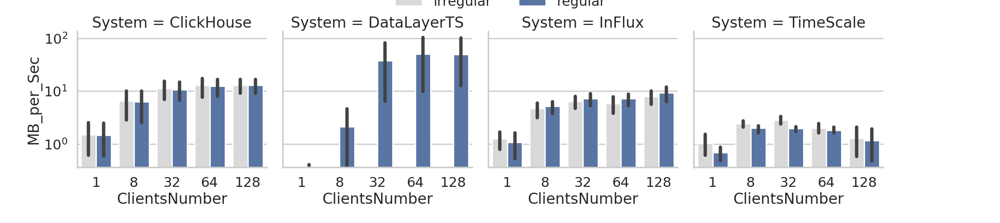

same, but with 24 values per data point


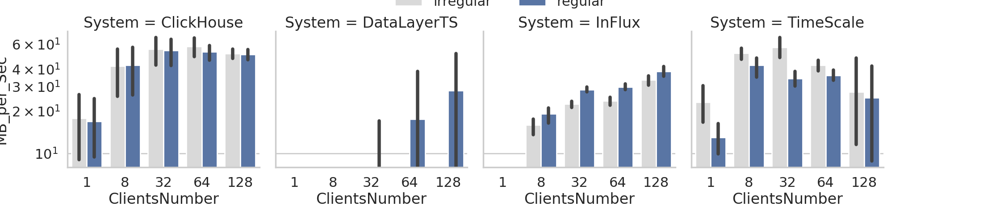

Following reflect the latencies including times spent by Client API


In [26]:
# ClientsNumber

print("for regular and irregular data,  ClientsNumber and  Bachsize per Database.  For one value per datapoint workloads ")

plt.gca()
plt.axis([None, None, 0, regularity_ingestion_1V_results.MB_per_Sec.max()])
sns.set_theme("poster", style="whitegrid")

regCN = sns.catplot(data=regularity_ingestion_results.loc[regularity_ingestion_results["Amount_of_Values"].isin([1])], kind='bar', x="ClientsNumber", y="MB_per_Sec", hue="Regularity",  # row="Amount_of_Values",
                    col="System",   palette={"regular": "b", "irregular": ".85"},
                    legend_out=True, legend="brief"
                    )
plt.yscale('log')
sns.move_legend(regCN, loc='upper center', bbox_to_anchor=(
    0.5, 1.075), ncol=9, title=None, frameon=False,)
plt.savefig(path+'regularityCN-bar-003.svg', format='svg', bbox_inches="tight")
plt.show()
plt.close()

print("same, but with 24 values per data point")

regularityCN_bar_24D = sns.catplot(data=regularity_ingestion_results.loc[regularity_ingestion_results["Amount_of_Values"].isin([24])], kind='bar', x="ClientsNumber", y="MB_per_Sec", hue="Regularity",  # row="Amount_of_Values",
                                   col="System",   palette={"regular": "b", "irregular": ".85"})
plt.yscale('log')
sns.move_legend(regularityCN_bar_24D, loc='upper center', bbox_to_anchor=(
    0.5, 1.075), ncol=9, title=None, frameon=False,)
plt.savefig(path+'regularityCN-bar-24D-004.svg',
            format='svg', bbox_inches="tight")
plt.show()
plt.close()

print("Following reflect the latencies including times spent by Client API")
# # agg_regularityCN
# show_and_print(pd.DataFrame(data=regularity_ingestion_1V_results.groupby(
#     ['System', 'Mode', 'ClientsNumber'], as_index=False).agg({"MB_per_Sec": 'mean'})), 'reg_CN', './graphs/')

# print("Considering CLientLatency")

# sns.catplot(data=regularity_ingestion_1V_results, kind='bar', x="ClientsNumber", y="MB_per_Sec_with_Client",  hue="Regularity",
#             col="System", col_wrap=4, palette={"regular": "b", "irregular": ".85"})
# plt.yscale('log')
# plt.savefig(path+'regularityCN_Client-005.svg', format='svg', bbox_inches="tight")
# plt.show()
# plt.close()

# show_and_print(pd.DataFrame(data=regularity_ingestion_1V_results.groupby(
#     ['System', 'Mode', 'ClientsNumber'], as_index=False).agg({"MB_per_Sec_with_Client": 'mean'})), 'reg_CN_Client', './graphs/')

Comparison: Regular vs Irregular Data Transmission based on Size of Batches


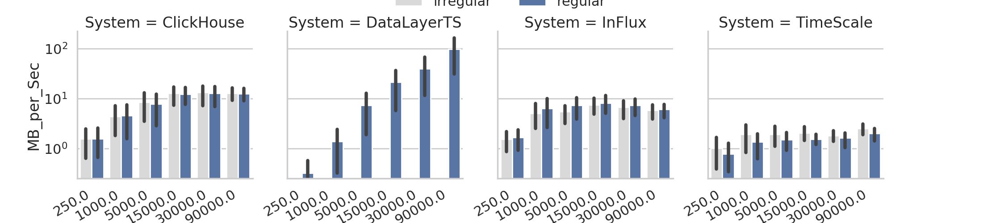

In [ ]:
#  Batchsize
# plt.figure("BS")
print("Comparison: Regular vs Irregular Data Transmission based on Size of Batches")
regBS = sns.catplot(data=regularity_ingestion_1V_results, kind='bar', x="BatchSize", y="MB_per_Sec", hue="Regularity",
                    col="System",   palette={"regular": "b", "irregular": ".85"})
plt.yscale('log')
sns.move_legend(regBS, loc='upper center', bbox_to_anchor=(
    0.5, 1.075), ncol=9, title=None, frameon=False,)
plt.gcf().autofmt_xdate()
plt.savefig(path+'!regularityBS-bar-006.svg',
            format='svg', bbox_inches="tight")
plt.show()
plt.close()


# # agg_regularityBS
# show_and_print(pd.DataFrame(data=regularity_ingestion_1V_results.groupby(
#     ['System', 'Mode', 'BatchSize'], as_index=False).agg({"MB_per_Sec": 'mean'})), 'reg_BS', './graphs/')


# print("Considering CLientLatency")


# sns.catplot(data=regularity_ingestion_1V_results, kind='bar', x="BatchSize", y="MB_per_Sec_with_Client", hue="Mode",
#             col="System", col_wrap=4, palette={"dedicated_regular": "b", "dedicated_irregular": ".85"})
# plt.yscale('log')
# plt.gcf().autofmt_xdate()
# plt.savefig(path+'regularityBS_Client-007.svg', format='svg', bbox_inches="tight")
# plt.show()
# plt.close()


# # agg_regularityBS
# show_and_print(pd.DataFrame(data=regularity_ingestion_1V_results.groupby(
#     ['System', 'Mode', 'BatchSize'], as_index=False).agg({"MB_per_Sec_with_Client": 'mean'})), 'reg_BS_Client', './graphs/')

In [18]:
print(" . ")
# # BS-CN


# sns.catplot(data=regularity_ingestion_results.assign(BS_CN=lambda x: x.BatchSize + 0.001 * x.ClientsNumber
#                                                                                                                                                 ), kind='boxen', x="BS_CN", y="MB_per_Sec", hue="Mode",
#             col="System", col_wrap=2, palette={"dedicated_regular": "b", "dedicated_irregular": ".85"})
# plt.gcf().autofmt_xdate()
# plt.yscale('log')
# plt.savefig(path+'!regularityBS-CN-boxen-008.svg',
#             format='svg', bbox_inches="tight")
# # plt.legend(loc='lower center', bbox_to_anchor=(0.5, 1.00), shadow=True, ncol=2)
# plt.show()
# plt.close()


# sns.catplot(data=regularity_ingestion_results.assign(BS_CN=lambda x: x.BatchSize + 0.001 * x.ClientsNumber
#                                                                                                                                                 ) , kind='boxen', x="BS_CN", y="MB_per_Sec_with_Client", hue="Mode",
#             col="System", col_wrap=2, palette={"dedicated_regular": "b", "dedicated_irregular": ".85"})
# plt.gcf().autofmt_xdate()
# plt.yscale('log')
# plt.savefig(path+'!regularityBS-CN-boxen-009.svg',
#             format='svg', bbox_inches="tight")
# # plt.legend(loc='lower center', bbox_to_anchor=(0.5, 1.00), shadow=True, ncol=2)
# plt.show()
# plt.close()


# # agg_regularityBS
# show_and_print(pd.DataFrame(data=regularity_ingestion_results.groupby(
#     ['System', 'Mode', 'BatchSize', 'ClientsNumber'], as_index=False).agg({"MB_per_Sec": 'mean',"MB_per_Sec_with_Client": 'mean'})), 'reg_BS_CN', './graphs/')

 . 


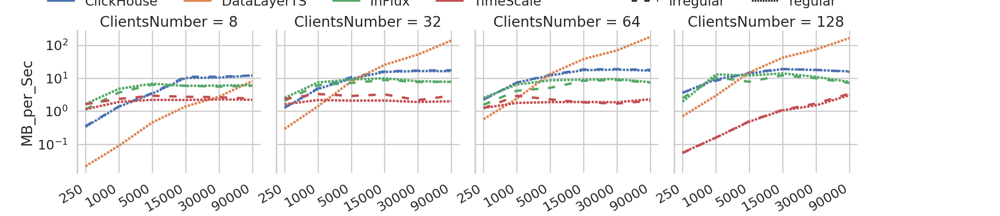

In [20]:
# 2 bs cn lineplots
import seaborn.objects as so
plt.close()
plt.close()
sns.set_theme(style="whitegrid")
sns.set_context("poster")
reg_BS_CN_Ing_1V = sns.relplot(data=regularity_ingestion_1V_results.loc[regularity_ingestion_1V_results.ClientsNumber.isin([8, 32, 64, 128])].replace({"BatchSize": {250: 1, 1000: 2, 5000: 3, 15000: 4, 30000: 5, 90000: 6}}),  x="BatchSize", y="MB_per_Sec", hue="System", style="Regularity",  linestyle='dashdot', kind="line", col="ClientsNumber", errorbar=("ci", 0.0001), dashes=[(3, 4), (1, 0.5)], linewidth=4,
                               )

reg_BS_CN_Ing_1V._legend.texts[0].set_text("")   # removes legend title"syste,""
reg_BS_CN_Ing_1V._legend.texts[5].set_text("")   # &"regularity"
sns.move_legend(reg_BS_CN_Ing_1V, loc='upper center', bbox_to_anchor=(
    0.41, 1.075), ncol=9, title=None, frameon=False,)
plt.xticks([1, 2, 3, 4, 5, 6], [250, 1000, 5000, 15000, 30000, 90000])
plt.yscale('log')
sns.despine(top=True, bottom=True)
plt.gcf().autofmt_xdate()
plt.savefig(path+'!!regularityBS-CN-line-010.svg',
            format='svg', bbox_inches="tight")

plt.show()
plt.close()

In [23]:

# print("1+24 Vals per Data point matrix ")
# plt.close()
# plt.close()
# sns.set_theme(style="whitegrid")
# sns.set_context("poster")
# sns.relplot(data=regularity_ingestion_results.loc[regularity_ingestion_results["Amount_of_Values"].isin([1, 24])].loc[regularity_ingestion_results.ClientsNumber.isin([8, 32, 64, 128])].replace({"BatchSize": {250: 1, 1000: 2, 5000: 3, 15000: 4, 30000: 5, 90000: 6}}),  x="BatchSize", y="MB_per_Sec", hue="System", style="Regularity",  linestyle='dashdot', kind="line", col="ClientsNumber", errorbar=("ci", 0.0001), dashes=[(3, 4), (1, 0.5)], linewidth=4, row="Amount_of_Values"
#             )

# plt.xticks([1, 2, 3, 4, 5, 6], [250, 1000, 5000, 15000, 30000, 90000])
# plt.yscale('linear')
# sns.despine()
# plt.gcf().autofmt_xdate()
# plt.legend(loc='lower center', bbox_to_anchor=(0.5, 1.00), shadow=True, ncol=2)
# plt.savefig(path+'!!regularityBS-CN-line-1+24D-011.svg',
#             format='svg', bbox_inches="tight")

# plt.show()
# plt.close()


# # # clientlatancy
# # sns.relplot(data=regularity_ingestion_results.loc[regularity_ingestion_results.ClientsNumber.isin([1,8, 32, 64,128])].replace({"BatchSize": {250: 1, 1000: 2, 5000: 3, 15000: 4, 30000:5 , 90000:6}}),  x="BatchSize", y="MB_per_Sec_with_Client", hue="System", style="Regularity",  linestyle='dashdot', kind="line", col="ClientsNumber", errorbar=("ci", 0.0001), dashes=[(3, 4), (1, 0.5)], linewidth=4,col_wrap=3
# #             )

# # plt.xticks([1, 2, 3, 4,5,6], [250,1000, 5000, 15000, 30000, 90000])
# # plt.yscale('linear')
# # plt.gcf().autofmt_xdate()
# # plt.legend(loc='lower center', bbox_to_anchor=(0.5, 1.00), shadow=True, ncol=2)
# # plt.savefig(path+'!!regularityBS-1+48CN-line-012.svg',
# #             format='svg', bbox_inches="tight")

# # plt.show()
# # plt.close()

## lenght

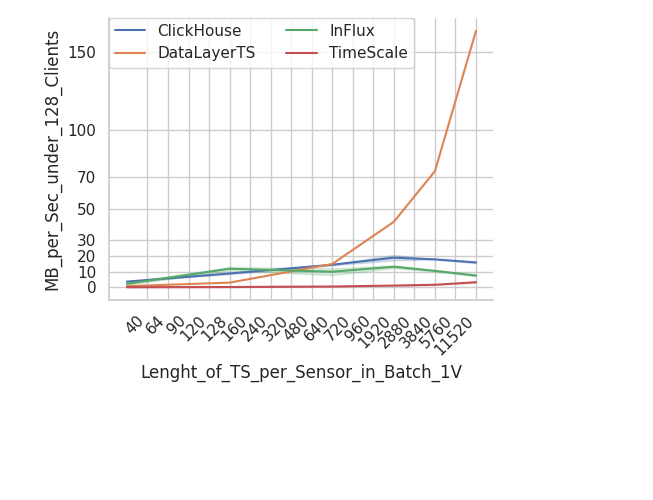

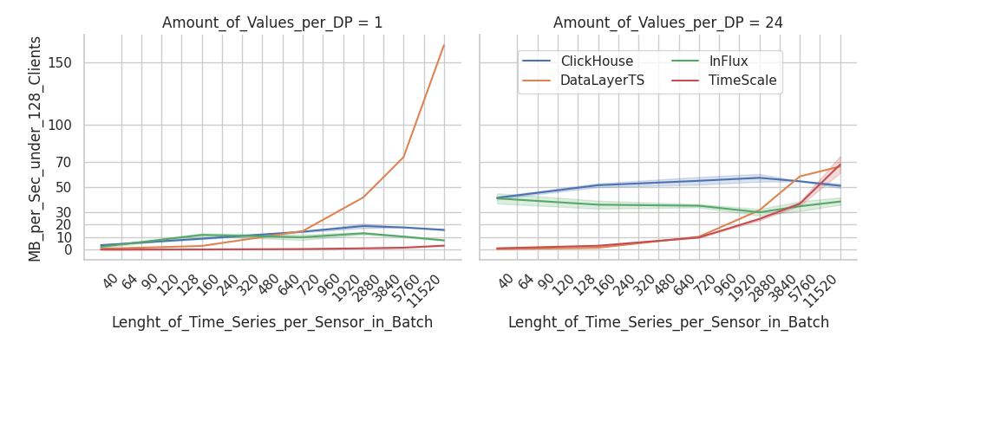

In [23]:


import seaborn.objects as so
plt.close()
plt.close()
sns.set_theme(style="whitegrid")
# plt.style.use('seaborn')
sns.set_context('notebook')
Lenght_128C  = sns.relplot(data=regularity_ingestion_1V_results.loc[regularity_ingestion_results["ClientsNumber"].isin([128])].rename(columns={"MB_per_Sec" : "MB_per_Sec_under_128_Clients"}).assign(Lenght_of_TS_per_Sensor_in_Batch_1V=lambda x: x.BatchSize / (1000 / x.ClientsNumber)).replace({"Lenght_of_TS_per_Sensor_in_Batch_1V": {0.25: 0, 1: 1, 2: 2, 5: 3, 8: 4, 15: 5, 16: 6, 30: 7, 32: 8, 40: 9, 64: 10, 90: 11, 120: 12, 128: 13, 160: 14, 240: 15, 320: 16, 480: 17, 640: 18, 720: 19, 960: 20, 1920: 21, 2880: 22, 3840: 23, 5760: 24, 11520: 25}}), kind="line",
                                        x="Lenght_of_TS_per_Sensor_in_Batch_1V", y="MB_per_Sec_under_128_Clients", hue="System",
                                        )
plt.xscale('linear')
plt.xticks([9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 19, 20, 21, 22, 23, 24, 25], [
           40, 64, 90, 120, 128, 160, 240, 320, 480, 640, 720, 960, 1920, 2880, 3840, 5760, 11520])
plt.yscale('linear')
sns.despine(top=True)
plt.yticks([0, 10, 20, 30, 50, 70, 100, 150])
plt.gcf().autofmt_xdate(bottom=0.4, rotation=45)
sns.move_legend(Lenght_128C, loc='upper center', bbox_to_anchor=(
    0.4, 0.98), ncol=2, title=None, frameon=True,)
plt.savefig(path+'!!vectorlenght-linesmooth-015.svg',
            format='svg', bbox_inches="tight")

plt.show()
plt.close()


plt.close()
sns.set_theme(style="whitegrid")
# plt.style.use('seaborn')
sns.set_context('notebook')
Lenght_128C_1_24V = sns.relplot(data=regularity_ingestion_results.loc[regularity_ingestion_results["ClientsNumber"].isin([128])].rename(columns={"MB_per_Sec": "MB_per_Sec_under_128_Clients"}).loc[regularity_ingestion_results["Amount_of_Values"].isin([1, 24])].assign(Lenght_of_Time_Series_per_Sensor_in_Batch=lambda x: x.BatchSize / (1000 / x.ClientsNumber)).replace({"Lenght_of_Time_Series_per_Sensor_in_Batch": {0.25: 0, 1: 1, 2: 2, 5: 3, 8: 4, 15: 5, 16: 6, 30: 7, 32: 8, 40: 9, 64: 10, 90: 11, 120: 12, 128: 13, 160: 14, 240: 15, 320: 16, 480: 17, 640: 18, 720: 19, 960: 20, 1920: 21, 2880: 22, 3840: 23, 5760: 24, 11520: 25}}).rename(columns={"Amount_of_Values": "Amount_of_Values_per_DP"}), kind="line",
                                  x="Lenght_of_Time_Series_per_Sensor_in_Batch", y="MB_per_Sec_under_128_Clients", hue="System",  col="Amount_of_Values_per_DP"
                                                    )
plt.xscale('linear')
plt.xticks([9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 19, 20, 21, 22, 23, 24, 25], [
           40, 64, 90, 120, 128, 160, 240, 320, 480, 640, 720, 960, 1920, 2880, 3840, 5760, 11520])
plt.yscale('linear')
plt.yticks([0, 10, 20, 30, 50, 70, 100, 150])
plt.gcf().autofmt_xdate(bottom=0.4, rotation=45)
sns.move_legend(Lenght_128C_1_24V, loc='upper center', bbox_to_anchor=(
    0.65, 0.9), ncol=2, title=None, frameon=True,)
plt.savefig(path+'!!vectorlenght-linesmooth_AoV1-24-015,01.svg',
            format='svg', bbox_inches="tight")

plt.show()
plt.close()

In [24]:
# # Vectorlenght to Throughput

# # import seaborn.objects as so
# # plt.close()
# # plt.close()
# # sns.set_theme(style="whitegrid")
# # # plt.style.use('seaborn')
# # sns.set_context("paper")
# # sns.barplot(data=regularity_ingestion_results.assign(Vectorlenght= lambda x: x.BatchSize / (1000 / x.ClientsNumber) )
# #             ,  x="Vectorlenght", y="MB_per_Sec", hue="System",
# #             )

# # plt.yscale('linear')
# # plt.gcf().autofmt_xdate()
# # plt.legend(loc='lower center', bbox_to_anchor=(0.5, 1.00), shadow=True, ncol=2)
# # plt.savefig(path+'vectorlenght-bar-013.svg',
# #             format='svg', bbox_inches="tight")

# # plt.show()
# # plt.close()


# # import seaborn.objects as so
# # plt.close()
# # plt.close()
# # sns.set_theme(style="whitegrid")
# # # plt.style.use('seaborn')
# # sns.set_context("paper")
# # sns.lineplot(data=regularity_ingestion_results.assign(Vectorlenght= lambda x: x.BatchSize / (1000 / x.ClientsNumber) )
# #             ,  x="Vectorlenght", y="MB_per_Sec", hue="System",
# #             )
# # plt.xscale('log')
# # plt.xticks([0.25,1,2,5,8,15,16,30,32,40,64,90,120,128,160,240,320,480,640,720,960,1920,2880,3840,5760,11520],[0.25,1,2,5,8,15,16,30,32,40,64,90,120,128,160,240,320,480,640,720,960,1920,2880,3840,5760,11520])
# # plt.yscale('linear')
# # plt.gcf().autofmt_xdate()
# # plt.legend(loc='lower center', bbox_to_anchor=(0.5, 1.00), shadow=True, ncol=2)
# # plt.savefig(path+'vectorlenght-lineraw-014.svg',
# #             format='svg', bbox_inches="tight")

# # plt.show()
# # plt.close()


# sns.set_theme(style="whitegrid")
# # plt.style.use('seaborn')
# sns.set_context('notebook')
# sns.relplot(data=regularity_ingestion_1V_results.loc[regularity_ingestion_results["ClientsNumber"].isin([128])].assign(Lenght_of_Time_Series_per_Sensor_in_Batch_under_128_Clients=lambda x: x.BatchSize / (1000 / x.ClientsNumber)).replace({"Lenght_of_Time_Series_per_Sensor_in_Batch_under_128_Clients": {0.25: 0, 1: 1, 2: 2, 5: 3, 8: 4, 15: 5, 16: 6, 30: 7, 32: 8, 40: 9, 64: 10, 90: 11, 120: 12, 128: 13, 160: 14, 240: 15, 320: 16, 480: 17, 640: 18, 720: 19, 960: 20, 1920: 21, 2880: 22, 3840: 23, 5760: 24, 11520: 25}}), kind="line",
#             x="Lenght_of_Time_Series_per_Sensor_in_Batch_under_128_Clients", y="MB_per_Sec", hue="System", style="Regularity",
#             )
# plt.xscale('linear')
# plt.xticks([9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 19, 20, 21, 22, 23, 24, 25], [
#            40, 64, 90, 120, 128, 160, 240, 320, 480, 640, 720, 960, 1920, 2880, 3840, 5760, 11520])
# plt.yscale('log')
# plt.gcf().autofmt_xdate(bottom=0.4, rotation=45)
# plt.legend(loc='lower center', bbox_to_anchor=(0.5, 1.00), shadow=True, ncol=2)
# plt.savefig(path+'!vectorlenght-linesmooth-015,1.svg',
#             format='svg', bbox_inches="tight")

# plt.show()
# plt.close()


# print("24D")

# plt.close()
# plt.close()
# sns.set_theme(style="whitegrid")
# # plt.style.use('seaborn')
# sns.set_context('paper')
# sns.relplot(data=regularity_ingestion_results.loc[regularity_ingestion_results["Amount_of_Values"].isin([1, 24])].assign(Lenght_of_Time_Series_per_Sensor_in_Batch=lambda x: x.BatchSize / (1000 / x.ClientsNumber)).replace({"Lenght_of_Time_Series_per_Sensor_in_Batch": {0.25: 0, 1: 1, 2: 2, 5: 3, 8: 4, 15: 5, 16: 6, 30: 7, 32: 8, 40: 9, 64: 10, 90: 11, 120: 12, 128: 13, 160: 14, 240: 15, 320: 16, 480: 17, 640: 18, 720: 19, 960: 20, 1920: 21, 2880: 22, 3840: 23, 5760: 24, 11520: 25}}), kind="line",
#             x="Lenght_of_Time_Series_per_Sensor_in_Batch", y="MB_per_Sec", hue="System", row="ClientsNumber", col="Amount_of_Values"
#             )
# plt.xscale('linear')
# plt.xticks([0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 19, 20, 21, 22, 23, 24, 25], [
#            0.25, 1, 2, 5, 8, 15, 16, 30, 32, 40, 64, 90, 120, 128, 160, 240, 320, 480, 640, 720, 960, 1920, 2880, 3840, 5760, 11520])
# plt.yscale('linear')

# plt.gcf().autofmt_xdate(bottom=0.4, rotation=45)
# plt.legend(loc='lower center', bbox_to_anchor=(0.5, 1.00), shadow=True, ncol=2)
# plt.savefig(path+'!vectorlenght-linesmooth-matrix-016.svg',
#             format='svg', bbox_inches="tight")

# plt.show()
# plt.close()

## top ing and query comp


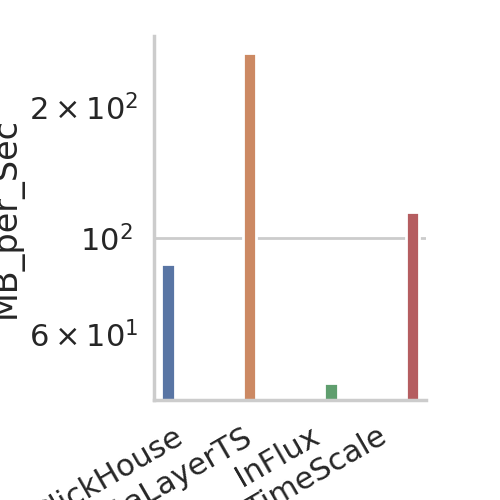

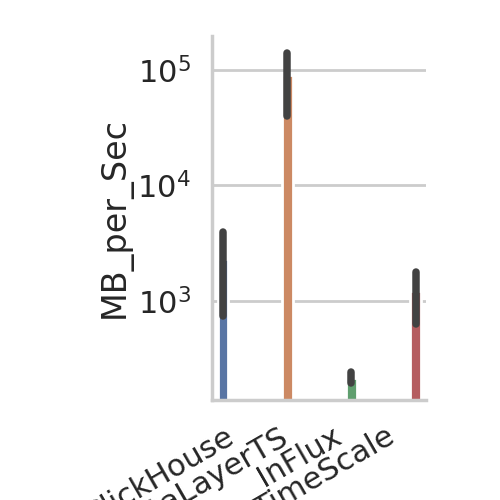

In [26]:

top_rates_temp = results_rates.loc[results_rates.Mode.str.contains("ded") & ((results_rates.Operation.str.contains(
    
    "RangeQueryRaw") | results_rates.Operation.str.contains("Ing")))].groupby(['System',  'Operation'], as_index=False)['MB_per_Sec'].max()
sns.set_context("poster")
sns.catplot(data=top_rates_temp.loc[top_rates_temp.Operation.str.contains("Ing")], kind='bar', x="System",
            y="MB_per_Sec",              hue="System"
            )
plt.yscale('log')
plt.gcf().autofmt_xdate()
plt.savefig(path+'Top-Q_IO-bar-016,1.svg',
            format='svg', bbox_inches="tight")
plt.show()
plt.close()


sns.catplot(data=top_rates_temp.loc[top_rates_temp.Operation.str.contains("RangeQueryRaw")], kind='bar', x="System",
            y="MB_per_Sec",            hue="System"
            )
plt.yscale('log')
plt.gcf().autofmt_xdate()
plt.savefig(path+'Top-I_IO-bar-016,2.svg',
            format='svg', bbox_inches="tight")
plt.show()
plt.close()

## Consecutive Ingestion vs Patchwork Ingestion
### ( all parralel Clients send 1 min. batches containing all sensor data and timestamps of all batches are seemlessly attached to another - vs - Clients Send Batches where sensorsdata is distributed across clients and each bach starts the series in another point in time. )



# TODO fitler out old DLTS patchWork records (maybe at that thime they have not been called patchwork) and insert them

TOP RATES and their resp. CLientsNumbers and Batchsizes


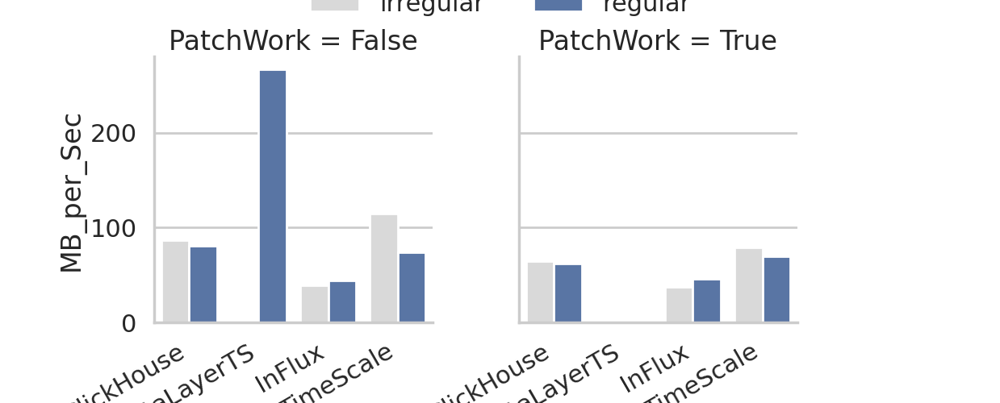

In [27]:
#  TOP Values

print("TOP RATES and their resp. CLientsNumbers and Batchsizes")
show_and_print(pd.DataFrame(data=top_rates_Ded_Ing), 'reg_TOP', './graphs/')
sns.set_context("poster")
# plt.figure("TOP")
# plt.title("Comparison: Regular vs Irregular Data Transmission based on TOP Ingestion Rates across BS,CN,Dim parameters.")
pw=sns.catplot(data=top_rates_Ded_Ing.replace({"Regularity": {True: 'regular', False: "irregular"}}), kind='bar', x="System",
            y="MB_per_Sec", col="PatchWork",
            hue="Regularity", palette={"regular": "b", "irregular": ".85"}
            )
plt.yscale('linear')
plt.gcf().autofmt_xdate()
sns.move_legend(pw, loc='upper center' ,ncol=3,bbox_to_anchor=(0.5, 1.17))
# pw._legend.texts[0].set_text("") 
plt.savefig(path+'regularityTOP_withCons-bar-017.svg',
            format='svg', bbox_inches="tight")
plt.show()
plt.close()


# print("Considering CLientLatency")


# # plt.figure("TOP")
# # plt.title("Comparison: Regular vs Irregular Data Transmission based on TOP Ingestion Rates across BS,CN,Dim parameters.")
# sns.catplot(data=  [top_rates_Client['Mode'].str.contains('dedicated_')], kind='bar', x="System",
#             y="MB_per_Sec_with_Client", hue="Mode", palette={"dedicated_regular": "b", "dedicated_irregular": ".85"})
# plt.yscale('linear')
# plt.savefig(path+'regularityTOP_Client-018.svg', format='svg', bbox_inches="tight")
# plt.show()
# plt.close()9


# show_and_print(pd.DataFrame(data=top_rates_Client[top_rates_Client['Mode'].str.contains(
#     'dedicated_')]), 'reg_TOP_Cl', './graphs/')

### Multi Dim


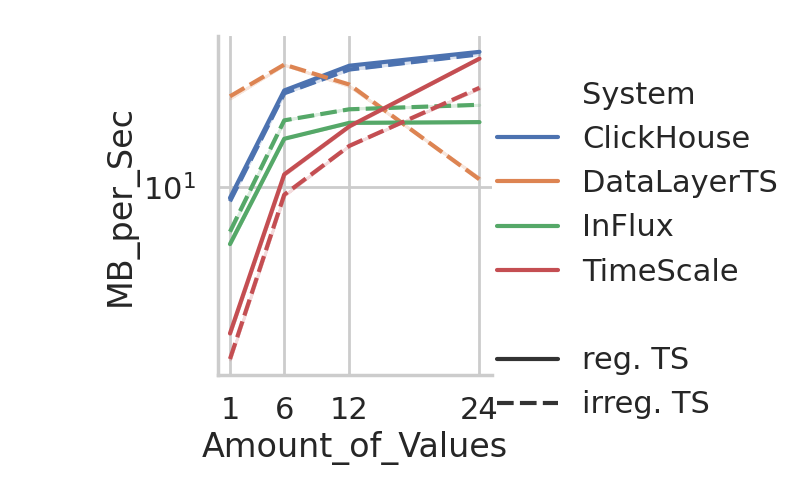

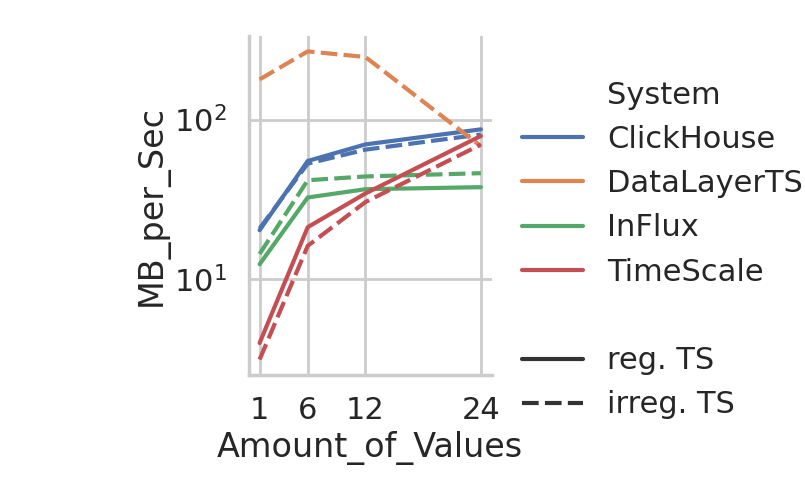

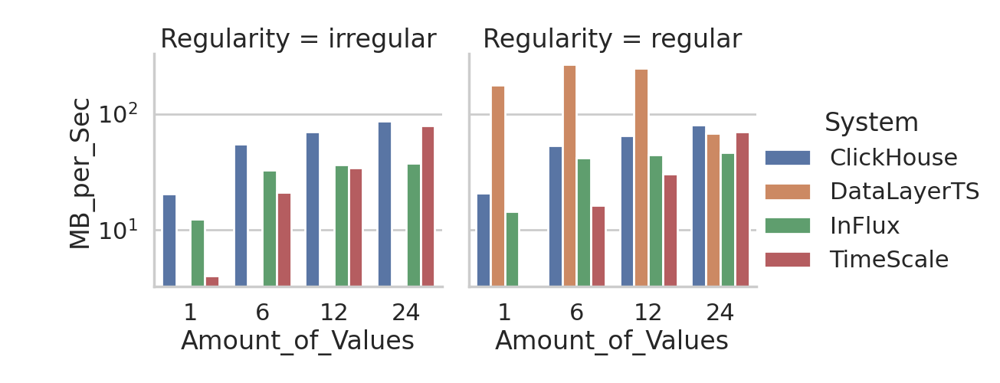

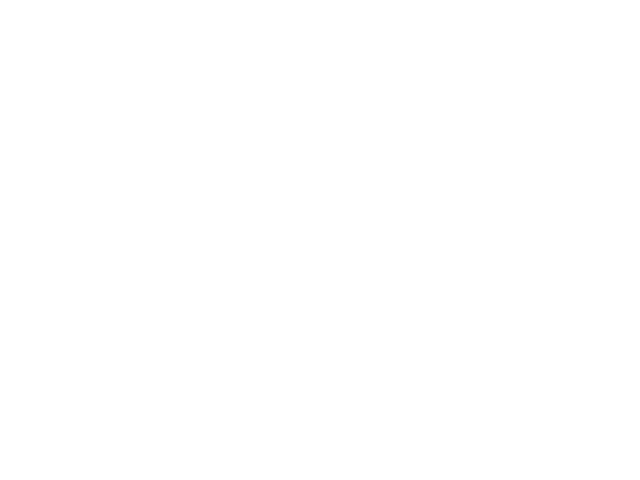

In [28]:
sns.set_theme(style="whitegrid")
# plt.style.use('seaborn')
sns.set_context("poster")

multidimIng_TOP_all = regularity_ingestion_results.loc[regularity_ingestion_results.Mode.str.contains("ded")].groupby(['System', 'Amount_of_Values', 'Regularity'], as_index=False)[
    'MB_per_Sec'].max()

# TODO lineplot with variance  , 99% quantil . 1 % quantil or min and max ,, like a mix between barplot and lineplots

plt.figure("multidim-bar")
dim   = sns.relplot(data=results_ratesI.loc[results_ratesI.Mode.str.contains("ded")], kind="line", x="Amount_of_Values",
                        y="MB_per_Sec",   hue="System", style="Regularity", errorbar= ("ci", .0001))
plt.yscale('log')
plt.xticks([1, 6, 12, 24])
dim._legend.texts[5].set_text("")   # &"regularity"
dim._legend.texts[6].set_text("reg. TS")
dim._legend.texts[7].set_text("irreg. TS")
sns.move_legend(dim, loc='center right', ncol=1, title=None, frameon=False,)
plt.savefig(path+'!multidim-avg-Ing-line-019.svg',
            format='svg', bbox_inches="tight")
plt.show()
plt.close()


plt.figure("multidim-line")
dim   = sns.relplot(data=multidimIng_TOP_all, kind="line", x="Amount_of_Values",
                        y="MB_per_Sec",   hue="System", style="Regularity", errorbar= ("ci", .0001))
plt.yscale('log')
plt.xticks([1, 6, 12, 24])
dim._legend.texts[5].set_text("")   # &"regularity"
dim._legend.texts[6].set_text("reg. TS")
dim._legend.texts[7].set_text("irreg. TS")
sns.move_legend(dim, loc='center right', ncol=1,bbox_to_anchor=(1.031, 0.5), title=None, frameon=False,)
plt.savefig(path+'!multidim-top-Ing-line-019,1.svg',
            format='svg', bbox_inches="tight")
plt.show()
plt.close()

plt.figure("multidimTOP-box")
sns.catplot(data=multidimIng_TOP_all, kind="bar", x="Amount_of_Values",
            y="MB_per_Sec",   hue="System", col="Regularity", errorbar=("ci",  0.0001))
plt.yscale('log')
plt.savefig(path+'!multidim-avg-TOP-Ing-bar-020.svg',
            format='svg', bbox_inches="tight")
plt.show()
plt.close()
plt.close()
plt.close()
plt.figure("multidimTOP-box-limear")
sns.relplot(data=multidimIng_TOP_all, kind="line", x="Amount_of_Values",
            y="MB_per_Sec",   hue="System", col="Regularity", errorbar=("ci",  0.0001))
plt.yscale('linear')
plt.xticks([1, 6, 12, 24])
plt.savefig(path+'!multidim-avg-TOP-Ing-line-020,1.svg',
            format='svg', bbox_inches="tight")
plt.close()
plt.close()
# plt.figure("multidim-box-Client")
# sns.catplot(data=multidimIng_TOP_all, kind="bar", x="Amount_of_Values",
#             y="MB_per_Sec_with_Client",   hue="System")
# plt.yscale('log')
# plt.title("TOP (Optimal Ingestion Config.) Data Transmission Speed For Ingestion WorDatalayerkloads On Both Reg. + Irreg. Data For various Data Amount_of_Values")
# plt.savefig(path+'multidim-I-BP_Client-021.svg', format='svg', bbox_inches="tight")
# plt.show()
# plt.close()

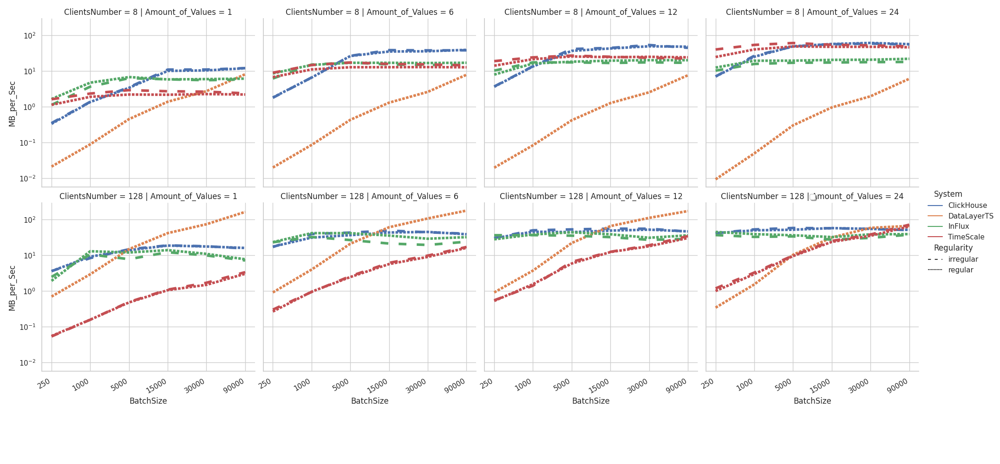

In [30]:
import seaborn.objects as so
plt.close()
plt.close()
sns.set_theme(style="whitegrid")
# plt.style.use('seaborn')
sns.set_context("notebook")
sns.relplot(data=regularity_ingestion_results.loc[regularity_ingestion_results.ClientsNumber.isin([8, 128])].loc[regularity_ingestion_results.Amount_of_Values.isin([1, 6, 12, 24])].replace({"BatchSize": {250: 1, 1000: 2, 5000: 3, 15000: 4, 30000: 5, 90000: 6}}),  x="BatchSize", y="MB_per_Sec", hue="System", style="Regularity",  linestyle='dashdot', kind="line", col="Amount_of_Values", errorbar=("ci", 0.0001), dashes=[(3, 4), (1, 0.5)], linewidth=4, row="ClientsNumber"
            )

plt.xticks([1, 2, 3, 4, 5, 6], [250, 1000, 5000, 15000, 30000, 90000])
plt.yscale('log')
plt.gcf().autofmt_xdate()
plt.legend(loc='lower center', bbox_to_anchor=(0.5, 1.00), shadow=True, ncol=2)
plt.savefig(path+'!!multidim-CN-line-022.svg',
            format='svg', bbox_inches="tight")

plt.show()
plt.close()

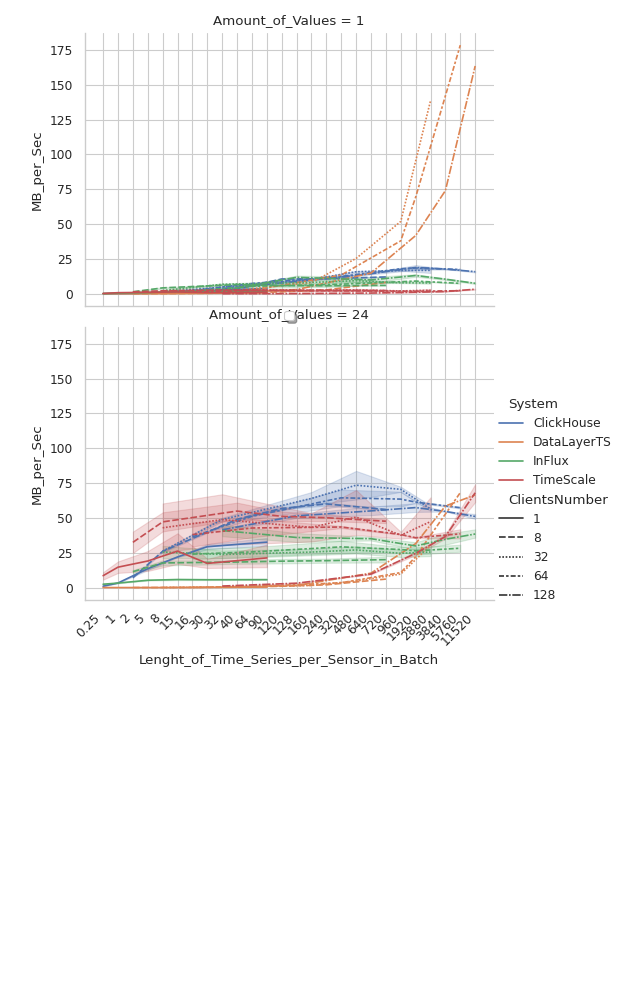

In [37]:


import seaborn.objects as so
plt.close()
plt.close()
sns.set_theme(style="whitegrid")
# plt.style.use('seaborn')
sns.set_context('paper')
sns.relplot(data=regularity_ingestion_results.loc[regularity_ingestion_results.Amount_of_Values.isin([1, 24])].assign(Lenght_of_Time_Series_per_Sensor_in_Batch=lambda x: x.BatchSize / (1000 / x.ClientsNumber)).replace({"Lenght_of_Time_Series_per_Sensor_in_Batch": {0.25: 0, 1: 1, 2: 2, 5: 3, 8: 4, 15: 5, 16: 6, 30: 7, 32: 8, 40: 9, 64: 10, 90: 11, 120: 12, 128: 13, 160: 14, 240: 15, 320: 16, 480: 17, 640: 18, 720: 19, 960: 20, 1920: 21, 2880: 22, 3840: 23, 5760: 24, 11520: 25}}), kind="line", style="ClientsNumber",
            x="Lenght_of_Time_Series_per_Sensor_in_Batch", y="MB_per_Sec", hue="System",  row="Amount_of_Values"
            )
plt.xscale('linear')
plt.xticks([0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 19, 20, 21, 22, 23, 24, 25], [
           0.25, 1, 2, 5, 8, 15, 16, 30, 32, 40, 64, 90, 120, 128, 160, 240, 320, 480, 640, 720, 960, 1920, 2880, 3840, 5760, 11520])
plt.yscale('linear')
plt.gcf().autofmt_xdate(bottom=0.4, rotation=45)
plt.legend(loc='lower center', bbox_to_anchor=(0.5, 1.00), shadow=True, ncol=2)
plt.savefig(path+'!vectorlenght-linesmooth-DIM-023.svg',
            format='svg', bbox_inches="tight")

plt.show()
plt.close()

# System Metrics

##  Ing System Metrics


### regurlar vs irregular transaction system usage 


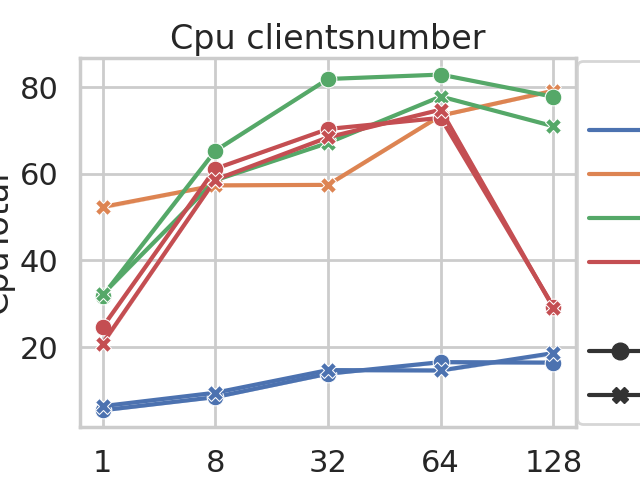

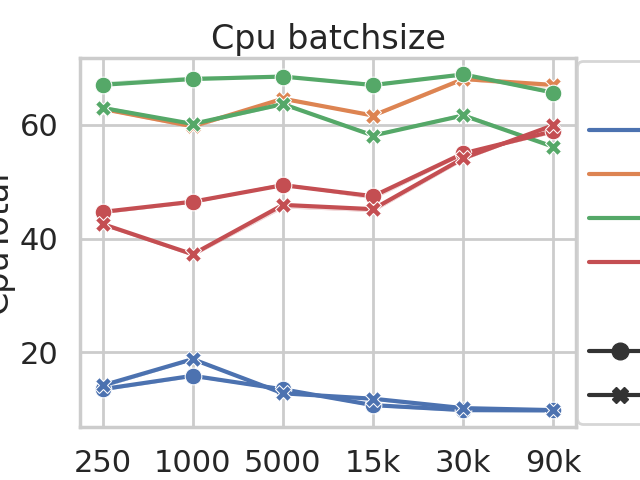

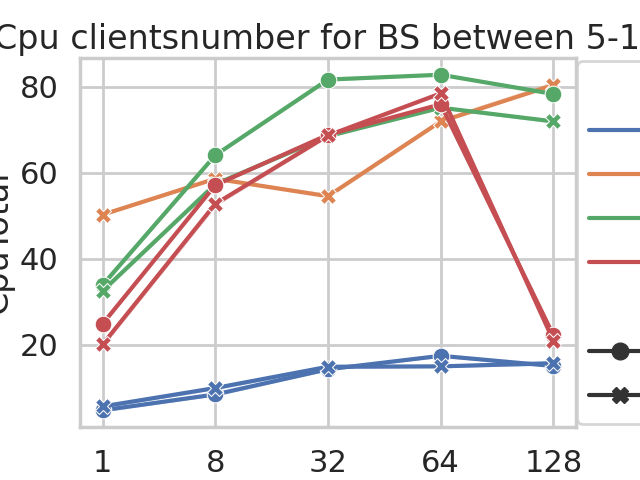

In [38]:


# USED
sns.set_context('poster')
plt.figure("Cpu-Cn")
plt.title("Cpu clientsnumber")

sns.lineplot(data=combinedRates.loc[combinedRates["Operation"].str.contains("Ing")].replace({"ClientsNumber": {1: 0, 8: 1, 32: 2, 64: 3, 128: 4}}), x="ClientsNumber", y="CpuTotal",
             hue="System", style="Regularity", markers=True, dashes=False, errorbar=("ci",  0.0001))
plt.legend(loc='center right', bbox_to_anchor=(1.65, 0.5))
plt.xticks([0, 1, 2, 3, 4], [1, 8, 32, 64, 128])
plt.savefig(path+'!!cpu-cn-024.svg', format='svg', bbox_inches="tight")
plt.show()
plt.close()
# USED

plt.figure("Cpu-Bs")
plt.title("Cpu batchsize")

sns.lineplot(data=combinedRates.loc[combinedRates["Operation"].str.contains("Ing")].replace({"BatchSize": {250: 0, 1000: 1, 5000: 2, 15000: 3, 30000: 4, 90000: 5}}), x="BatchSize", y="CpuTotal",
             hue="System", style="Regularity", markers=True, dashes=False, errorbar=("ci",  0.0001))
plt.legend(loc='center right', bbox_to_anchor=(1.65, 0.5))
plt.xticks([0, 1, 2, 3, 4, 5], [250, 1000, 5000, "15k", "30k", "90k"])
plt.savefig(path+'!!Cpu-Bs-025.svg', format='svg', bbox_inches="tight")
plt.show()
plt.close()


# USED
sns.set_context('poster')
plt.figure("Cpu-Cn")
plt.title("Cpu clientsnumber for BS between 5-15")

sns.lineplot(data=combinedRates.loc[combinedRates["Operation"].str.contains("Ing")&combinedRates.BatchSize.isin([5000,15000])].replace({"ClientsNumber": {1: 0, 8: 1, 32: 2, 64: 3, 128: 4}}), x="ClientsNumber", y="CpuTotal",
             hue="System", style="Regularity", markers=True, dashes=False, errorbar=("ci",  0.0001))
plt.legend(loc='center right', bbox_to_anchor=(1.65, 0.5))
plt.xticks([0, 1, 2, 3, 4], [1, 8, 32, 64, 128])
plt.savefig(path+'!BS5-15!cpu-cn-025,1.svg', format='svg', bbox_inches="tight")
plt.show()
plt.close()
# USED

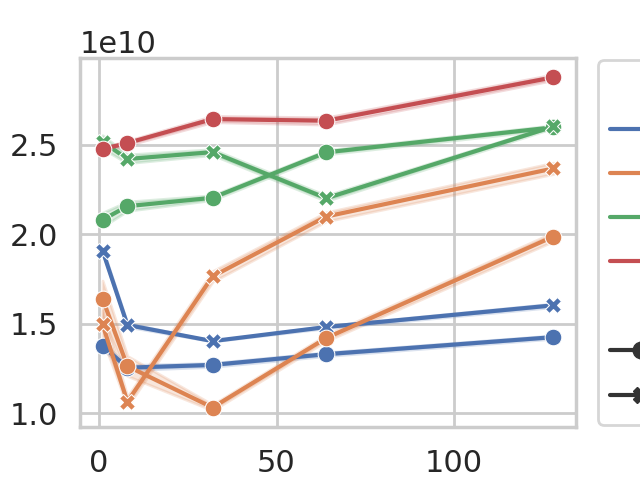

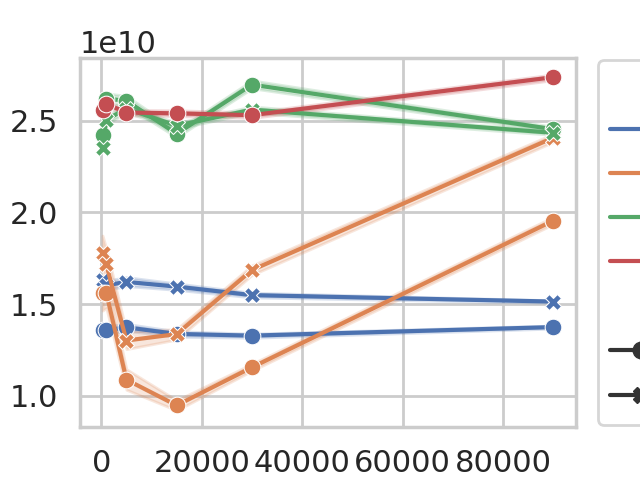

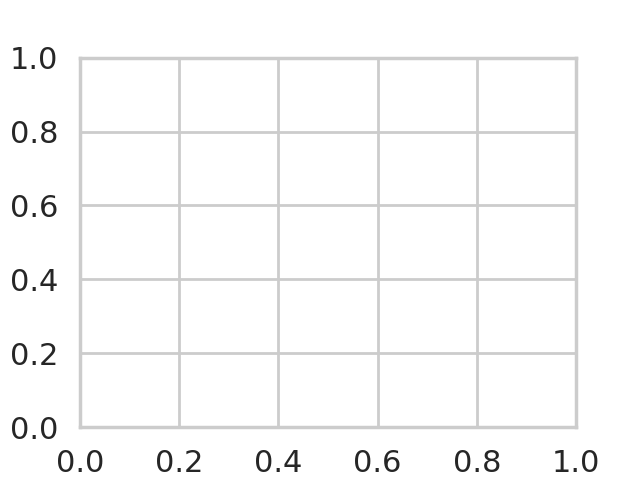

In [39]:
plt.close()
plt.close()

###


sns.lineplot(data=systemmetricsDED.loc[systemmetricsDED["Operation"].str.contains("Ing")], x="ClientsNumber", y="MemActive",
             hue="System", style="Mode", markers=True, dashes=False)
plt.legend(loc='center right', bbox_to_anchor=(1.895, 0.5))

plt.savefig(path+'!mem-cn-026.svg', format='svg', bbox_inches="tight")
plt.show()
plt.close()


sns.lineplot(data=systemmetricsDED.loc[systemmetricsDED["Operation"].str.contains("Ing")], x="BatchSize", y="MemActive",
             hue="System", style="Mode", markers=True, dashes=False)
plt.legend(loc='center right', bbox_to_anchor=(1.895, 0.5))

plt.savefig(path+'mem-Bs-027.svg', format='svg', bbox_inches="tight")
plt.show()
plt.close()



sns.lineplot(data=systemmetricsDED.loc[systemmetricsDED["Operation"].str.contains("Ing")&combinedRates.BatchSize.isin([5000,15000])], x="ClientsNumber", y="MemActive",
             hue="System", style="Mode", markers=True, dashes=False)
plt.legend(loc='center right', bbox_to_anchor=(1.895, 0.5))

plt.savefig(path+'!BS5+15-mem-cn-027,1.svg', format='svg', bbox_inches="tight")
plt.show()
plt.close()

 

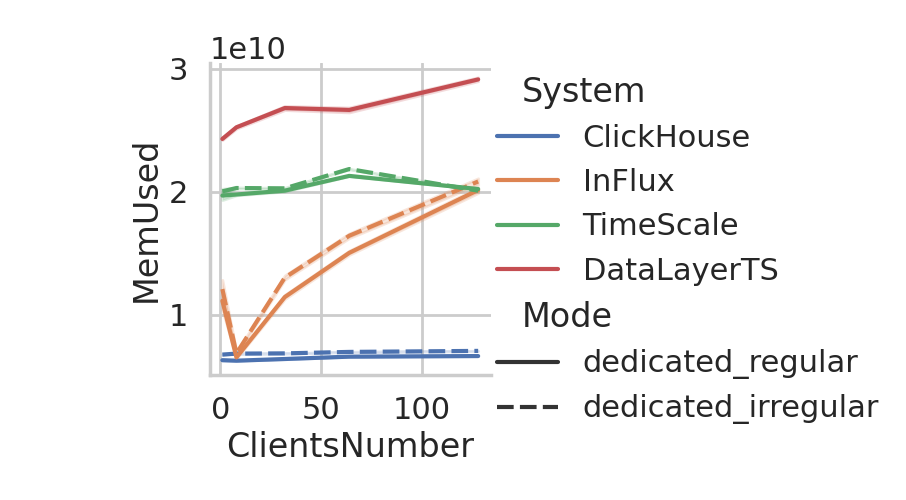

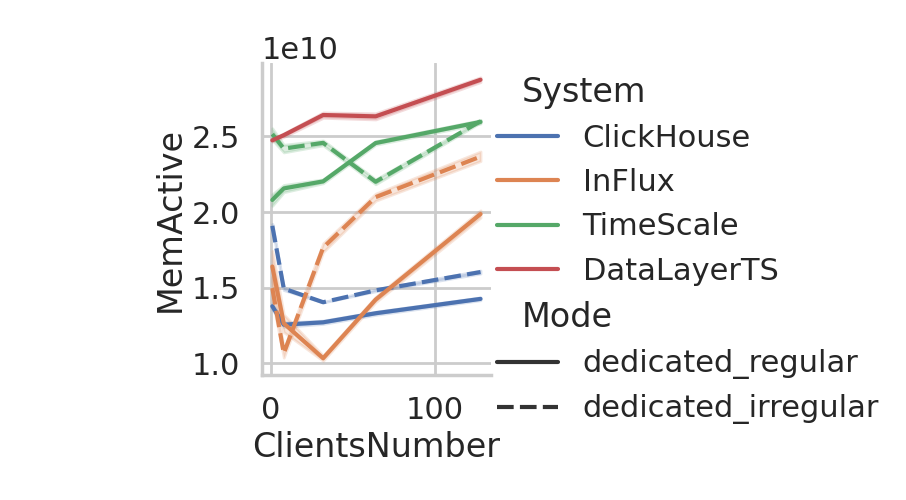

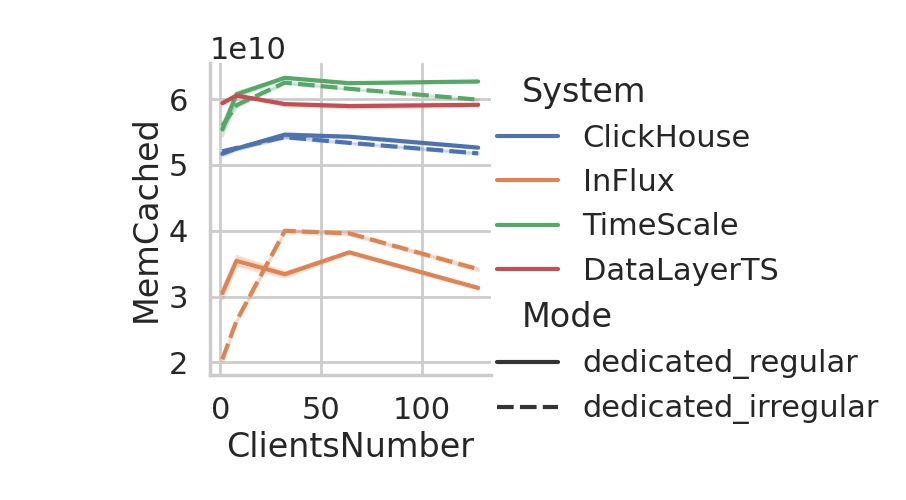

In [34]:


###

# plt.figure("used mem ")
# plt.title("mem used")

# USED
sns.relplot(data=systemmetricsDED.loc[systemmetricsDED["Operation"].str.contains("Ing")], kind="line", x="ClientsNumber",
            y="MemUsed", hue="System", style="Mode")
plt.savefig(path+'!mem-used-028.svg', format='svg', bbox_inches="tight")
plt.show()
plt.close()

# plt.figure("active mem ")
# plt.title("mem active")

sns.relplot(data=systemmetricsDED.loc[systemmetricsDED["Operation"].str.contains("Ing")], kind="line", x="ClientsNumber",
            y="MemActive", hue="System", style="Mode")
plt.savefig(path+'mem-active-029.svg', format='svg', bbox_inches="tight")
plt.show()
plt.close()

# plt.figure("cache mem ")
# plt.title("mem cache")

sns.relplot(data=systemmetricsDED.loc[systemmetricsDED["Operation"].str.contains("Ing")], kind="line", x="ClientsNumber",
            y="MemCached", hue="System", style="Mode")
plt.savefig(path+'mem-cache-030.svg', format='svg', bbox_inches="tight")
plt.show()
plt.close()


###

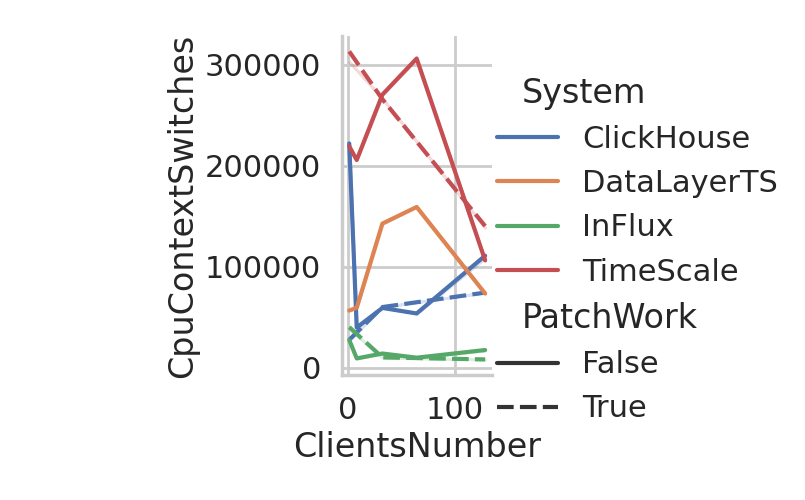

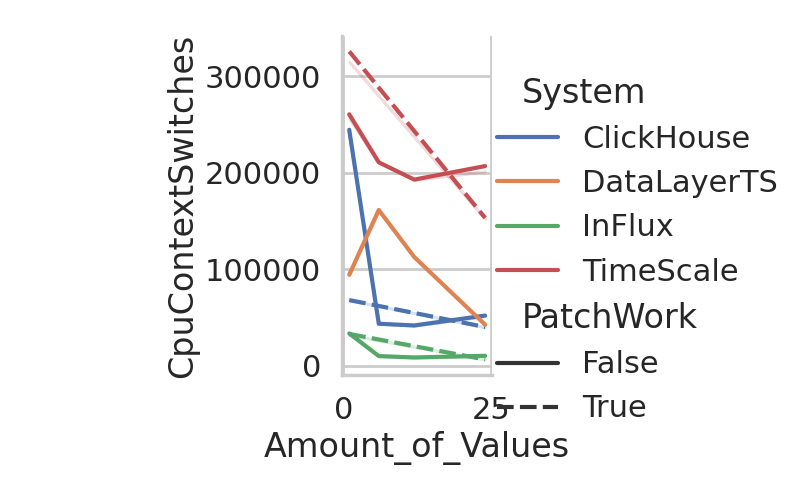

In [35]:


# plt.figure("cpu context switches ")
# plt.title("cpu context switches")
plt.close()
plt.close()
sns.relplot(data=combinedRates, kind="line", x="ClientsNumber",
            y="CpuContextSwitches", hue="System", style="PatchWork", errorbar=("ci",  0.0001))

plt.savefig(path+'cpu-context-switches-CN-031.svg',
            format='svg', bbox_inches="tight")
plt.show()
plt.close()
sns.relplot(data=combinedRates, kind="line", x="Amount_of_Values",
            y="CpuContextSwitches", hue="System", style="PatchWork", errorbar=("ci",  0.0001))
plt.savefig(path+'cpu-context-switches-V-032.svg',
            format='svg', bbox_inches="tight")
plt.show()
plt.close()


# plt.figure("swap ")
# plt.title("swap")
plt.close()
plt.close()
plt.close()
plt.close()

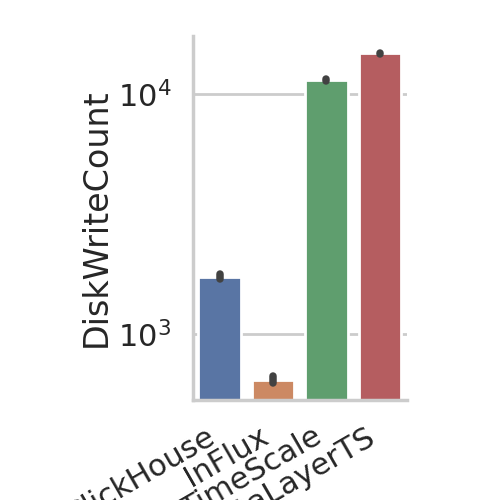

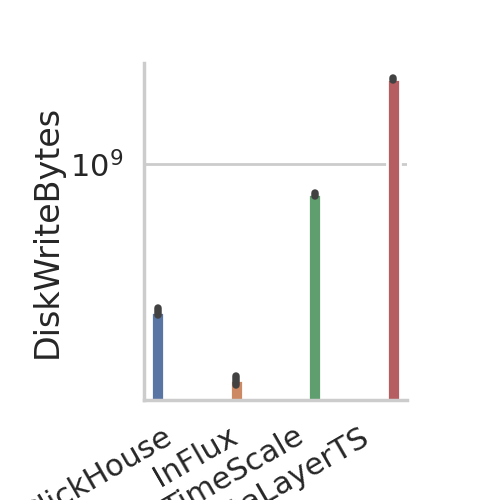

/tmp/ipykernel_207296/2178671278.py:26: UserWarning: Data has no positive values, and therefore cannot be log-scaled.
  plt.yscale('log')


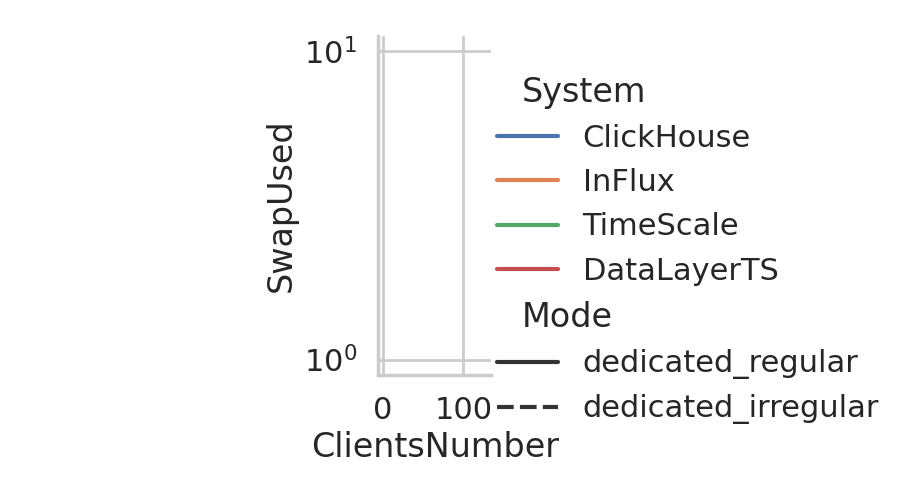

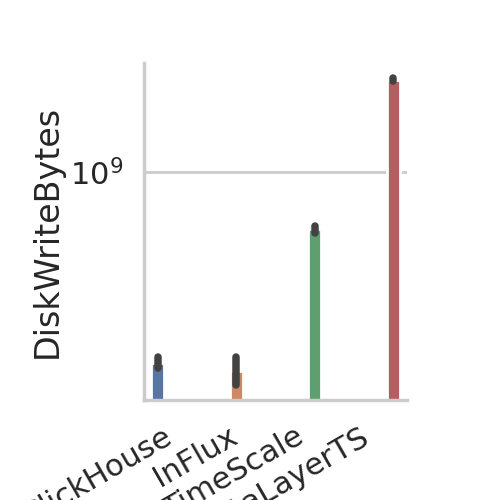

In [40]:
# Disk and swap


# plt.figure("Ingestion Disk WriteCOunt ")
sns.catplot(data=systemmetricsDED[systemmetricsDED['Operation'].str.contains(
    "Ing")], kind="bar", x='System', y="DiskWriteCount")
plt.gcf().autofmt_xdate()
plt.yscale('log')
plt.savefig(path+'IngWriteCount-033.svg', format='svg', bbox_inches="tight")
plt.show()
plt.close()


# plt.figure("Ingestion Disk Write Bytes ")
sns.catplot(data=systemmetricsDED[systemmetricsDED['Operation'].str.contains(
    "Ing")], kind="bar", x='System', y="DiskWriteBytes", hue="System")
plt.gcf().autofmt_xdate()
plt.yscale('log')
plt.savefig(path+'IngWriteBytes-034.svg', format='svg', bbox_inches="tight")
plt.show()
plt.close()


sns.relplot(data=systemmetricsDED.loc[systemmetricsDED["Operation"].str.contains("Ing")], kind="line", x="ClientsNumber",
            y="SwapUsed", hue="System", style="Mode")
plt.yscale('log')
plt.savefig(path+'swap-035.svg', format='svg', bbox_inches="tight")
plt.show()
plt.close()

####
sns.catplot(data=systemmetricsDED[systemmetricsDED['Operation'].str.contains(
    "Ing")& systemmetricsDED.BatchSize.isin([5000,15000])], kind="bar", x='System', y="DiskWriteBytes", hue="System")
plt.gcf().autofmt_xdate()
plt.yscale('log')
plt.savefig(path+'BS5+15-IngWriteBytes-035,1.svg', format='svg', bbox_inches="tight")
plt.show()
plt.close()


### multiDim transaction system usage

### Network Usage

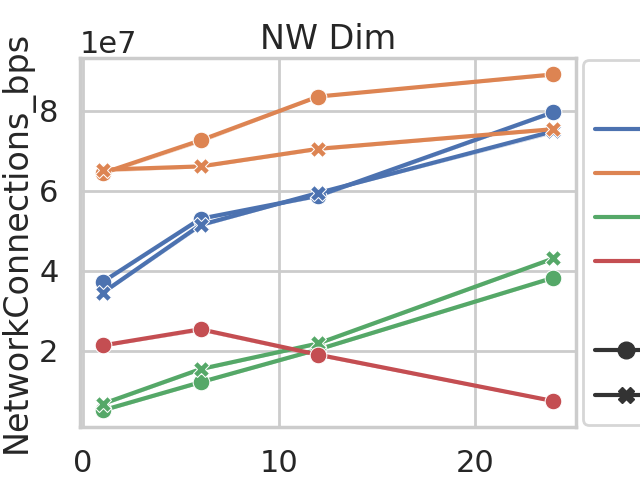

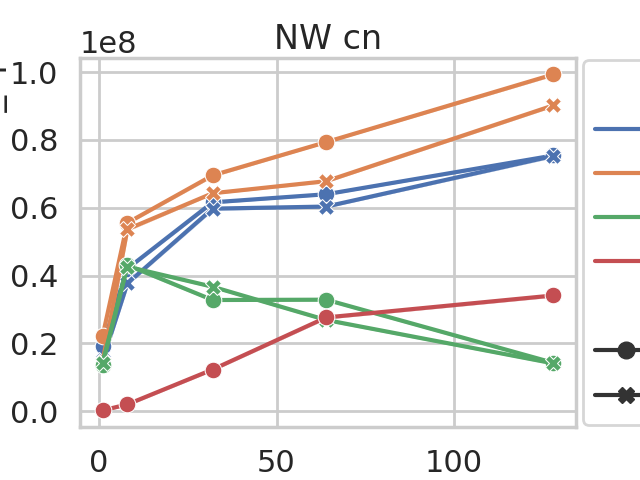

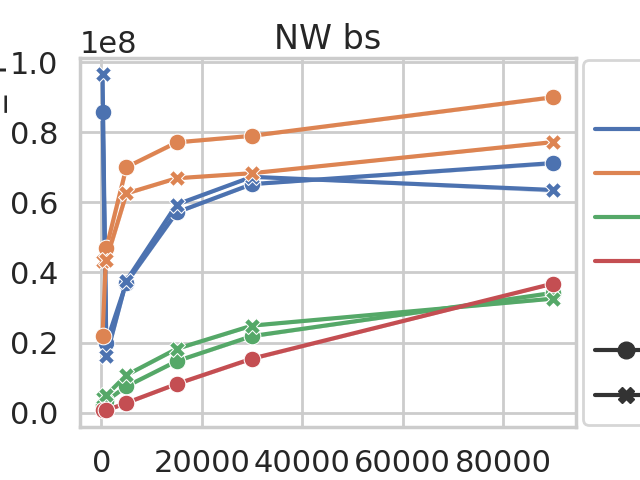

In [41]:
# Todo
# Compare Compression Policys


plt.figure("NW-Dim")
plt.title("NW Dim")

sns.lineplot(data=systemmetricsDED.loc[systemmetricsDED["Operation"].str.contains("Ing")], x="Amount_of_Values", y="NetworkConnections_bps",
             hue="System", style="Mode", markers=True, dashes=False, errorbar=("ci",  0.0001))
plt.legend(loc='center right', bbox_to_anchor=(1.865, 0.5))

plt.savefig(path+'NW-Dim-038.svg', format='svg', bbox_inches="tight")
plt.show()
plt.close()

plt.figure("NW-cn")
plt.title("NW cn")

sns.lineplot(data=systemmetricsDED.loc[systemmetricsDED["Operation"].str.contains("Ing")], x="ClientsNumber", y="NetworkConnections_bps",
             hue="System", style="Mode", markers=True, dashes=False, errorbar=("ci",  0.0001))
plt.legend(loc='center right', bbox_to_anchor=(1.865, 0.5))

plt.savefig(path+'NW-cn-039.svg', format='svg', bbox_inches="tight")
plt.show()
plt.close()
plt.figure("NW-bs")
plt.title("NW bs")

sns.lineplot(data=systemmetricsDED.loc[systemmetricsDED["Operation"].str.contains("Ing")], x="BatchSize", y="NetworkConnections_bps",
             hue="System", style="Mode", markers=True, dashes=False, errorbar=("ci",  0.0001))
plt.legend(loc='center right', bbox_to_anchor=(1.865, 0.5))

plt.savefig(path+'NW-bs-040.svg', format='svg', bbox_inches="tight")
plt.show()
plt.close()


# Network vs DiskIO

# plt.figure("NW-IO")
# plt.title("NW -IO")

# sns.lineplot(data=systemmetricsDED.loc[systemmetricsDED["Operation"].str.contains("Ing")], x="DiskWriteBytes", y="NetworkConnections_bps",
#              hue="System", style="Mode", markers=True, dashes=False)
# plt.xscale("log")
# plt.yscale("log")
# plt.savefig(path+'NW-IO-041.svg', format='svg', bbox_inches="tight")
# plt.show()
# plt.close()
# Network vs CPU

# plt.figure("NW-CPU")
# plt.title("NW CPU")

# sns.lineplot(data=systemmetricsDED, x="CpuTotal", y="NetworkConnections_bps_bps",
#              hue="System", style="Mode", markers=True, dashes=False)
# plt.savefig(path+'NW-CPU-042.svg', format='svg', bbox_inches="tight")
# plt.show()
# plt.close()

In [36]:
# plt.figure("NW-CPU")
# plt.title("NW CPU")

# sns.catplot(data=systemmetricsDED,kind="point", x="NetworkConnections_bps_bps", y="CpuTotal",
#              hue="System")
# plt.savefig(path+'NW-CPU-043.svg', format='svg', bbox_inches="tight")
# plt.show()
# plt.close()

### Filesystem VS CPU on Time

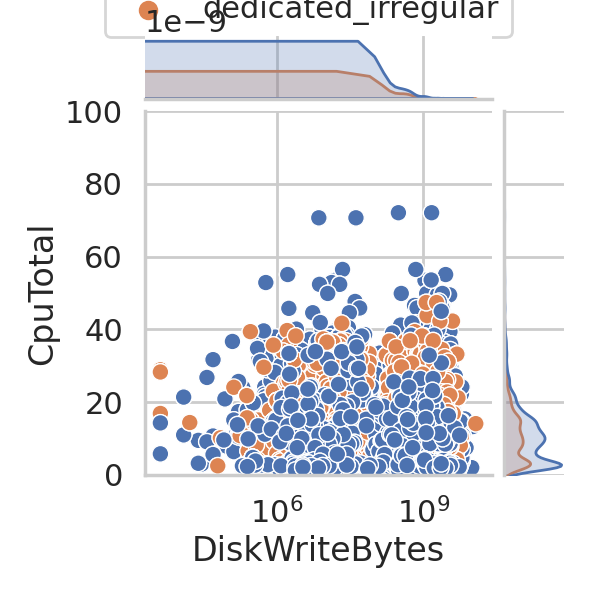

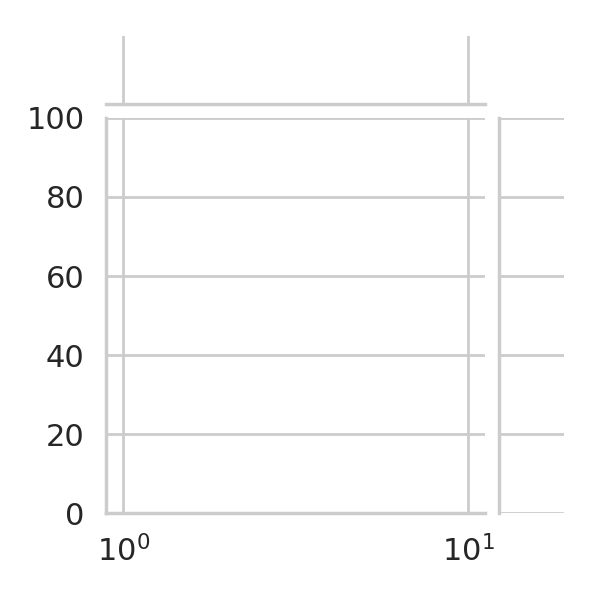

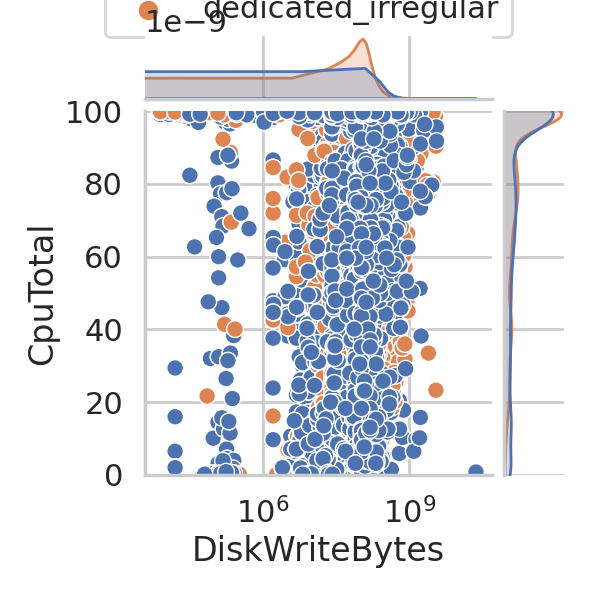

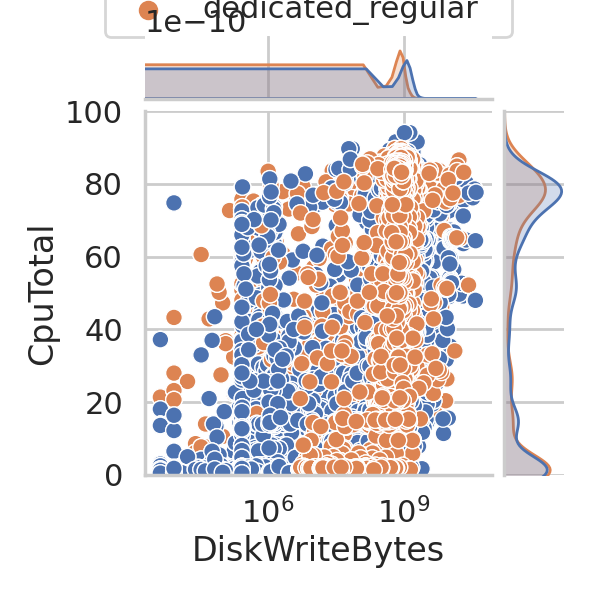

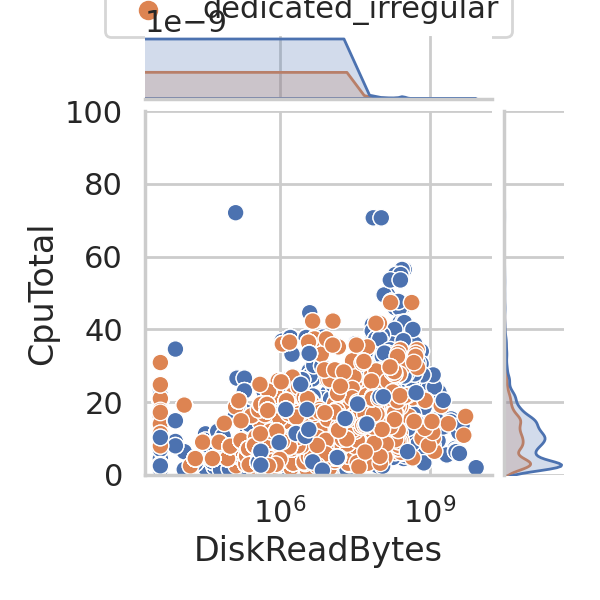

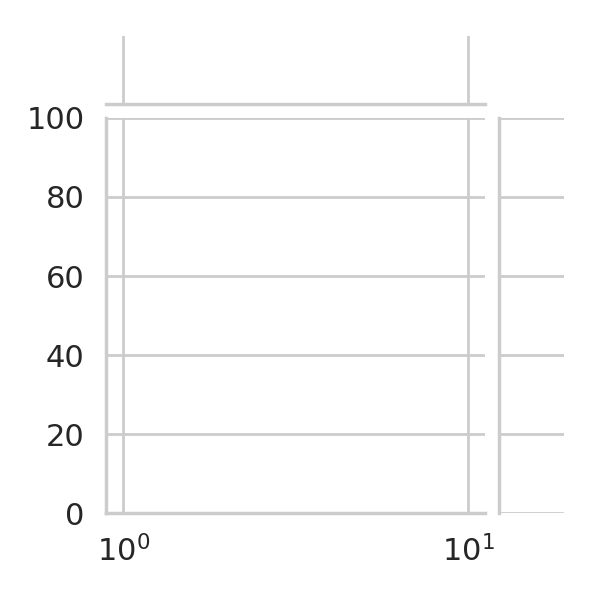

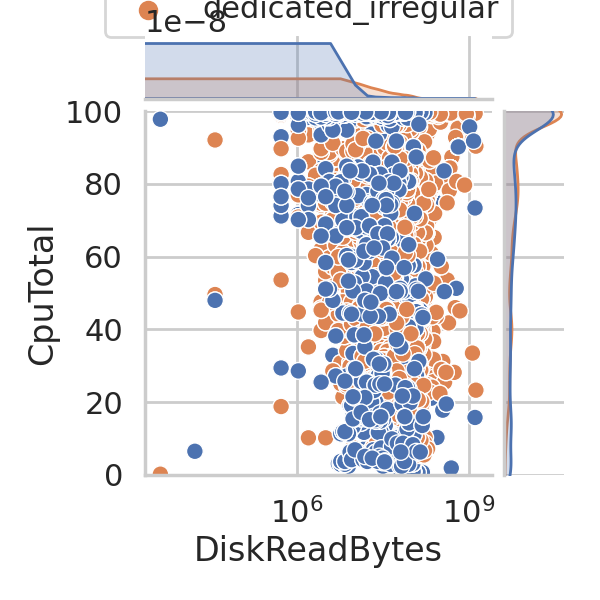

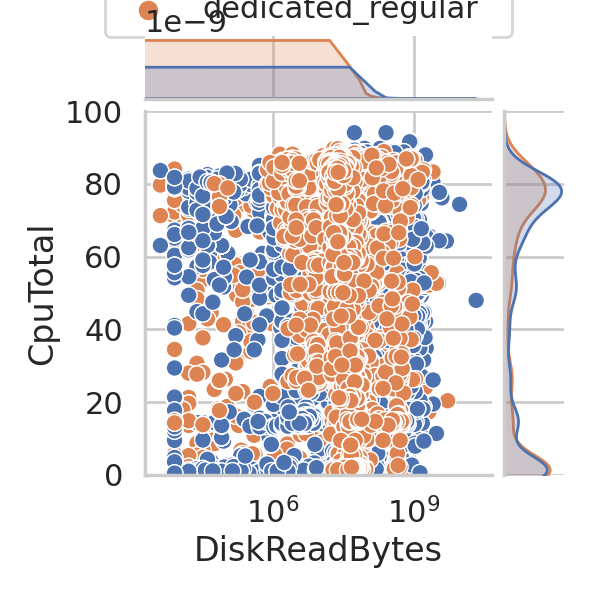

In [43]:
systemmetricsDED = systemmetricsDED.assign(DiskIoBytes=lambda x: x.DiskReadBytes +
                                           x.DiskWriteBytes).assign(SystemModes=lambda x: x.System+", "+x.Mode)
sns.jointplot(systemmetricsDED.loc[(systemmetricsDED["Operation"].str.contains("Ing")) & (
    systemmetricsDED["System"].str.contains("ClickHouse"))], x="DiskWriteBytes", y="CpuTotal", hue="Mode")
# plt.title("FSvsCPU-Ing-CH")
plt.xscale('log')
plt.ylim(0, 100)
plt.legend(loc='center right', bbox_to_anchor=(1.1, 1.34))

plt.savefig(path+'FSvsCPU-Ing-CH-044.svg', format='svg', bbox_inches="tight")
plt.show()
plt.close()

sns.jointplot(systemmetricsDED.loc[(systemmetricsDED["Operation"].str.contains("Ing")) & (
    systemmetricsDED["System"].str.contains("DataLayerTS-V"))], x="DiskWriteBytes", y="CpuTotal", hue="Mode")
# plt.title("FSvsCPU-Ing-DLTS")
plt.xscale('log')
plt.ylim(0, 100)
plt.legend(loc='center right', bbox_to_anchor=(1.1, 1.34))

plt.savefig(path+'FSvsCPU-Ing-DLTS-045.svg', format='svg', bbox_inches="tight")
plt.show()
plt.close()

sns.jointplot(systemmetricsDED.loc[(systemmetricsDED["Operation"].str.contains("Ing")) & (
    systemmetricsDED["System"].str.contains("InFlux"))], x="DiskWriteBytes", y="CpuTotal", hue="Mode")
# plt.title("FSvsCPU-Ing-IF")

plt.xscale('log')
plt.ylim(0, 100)
plt.legend(loc='center right', bbox_to_anchor=(1.1, 1.34))

plt.savefig(path+'FSvsCPU-Ing-IF-046.svg', format='svg', bbox_inches="tight")
plt.show()
plt.close()

sns.jointplot(systemmetricsDED.loc[(systemmetricsDED["Operation"].str.contains("Ing")) & (
    systemmetricsDED["System"].str.contains("TimeScale"))], x="DiskWriteBytes", y="CpuTotal", hue="Mode")
# plt.title("FSvsCPU-Ing-TS")
plt.xscale('log')
plt.ylim(0, 100)
plt.legend(loc='center right', bbox_to_anchor=(1.1, 1.34))

plt.savefig(path+'FSvsCPU-Inf-TS-047.svg', format='svg', bbox_inches="tight")
plt.show()
plt.close()
#  query

sns.jointplot(systemmetricsDED.loc[(systemmetricsDED["Operation"].str.contains("Ing")) & (
    systemmetricsDED["System"].str.contains("ClickHouse"))], x="DiskReadBytes", y="CpuTotal", hue="Mode")
# plt.title("FSvsCPU-Q-CH")
plt.xscale('log')
plt.ylim(0, 100)
plt.legend(loc='center right', bbox_to_anchor=(1.1, 1.34))

plt.savefig(path+'FSvsCPU-Q-CH-048.svg', format='svg', bbox_inches="tight")
plt.show()
plt.close()

sns.jointplot(systemmetricsDED.loc[(systemmetricsDED["Operation"].str.contains("Ing")) & (
    systemmetricsDED["System"].str.contains("DataLayerTS-V"))], x="DiskReadBytes", y="CpuTotal", hue="Mode")
# plt.title("FSvsCPU-Q-DLTS")
plt.xscale('log')
plt.ylim(0, 100)
plt.legend(loc='center right', bbox_to_anchor=(1.1, 1.34))

plt.savefig(path+'FSvsCPU-Q-DLTS-049.svg', format='svg', bbox_inches="tight")
plt.show()
plt.close()

sns.jointplot(systemmetricsDED.loc[(systemmetricsDED["Operation"].str.contains("Ing")) & (
    systemmetricsDED["System"].str.contains("InFlux"))], x="DiskReadBytes", y="CpuTotal", hue="Mode")
# plt.title("FSvsCPU-Q-IF")
plt.xscale('log')
plt.ylim(0, 100)
plt.legend(loc='center right', bbox_to_anchor=(1.1, 1.34))

plt.savefig(path+'FSvsCPU-Q-IF-049,1.svg', format='svg', bbox_inches="tight")
plt.show()
plt.close()

sns.jointplot(systemmetricsDED.loc[(systemmetricsDED["Operation"].str.contains("Ing")) & (
    systemmetricsDED["System"].str.contains("TimeScale"))], x="DiskReadBytes", y="CpuTotal", hue="Mode")
# plt.title("FSvsCPU-Q-TS")
plt.xscale('log')
plt.ylim(0, 100)
plt.legend(loc='center right', bbox_to_anchor=(1.1, 1.34))

plt.savefig(path+'FSvsCPU-q-TS-050.svg', format='svg', bbox_inches="tight")
plt.show()
plt.close()

## Combined Metrics

### Ingestion CPU vs Bandwidth


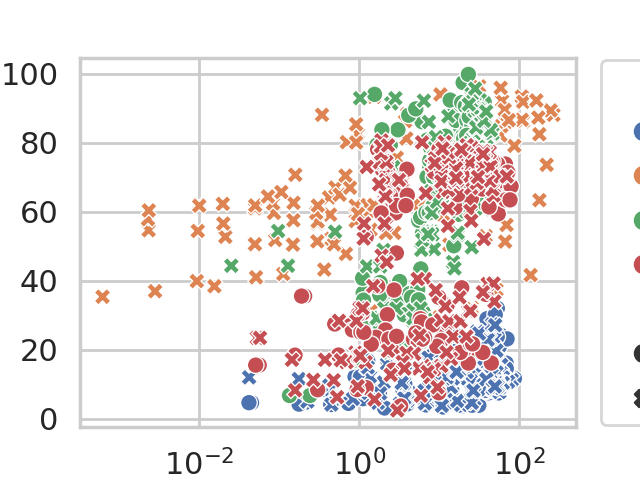

In [44]:
sns.set_theme(style="whitegrid")
# plt.style.use('seaborn')
sns.set_context("poster")

 


# plt.figure("CPU-vs-Bandwidth_Client")
# plt.title("CPU-vs-Bandwidth_Client")
# sns.lineplot(Combinded_ingestion.loc[Combinded_ingestion["Mode"].str.contains(
#     "dedicated_")], x="MB_per_Sec_with_Client", y="CpuTotal", hue="System", style="Mode")
# plt.xscale("log")
# plt.savefig(path+'CPU-vs-Bandwidth_Client-052.svg', format='svg', bbox_inches="tight")
# plt.show()
# plt.close()

sns.set_theme(style="whitegrid")
# plt.style.use('seaborn')
sns.set_context("poster")

plt.figure("CPU-vs-Bandwidth-Pair")
sns.scatterplot(Combinded_ingestion.loc[Combinded_ingestion["Mode"].str.contains(
    "dedicated_")], x="MB_per_Sec", y="CpuTotal", hue="System", style="Mode")
plt.xscale("log")
plt.legend(loc='center right', bbox_to_anchor=(1.9, 0.5))

plt.savefig(path+'!CPU-vs-Bandwidth_Pair-053.svg',
            format='svg', bbox_inches="tight")
plt.show()
plt.close()


# plt.figure("CPU-vs-Bandwidth")
# plt.title("CPU-vs-Bandwidth")
# sns.catplot(Combinded_ingestion ,kind="point",x = "CpuTotal" ,y = "MB_per_Sec" , hue="SystemModes", col="Operation")
# plt.yscale("log")
# plt.savefig(path+'CPU-vs-Bandwidth-054.svg', format='svg', bbox_inches="tight")
# plt.show()
# plt.close()

NameError: name 'Combinded_top_ingestion' is not defined

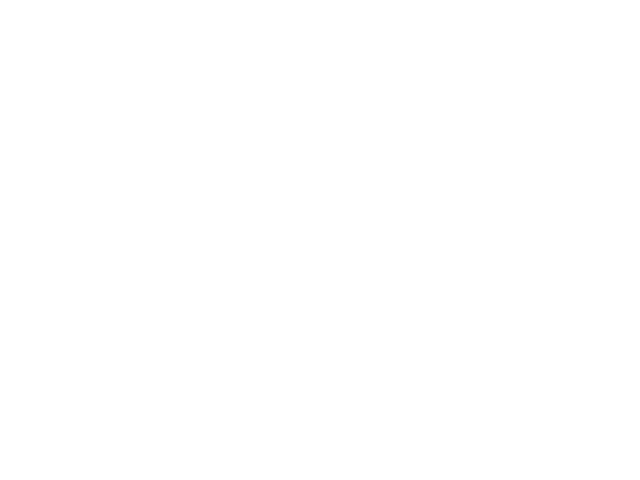

In [11]:
# top ingestion cpu vs bandwithd
sns.set_theme(style="whitegrid")
# plt.style.use('seaborn')
sns.set_context("poster")
plt.close()
plt.close()

plt.figure("CPU-vs-Bandwidth-Pair_top")
sns.scatterplot(Combinded_top_ingestion.loc[Combinded_top_ingestion["Mode"].str.contains(
    "dedicated_")], x="MB_per_Sec_x", y="CpuTotal", hue="System", style="Mode", s=500)
plt.xscale("linear")
plt.legend(loc='center right', bbox_to_anchor=(1.9, 0.5))

plt.savefig(path+'!CPU-vs-Bandwidth_Pair_TOP-055.svg',
            format='svg', bbox_inches="tight")
plt.show()
plt.close()




plt.figure("CPU-vs-DiskWrite-Pair_top")
sns.scatterplot(Combinded_top_ingestion.loc[Combinded_top_ingestion["Mode"].str.contains(
    "dedicated_")], x="DiskWriteBytes", y="CpuTotal", hue="System", style="Mode", s=500)
plt.xscale("linear")
plt.legend(loc='center right', bbox_to_anchor=(1.9, 0.5))

plt.savefig(path+'!DiskWrite-vs-CPU_Pair_TOP-055,1.svg',
            format='svg', bbox_inches="tight")
plt.show()
plt.close()




In [ ]:

plt.figure("BS5-15-CPU-vs-Bandwidth-Pair")


sns.scatterplot(Combinded_ingestion.loc[Combinded_ingestion["Mode"].str.contains(
    "dedicated_")&Combinded_ingestion.BatchSize.isin([5000,15000])], x="MB_per_Sec", y="CpuTotal", hue="System", style="Mode")
plt.xscale("log")
plt.legend(loc='center right', bbox_to_anchor=(1.9, 0.5))

plt.savefig(path+'!(BS5-15)_CPU-vs-Bandwidth_Pair-055,2.svg',
            format='svg', bbox_inches="tight")
plt.show()
plt.close()






sns.set_context("poster")
plt.figure("BS5-15:CPU-vs-Bandwidth_top")
iobm=sns.relplot(Combinded_ingestion.loc[Combinded_ingestion["Mode"].str.contains(
    "dedicated_")&Combinded_ingestion.BatchSize.isin([5000,15000]) ].groupby(["System", "Amount_of_Values","Regularity"], as_index=False).max({"MB_per_Sec"}), kind="scatter", y="MB_per_Sec", x="CpuTotal", hue="System", style="Regularity", size="Amount_of_Values", s=500 )
plt.xscale("linear")
plt.yscale("linear")
 
sns.move_legend(iobm,loc='center right', bbox_to_anchor=(0.95, 0.5),  fontsize="17")#

plt.savefig(path+'!(BS5-15)_CPU-vs-Bandwidth_+v_Pair_TOP--055,21.svg',
            format='svg', bbox_inches="tight")
plt.show()
plt.close()



sns.set_context("poster")
plt.figure("BS5-15:CPU-vs-Bandwidth_top")
iobm=sns.relplot(Combinded_ingestion.loc[Combinded_ingestion["Mode"].str.contains(
    "dedicated_")&Combinded_ingestion.BatchSize.isin([5000,15000]) ].groupby(["System", "Amount_of_Values","Regularity"], as_index=False).max({"MB_per_Sec"}), kind="scatter", y="MB_per_Sec", x="DiskWriteBytes", hue="System", style="Regularity", size="Amount_of_Values", s=500 )
plt.xscale("linear")
plt.yscale("linear")
 
sns.move_legend(iobm,loc='center right', bbox_to_anchor=(0.95, 0.5),  fontsize="17")#

plt.savefig(path+'!(BS5-15)_Disk-vs-Bandwidth_+DIM_Pair_TOP--055,22.svg',
            format='svg', bbox_inches="tight")
plt.show()
plt.close()



plt.figure("BS5-15-CPU-vs-DiskWrite-Pair_top")
sns.scatterplot(Combinded_ingestion.loc[Combinded_ingestion["Mode"].str.contains(
    "dedicated_")&Combinded_ingestion.BatchSize.isin([5000,15000])], x="DiskWriteBytes", y="CpuTotal", hue="System", style="Mode", s=500)
plt.xscale("log")
plt.legend(loc='center right', bbox_to_anchor=(1.6, 0.5))

plt.savefig(path+'!(BS5-15)_DiskWrite-vs-CPU_Pair_-055,3.svg',
            format='svg', bbox_inches="tight")
plt.show()
plt.close()



plt.figure("BS5-15-CPU-vs-DiskWrite-Pair_top")
sns.scatterplot(Combinded_ingestion.loc[Combinded_ingestion["Mode"].str.contains(
    "dedicated_")&Combinded_ingestion.BatchSize.isin([5000,15000])], x="DiskWriteBytes", y="CpuTotal", hue="System", style="Amount_of_Values", s=500)
plt.xscale("log")
plt.legend(loc='center right', bbox_to_anchor=(1.6, 0.5))

plt.savefig(path+'!(BS5-15)_DiskWrite-vs-CPU_Pair_-055,3.svg',
            format='svg', bbox_inches="tight")
plt.show()
plt.close()

### Ingestion IO vs Bandwidth

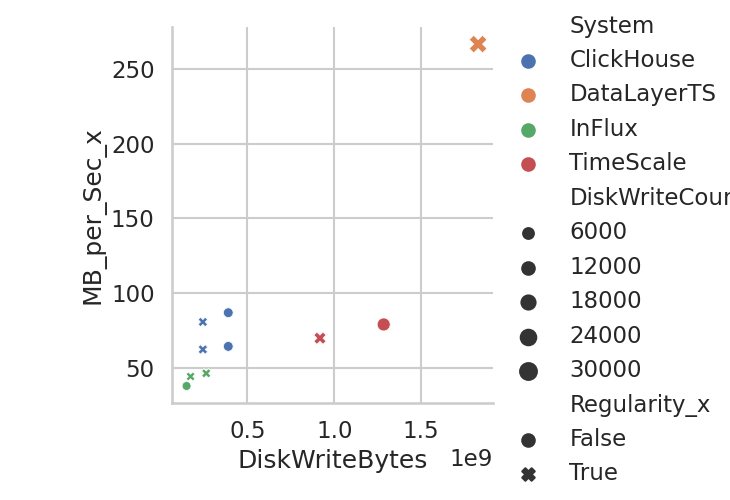

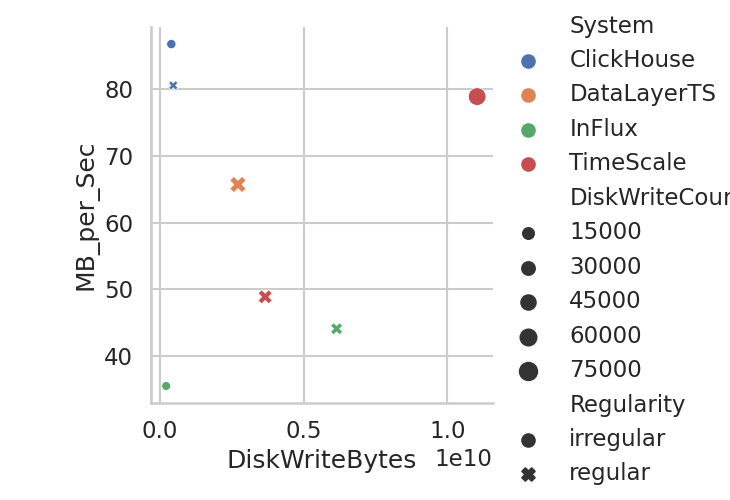

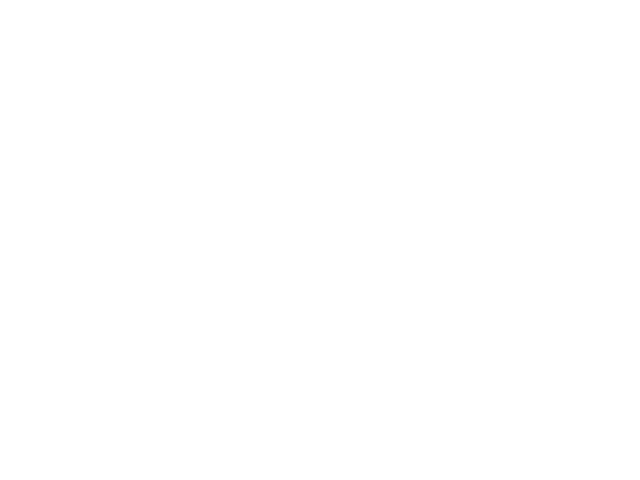

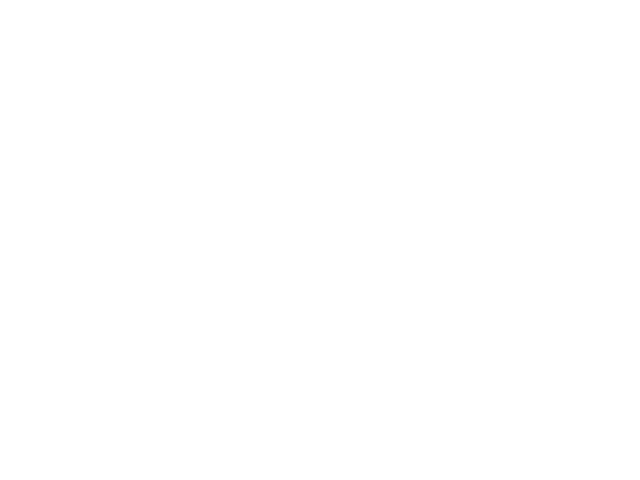

In [72]:
sns.set_context("talk")
plt.figure("DiskIO-vs-Bandwidth_top")
iobm=sns.relplot(Combinded_top_ingestion.loc[Combinded_top_ingestion["Mode"].str.contains(
    "dedicated_") ], kind="scatter", y="MB_per_Sec_x", x="DiskWriteBytes", hue="System", style="Regularity_x", size="DiskWriteCount", )
plt.xscale("linear")
plt.yscale("linear")
sns.move_legend(iobm,loc='center right', bbox_to_anchor=(1.05, 0.5) )

plt.savefig(path+'DiskIO-C+W-vs-Bandwidth_top_C-scatter-060.svg',
            format='svg', bbox_inches="tight")
plt.show()
plt.close()


sns.set_context("talk")
plt.figure("BS5-15:DiskIO-vs-Bandwidth_top")
iobm=sns.relplot(Combinded_ingestion.loc[Combinded_ingestion["Mode"].str.contains(
    "dedicated_")&Combinded_ingestion.BatchSize.isin([5000,15000]) ].groupby(["System", "Regularity"], as_index=False).max({"MB_per_Sec"}), kind="scatter", y="MB_per_Sec", x="DiskWriteBytes", hue="System", style="Regularity", size="DiskWriteCount", )
plt.xscale("linear")
plt.yscale("linear")
sns.move_legend(iobm,loc='center right', bbox_to_anchor=(1.05, 0.5))

plt.savefig(path+'(BS5-15)DiskIO-C+W-vs-Bandwidth_C-scatter-060,1.svg',
            format='svg', bbox_inches="tight")
plt.show()
plt.close()

# Ingestion Network VS Bandwidth (Compression effectiveness) 

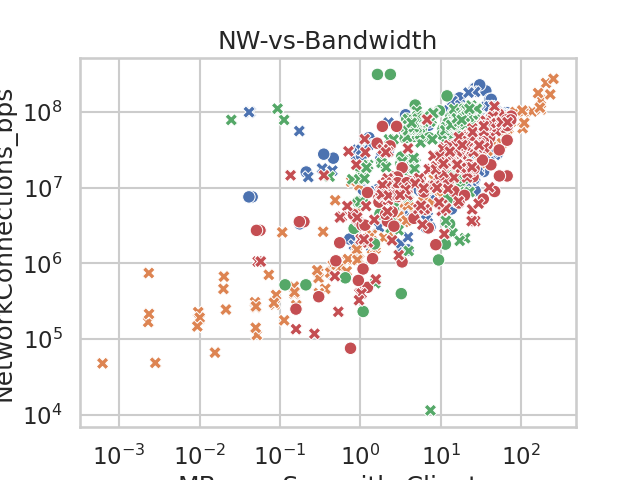

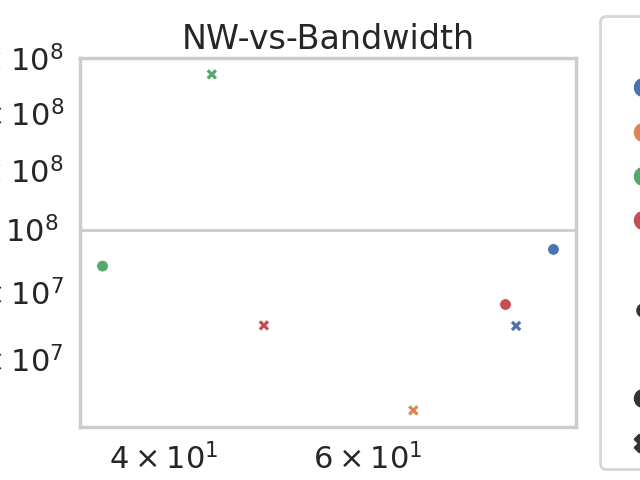

In [73]:
# plt.figure("NW-vs-Bandwidth")
# plt.title("NW-vs-Bandwidth")
# sns.lineplot(Combinded_ingestion.loc[Combinded_ingestion["Mode"].str.contains(
#     "dedicated_")], x="MB_per_Sec", y="NetworkConnections_bps", hue="System", style="Mode")
# plt.xscale("log")
# plt.yscale("log")
# plt.legend(loc='center right', bbox_to_anchor=(1.65, 0.5))

# plt.savefig(path+'NW-vs-Bandwidth-061.svg', format='svg', bbox_inches="tight")
# plt.show()
# plt.close()

plt.figure("NW-vs-Bandwidth")
plt.title("NW-vs-Bandwidth")
sns.scatterplot(Combinded_ingestion.loc[Combinded_ingestion["Mode"].str.contains(
    "dedicated_")], x="MB_per_Sec_with_Client", y="NetworkConnections_bps", hue="System", style="Mode")
plt.xscale("log")
plt.yscale("log")
plt.legend(loc='center right', bbox_to_anchor=(1.865, 0.5))

plt.savefig(path+'NW-vs-Bandwidth-scatter-062.svg',
            format='svg', bbox_inches="tight")
plt.show()
plt.close()

sns.set_context("poster")
plt.figure("BS5-15-NW-vs-Bandwidth")
plt.title("NW-vs-Bandwidth")
sns.scatterplot(Combinded_ingestion.loc[Combinded_ingestion["Mode"].str.contains(
    "dedicated_")& Combinded_ingestion.BatchSize.isin([5000,15000]) ].groupby(["System", "Regularity"], as_index=False).max({"MB_per_Sec"}), x="MB_per_Sec", y="NetworkConnections_bps", hue="System", style="Regularity", size="Amount_of_Values")
plt.xscale("log")
plt.yscale("log")
plt.legend(loc='center right', bbox_to_anchor=(1.865, 0.5))

plt.savefig(path+'(BS5-15)NW-vs-Bandwidth-scatter-062,1.svg',
            format='svg', bbox_inches="tight")
plt.show()
plt.close()



# plt.figure("NW-vs-Bandwidth_Client")
# plt.title("NW-vs-Bandwidth_Client")
# sns.lineplot(Combinded_ingestion.loc[Combinded_ingestion["Mode"].str.contains(
#     "dedicated_")], x="MB_per_Sec_with_Client", y="NetworkConnections_bps", hue="System", style="Mode")
# plt.xscale("log")
# plt.yscale("log")

# plt.savefig(path+'NW-vs-Bandwidth_Client-063.svg', format='svg', bbox_inches="tight")
# plt.show()
# plt.close()

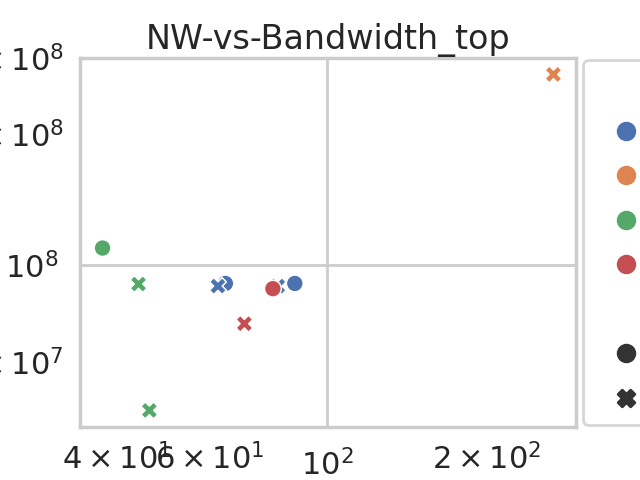

In [75]:


plt.figure("NW-vs-Bandwidth_top")
plt.title("NW-vs-Bandwidth_top")
sns.scatterplot(Combinded_top_ingestion.loc[Combinded_top_ingestion["Mode"].str.contains(
    "dedicated_")], x="MB_per_Sec_x", y="NetworkConnections_bps", hue="System", style="Mode")
plt.xscale("log")
plt.yscale("log")
plt.legend(loc='center right', bbox_to_anchor=(1.865, 0.5))

plt.savefig(path+'NW-vs-Bandwidth_top-scatter-064.svg',
            format='svg', bbox_inches="tight")
plt.show()
plt.close()

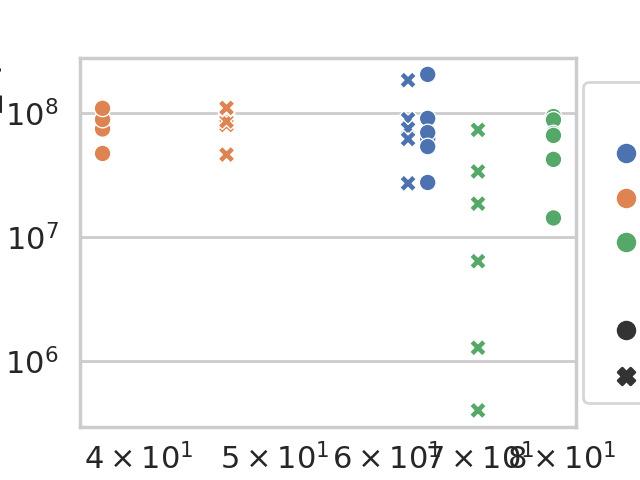

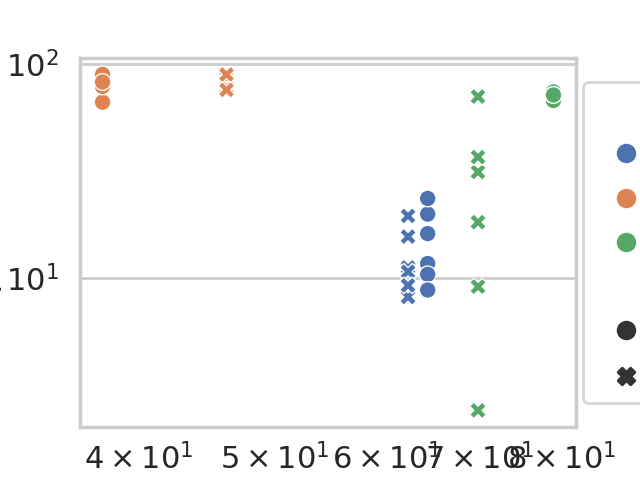

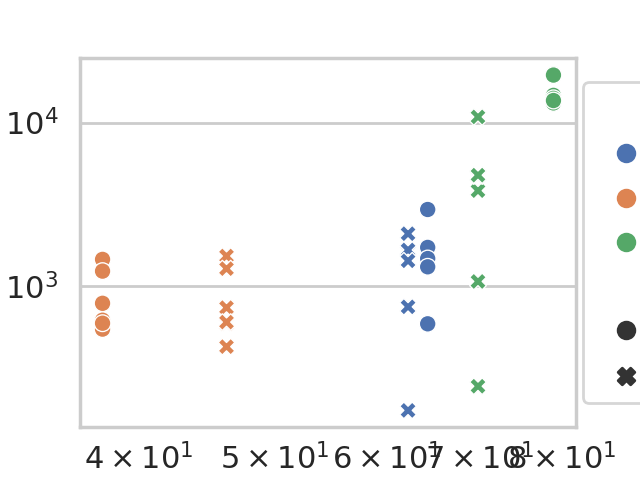

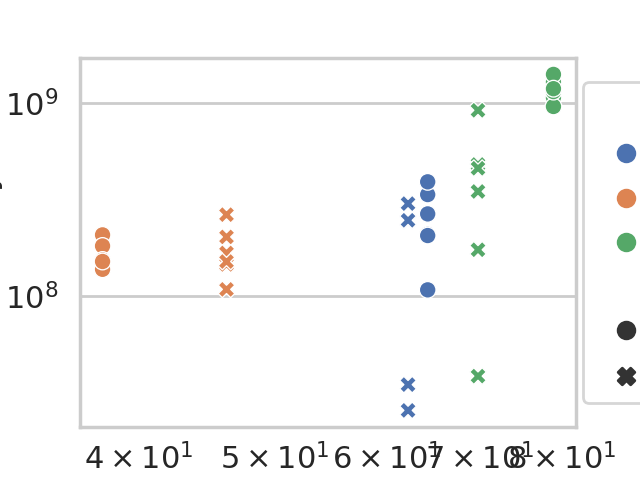

In [76]:
# TODO TOP CONFIG scatter IO / cpu on BDWDt

top_combinded = systemmetrics_rates.merge(
    top_rates_Ded_Patch_Ing, how='inner', on=['System', 'Amount_of_Values', 'ClientsNumber', 'Operation', 'Mode'])


plt.figure(" ")
plt.title(" ")
sns.scatterplot(top_combinded, x="MB_per_Sec",
                y="NetworkConnections_bps", hue="System", style="Mode")
plt.xscale("log")
plt.yscale("log")
plt.legend(loc='center right', bbox_to_anchor=(1.865, 0.5))

plt.savefig(path+'TOP-NW-vs-Bandwidth-scatter-065.svg',
            format='svg', bbox_inches="tight")
plt.show()
plt.close()


plt.figure(" ")
plt.title(" ")
sns.scatterplot(top_combinded, x="MB_per_Sec",
                y="CpuTotal", hue="System", style="Mode")
plt.xscale("log")
plt.yscale("log")
plt.legend(loc='center right', bbox_to_anchor=(1.865, 0.5))

plt.savefig(path+'!TOP-CPU-vs-Bandwidth-scatter-066.svg',
            format='svg', bbox_inches="tight")
plt.show()
plt.close()


plt.figure(" ")
sns.scatterplot(top_combinded, x="MB_per_Sec",
                y="DiskWriteCount", hue="System", style="Mode")
plt.xscale("log")
plt.yscale("log")
plt.legend(loc='center right', bbox_to_anchor=(1.865, 0.5))

plt.savefig(path+'TOP-DiskWriteCount-vs-Bandwidth-scatter-067.svg',
            format='svg', bbox_inches="tight")
plt.show()
plt.close()


plt.figure("dd ")

sns.scatterplot(top_combinded, x="MB_per_Sec",
                y="DiskWriteBytes", hue="System", style="Mode")
plt.xscale("log")
plt.yscale("log")
plt.legend(loc='center right', bbox_to_anchor=(1.865, 0.5))

plt.savefig(path+'!TOP-DiskWriteBytes-vs-Bandwidth-scatter-068.svg',
            format='svg', bbox_inches="tight")
plt.show()
plt.close()

#  Ingestion Network vs CPU (Compression efficiency)

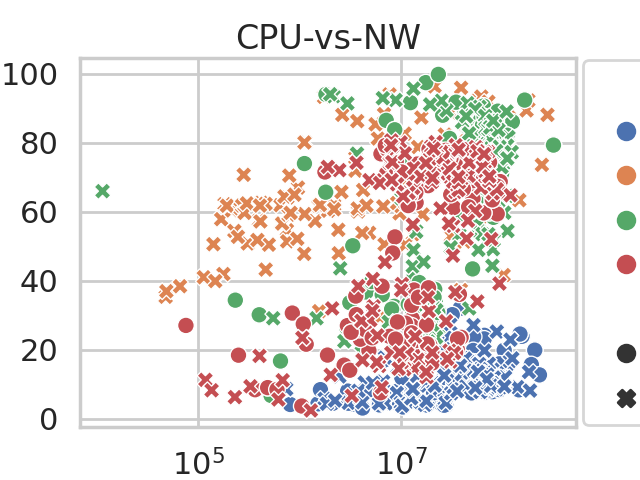

In [77]:

plt.figure("CPU-vs-NW")
plt.title("CPU-vs-NW")
sns.scatterplot(Combinded_ingestion.loc[Combinded_ingestion["Mode"].str.contains(
    "dedicated_")], x="NetworkConnections_bps", y="CpuTotal", hue="System", style="Mode")
plt.xscale("log")
plt.legend(loc='center right', bbox_to_anchor=(1.865, 0.5))

plt.savefig(path+'CPU-vs-NW-069.svg', format='svg', bbox_inches="tight")
plt.show()
plt.close()

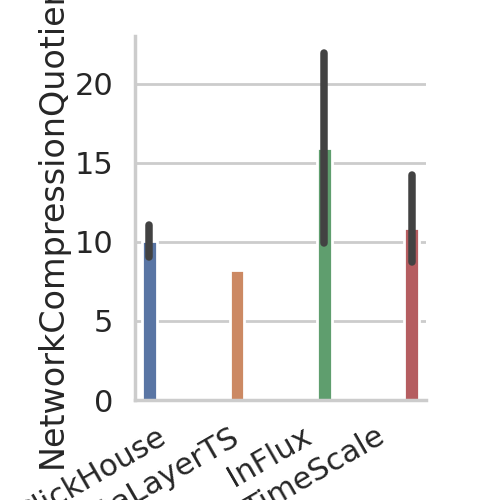

In [78]:
plt.title(
    "Compression Ratio by Transfered Byte in a Second - without Encoding Time (Client) ")
sns.catplot(data=Combinded_top_ingestion.loc[Combinded_top_ingestion["Mode"].str.contains(
    "dedicated_")], kind="bar", x='System', y="NetworkCompressionQuotient", hue="System")
plt.gcf().autofmt_xdate()

plt.savefig(path+'IngWriteBytes-071.svg', format='svg', bbox_inches="tight")
plt.show()
plt.close()

# plt.title(
#     "Compression Ratio by Transfered Byte in a Second - with  Encoding Time (Client) ")
# sns.catplot(data=Combinded_top_ingestion.loc[Combinded_top_ingestion["Mode"].str.contains(
#     "dedicated_")], kind="bar", x='System', y="NetworkCompressionQuotient_Client", hue="System")
# plt.gcf().autofmt_xdate()

# plt.savefig(path+'IngWriteBytes_client-072.svg',
#             format='svg', bbox_inches="tight")
# plt.show()
# plt.close()

DIMefficinecy


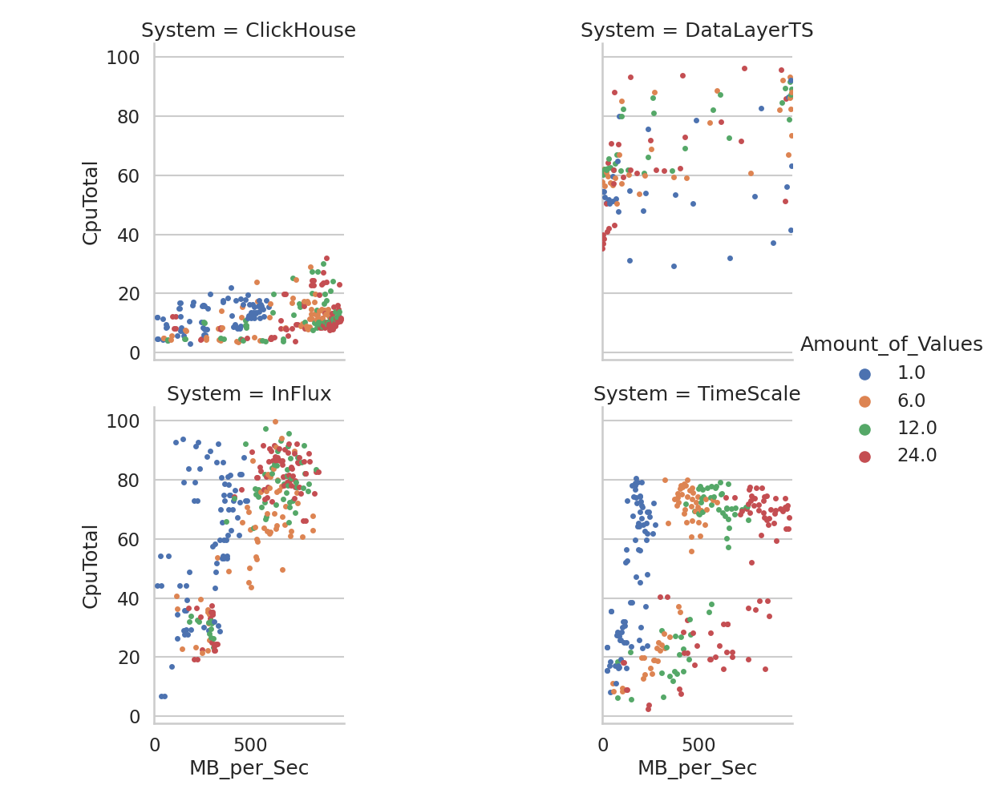

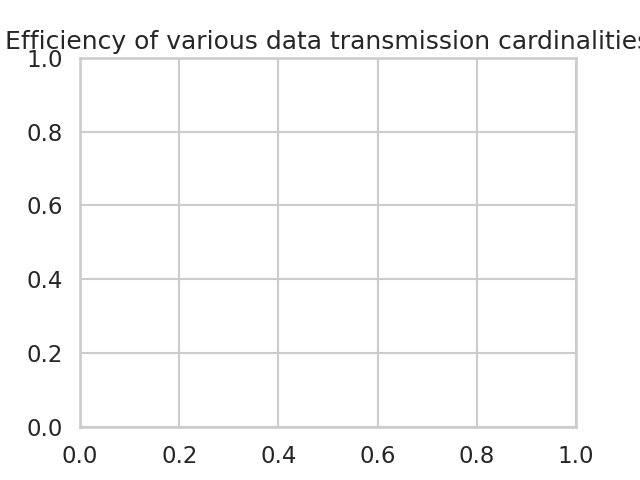

In [79]:
print("DIMefficinecy")

sns.set_context("talk")
plt.figure("Dim Efficiency")
plt.title("Efficiency of various data transmission cardinalities")
sns.catplot(Combinded_ingestion.loc[Combinded_ingestion.Mode.str.contains("ded")].loc[Combinded_ingestion.System.str.contains(
    "Dumm") == False], kind="swarm", col="System", col_wrap=2, x="MB_per_Sec", y="CpuTotal", hue="Amount_of_Values", palette="deep")
plt.xscale("linear")
plt.yscale("linear")
plt.savefig(path+'DIM-BANDWDTH-vs-CPU-scatter-072.svg',
            format='svg', bbox_inches="tight")
plt.show()
plt.close()

DIMefficinecy top


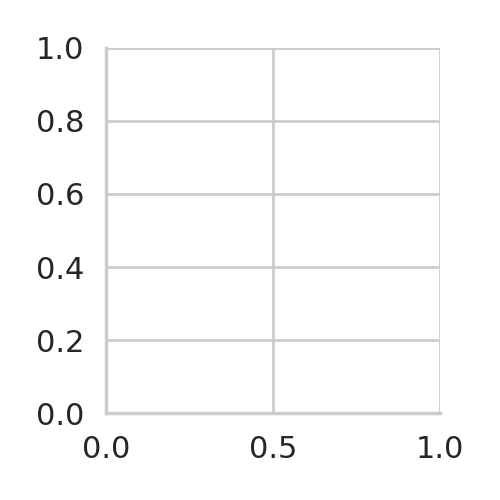

DIMefficinecy Disk top


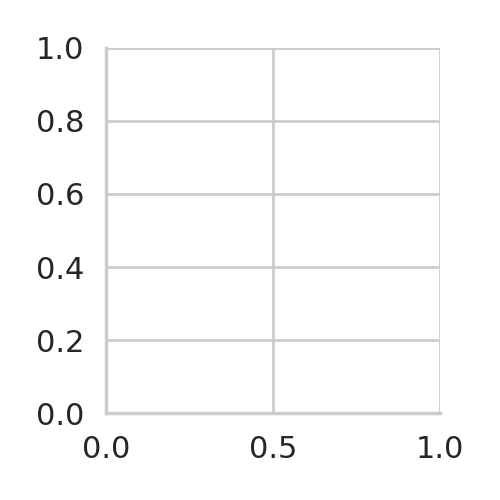

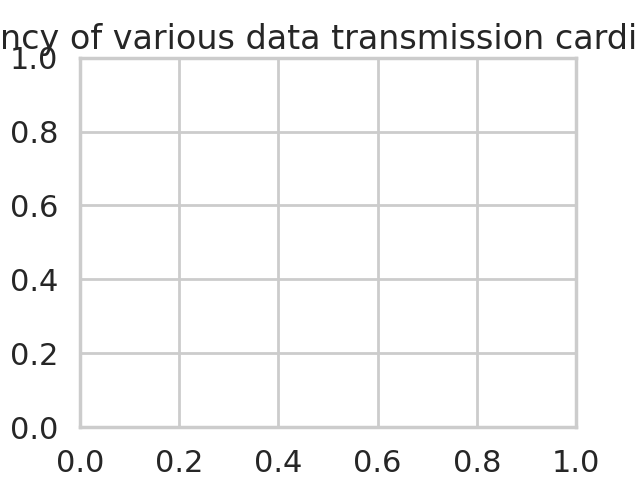

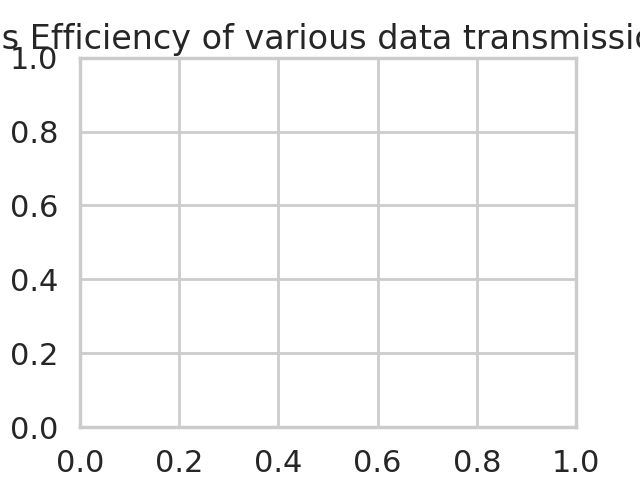

In [18]:
plt.close()

plt.close()
plt.close()
print("DIMefficinecy top")
sns.set_theme(style="whitegrid")
# plt.style.use('seaborn')
sns.set_context("poster")

atest = Combinded_ingestion.loc[Combinded_ingestion.Mode.str.contains(
    "ded")].loc[Combinded_ingestion.System.str.contains("Dumm") == False]
atest = atest.merge(top_rates_Ded_Ing, how="inner")
atest = atest.groupby(["System", "Amount_of_Values"]
                      ).mean({"MB_per_Sec", "CpuTotal"})
plt.figure("Dim Efficiency")
plt.title("Efficiency of various data transmission cardinalities")
sns.relplot(atest, kind="scatter", hue="System",
            x="MB_per_Sec", y="CpuTotal", style="Amount_of_Values", size="Amount_of_Values")
plt.xscale("linear")
plt.yscale("linear")
plt.savefig(path+'!DIM-BANDWDTH-vs-CPU-TOP_AVG-scatter-073.svg',
            format='svg', bbox_inches="tight")
plt.show()
plt.close()


print("DIMefficinecy Disk top")
sns.set_theme(style="whitegrid")
# plt.style.use('seaborn')
sns.set_context("poster")

atest = Combinded_ingestion.loc[Combinded_ingestion.Mode.str.contains(
    "ded")].loc[Combinded_ingestion.System.str.contains("Dumm") == False]
atest = atest.merge(top_rates_Ded_Ing, how="inner")
atest = atest.groupby(["System", "Amount_of_Values"]
                      ).mean({"MB_per_Sec", "DiskWriteBytes"})
plt.figure("Dim EfficiencyDiskWriteBytes")
plt.title("DiskWriteBytes Efficiency of various data transmission cardinalities")
sns.relplot(atest, kind="scatter", hue="System",
            x="MB_per_Sec", y="DiskWriteBytes", style="Amount_of_Values", size="Amount_of_Values")
plt.xscale("linear")
plt.yscale("linear")
plt.savefig(path+'!DIM-BANDWDTH-vs-DiskWriteBytes-TOP_AVG-scatter-074.svg',
            format='svg', bbox_inches="tight")
plt.show()
plt.close()

## Scaling: How does the System behave with long-term ingestion?
### ingestion rate

In [81]:
# scaling_ingestion=results.loc[results["Mode"].str.contains["pop"]].assign(AlreadyIngested=results.groupby(['System'])["ValueArrays"].cumsum()  )


# # plt.figure("TopConfig-scaling-Latency")
# # plt.title("TopConfig scaling Latency")
# sns.lineplot(data=scaling_ingestion , x="AlreadyIngested", y="MB_per_Sec", hue="System", style="Mode", markers=True, dashes=False)
# plt.savefig(path+'scaleTopLatency-075.svg', format='svg', bbox_inches="tight")
# plt.show()
# plt.close()

### storage


In [54]:
# #diskusage since ingestionstart
# scaling_storage=scaling_ingestion.assign(FsUsed= lambda x: x.FsSize-x.FsFree)

# plt.figure("scaling-Storage")
# plt.title("  scaling Storage. Approximation, as some systemmetrics packets go lost in Transmission")
# sns.lineplot(data=scaling_storage , x="AlreadyIngested", y="FsUsed", hue="Database",  markers=True, dashes=False) #style="Mode",    .loc[scaling_storage['AlreadyIngested']>100]
# plt.savefig(path+'scaleStorage-076.svg', format='svg', bbox_inches="tight")
# plt.show()
# plt.close()

### CPU  

In [55]:
# plt.figure("scaling-CPU")
# plt.title("  scaling CPU")
# sns.lineplot(data=scaling_storage , x="AlreadyIngested", y="CpuTotal", hue="Database",  markers=True, dashes=False) #style="Mode",    .loc[scaling_storage['AlreadyIngested']>100]
# plt.savefig(path+'scaleCPU-077.svg', format='svg', bbox_inches="tight")
# plt.show()
# plt.close()

### memory

In [56]:
# plt.figure("scaling-Mem")
# plt.title("  scaling Mem")
# sns.lineplot(data=scaling_storage , x="AlreadyIngested", y="MemUsed", hue="Database",  markers=True, dashes=False) #style="Mode",    .loc[scaling_storage['AlreadyIngested']>100]
# plt.savefig(path+'scaleMem-078.svg', format='svg', bbox_inches="tight")
# plt.show()
# plt.close()

In [57]:
# plt.figure("scaling-SWap")
# plt.title("  scaling Swap")
# sns.lineplot(data=scaling_storage , x="AlreadyIngested", y="SwapUsed", hue="Database",  markers=True, dashes=False) #style="Mode",    .loc[scaling_storage['AlreadyIngested']>100]
# plt.savefig(path+'scaleSwap-079.svg', format='svg', bbox_inches="tight")
# plt.show()
# plt.close()

# Mixed, Online Workloads

In [82]:


mixedWL_rates = results_rates.loc[results_rates.Mode.str.contains('mix')]
mixedWL_ratesI = mixedWL_rates.loc[mixedWL_rates.Operation.str.contains('Ing')]
mixedWL_ratesQ = mixedWL_rates.loc[mixedWL_rates.Operation.str.contains('Que')]

## Ingestion

under mixed WL


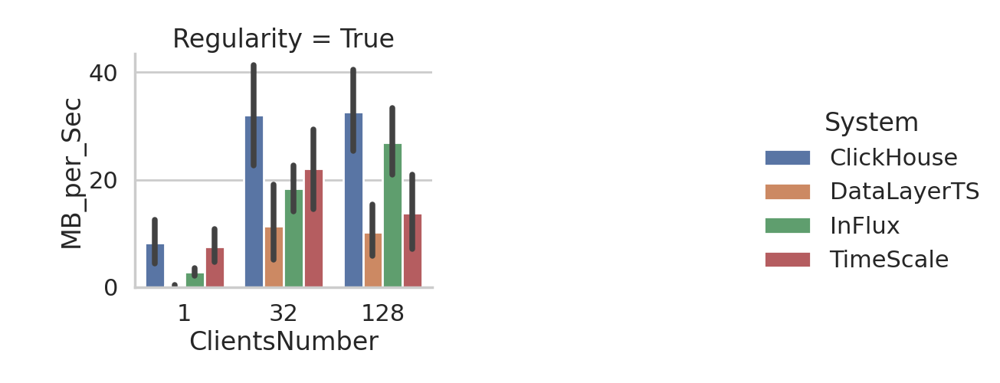

comp ded/mixed WL
ingest


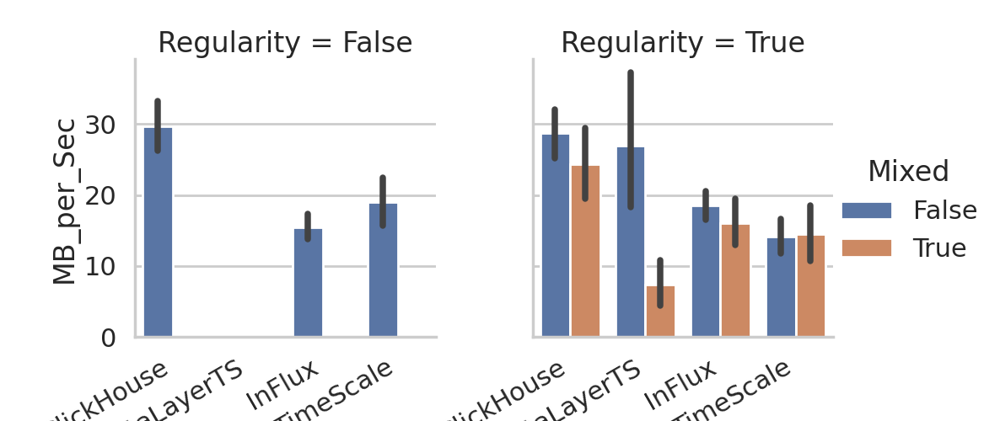

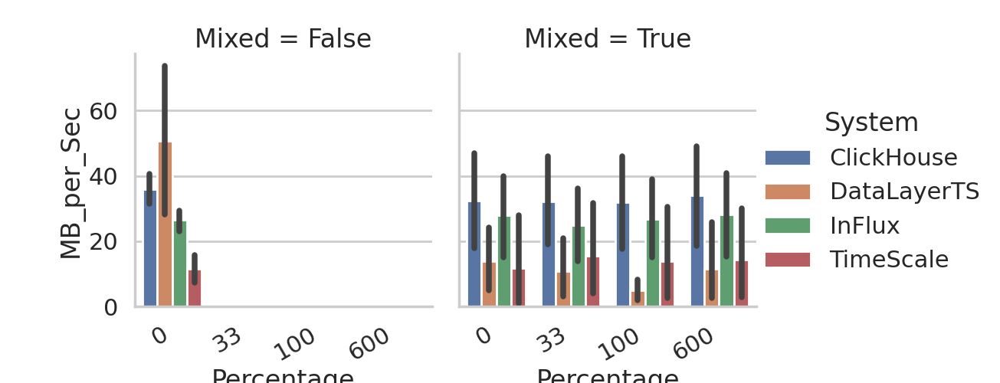

In [ ]:


print("under mixed WL")
sns.catplot(data=mixedWL_ratesI, x="ClientsNumber", y="MB_per_Sec",  hue="System",
            kind="bar", col="Regularity", col_wrap=2, errorbar=("ci", 95), )
plt.yscale('linear')
# plt.title("Comparison: Regular vs Irregular Data Querying based on Number of Clients")

plt.savefig(path+'Mix-I-rates_-080.svg', format='svg', bbox_inches="tight")
plt.show()
plt.close()


print("comp ded/mixed WL")
print("ingest")
sns.catplot(data=results_ratesI, x="System", y="MB_per_Sec",  hue="Mixed",
            kind="bar", col="Regularity", col_wrap=2, errorbar=("ci", 95), )
plt.yscale('linear')
# plt.title("Comparison: Regular vs Irregular Data Querying based on Number of Clients")
plt.gcf().autofmt_xdate()

plt.savefig(path+'Mix-I-rates_DedMix-081.svg',
            format='svg', bbox_inches="tight")
plt.show()
plt.close()


sns.catplot(data=results_ratesI.loc[results_ratesI.ClientsNumber == 128], x="Percentage", y="MB_per_Sec",  hue="System", col="Mixed",
            kind="bar", errorbar=("ci", 95))
plt.yscale('linear')
# plt.title("Comparison: Regular vs Irregular Data Querying based on Number of Clients")
plt.gcf().autofmt_xdate()

plt.savefig(path+'Mix-I-rates_C128_DedMix_Perc-line-082.svg',
            format='svg', bbox_inches="tight")
plt.show()
plt.close()

## Query Attentions: RangeQ.:MixedQueries are Limited, Dedicated are Full

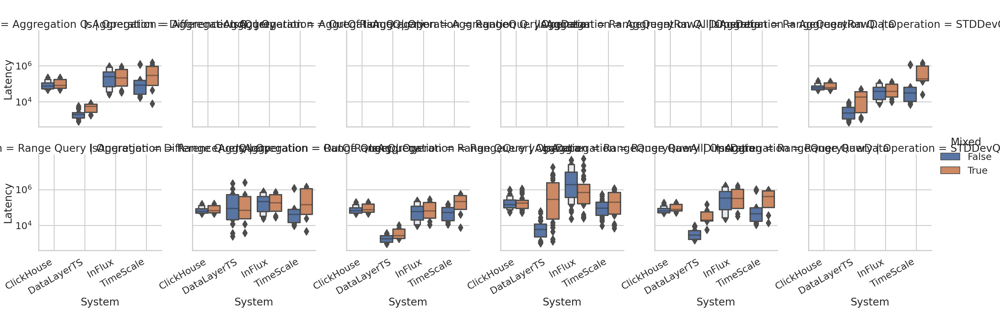

agg


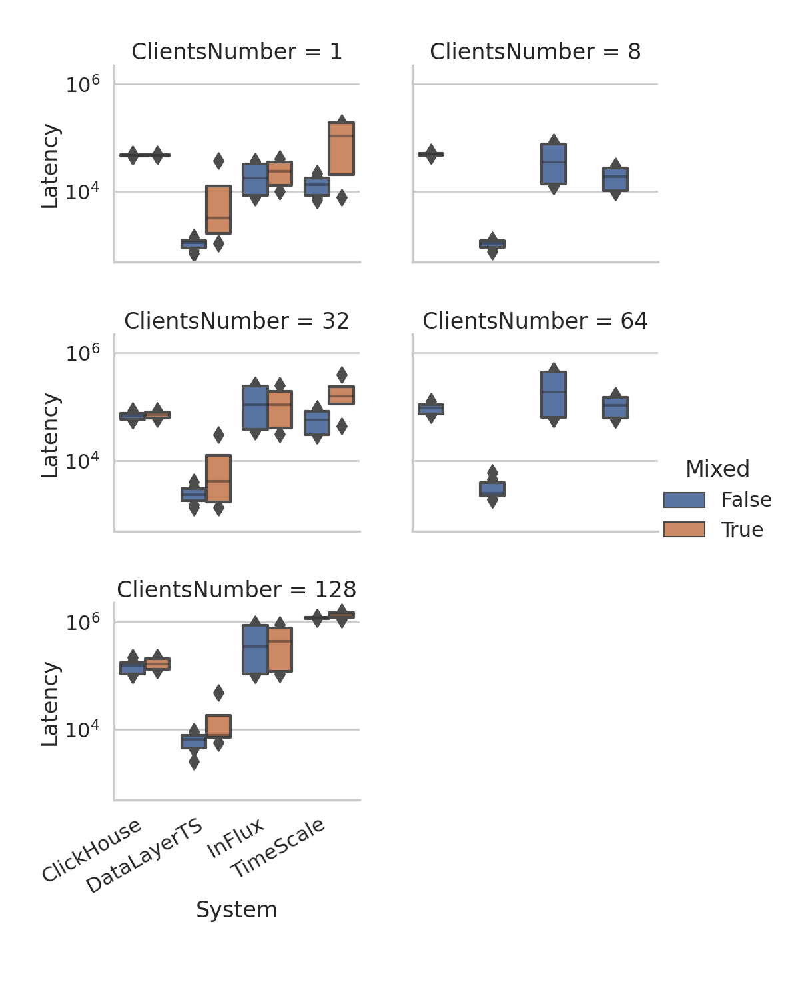

rangFul


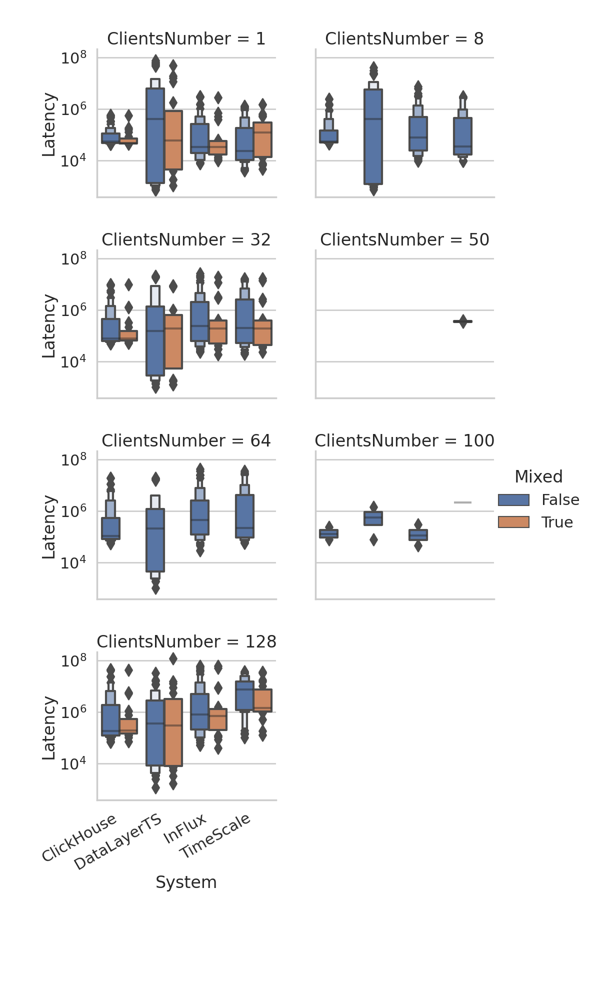

In [ ]:


sns.catplot(data=results_ratesQ, x="System", y="Latency",  hue="Mixed", row="IsAggregation", col="Operation",
            kind="boxen", errorbar=("ci", 95), )
plt.yscale('log')
# plt.title("Comparison: Regular vs Irregular Data Querying based on Number of Clients")
plt.gcf().autofmt_xdate()

plt.savefig(path+'Mix-Q-rates_DedMix-083.svg',
            format='svg', bbox_inches="tight")
plt.show()
plt.close()

print("agg")

sns.catplot(data=results_rates.loc[results_rates.Operation.str.contains('Qu') & (results_rates.Operation.str.contains('Rang') == False)], x="System", y="Latency",  hue="Mixed", col="ClientsNumber", col_wrap=2,
            kind="boxen", errorbar=("pi", 50), )
plt.yscale('log')
plt.gcf().autofmt_xdate()

# plt.title("Comparison: Regular vs Irregular Data Querying based on Number of Clients")
plt.savefig(path+'Mix-Q-rates_DedMix2-084.svg',
            format='svg', bbox_inches="tight")
plt.show()
plt.close()

print("rangFul")


sns.catplot(data=results_rates.loc[results_rates.Mode.str.contains('Limi') == False & (results_rates.Operation.str.contains('Rang') == True)], x="System", y="Latency",  hue="Mixed", col="ClientsNumber", col_wrap=2,
            kind="boxen", errorbar=("pi", 50), )
plt.yscale('log')
plt.gcf().autofmt_xdate()

# plt.title("Comparison: Regular vs Irregular Data Querying based on Number of Clients")
plt.savefig(path+'Mix-Q-rates_DedMix3-085.svg',
            format='svg', bbox_inches="tight")
plt.show()
plt.close()


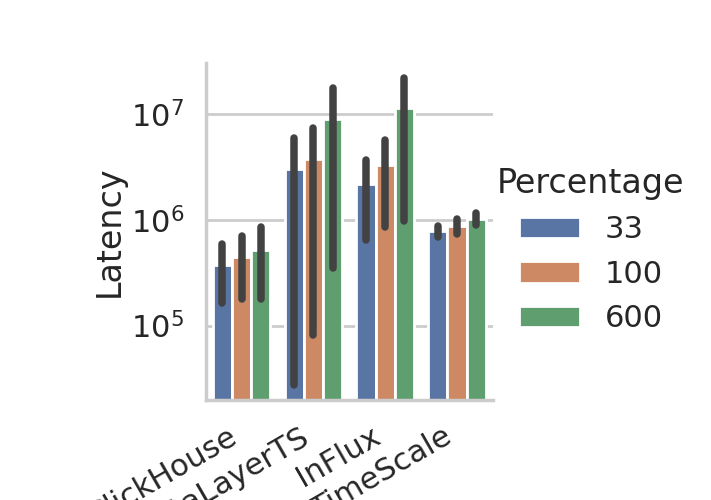

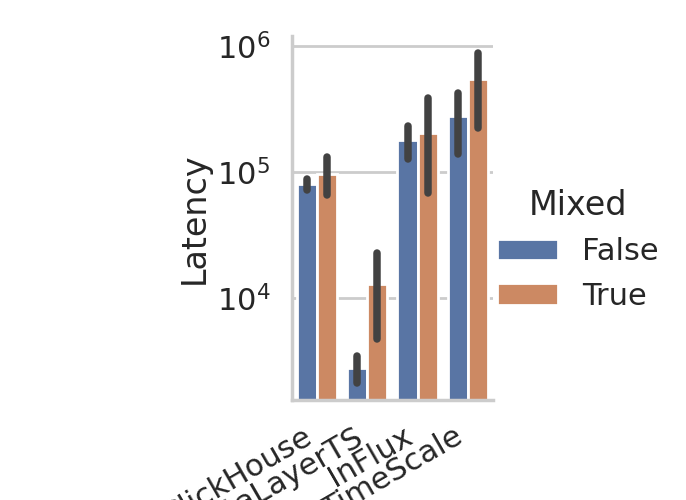

In [ ]:

sns.catplot(data=results_ratesQ.loc[results_ratesQ.Mode.str.contains('Limit') & results_ratesQ.ClientsNumber.isin([128])], x="System", y="Latency",  hue="Percentage",
            kind="bar", errorbar=("ci", 95), )
plt.yscale('log')
plt.gcf().autofmt_xdate()

# plt.title("Comparison: Regular vs Irregular Data Querying based on Number of Clients")
plt.savefig(path+'Mix-Q-rates_C128_DedMix_perc-086.svg',
            format='svg', bbox_inches="tight")
plt.show()
plt.close()


sns.catplot(data=results_ratesQ.loc[results_ratesQ.Operation.str.contains("Range") == False & results_ratesQ.ClientsNumber.isin([128])], x="System", y="Latency",  hue="Mixed",
            kind="bar", errorbar=("ci", 95), )
plt.yscale('linear')
plt.gcf().autofmt_xdate()

# plt.title("Comparison: Regular vs Irregular Data Querying based on Number of Clients")
plt.savefig(path+'Mix-Q-AGG_C128_DedMix-086,1.svg',
            format='svg', bbox_inches="tight")
plt.show()
plt.close()

## System Metrics

Agg


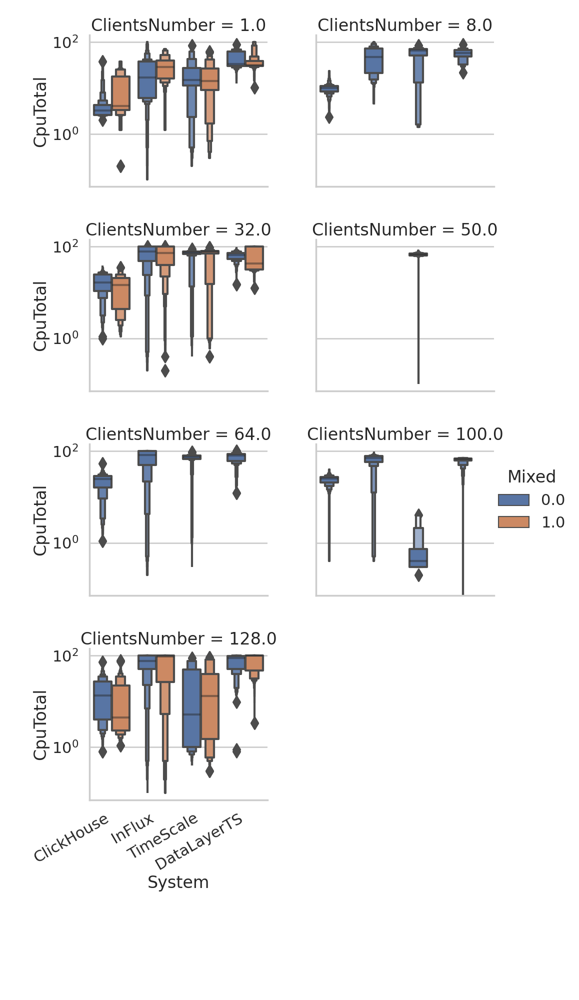

RangFull


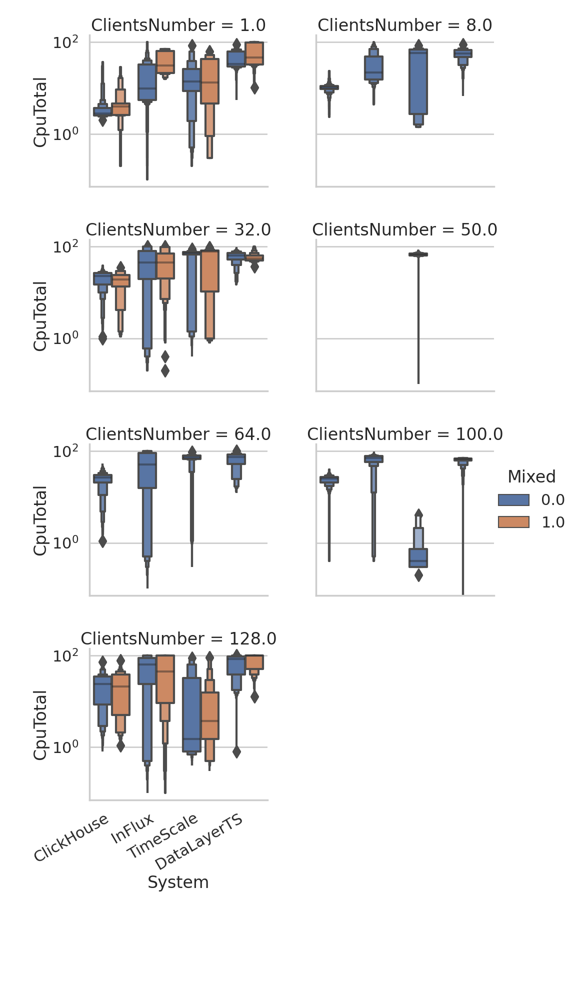

ingestion


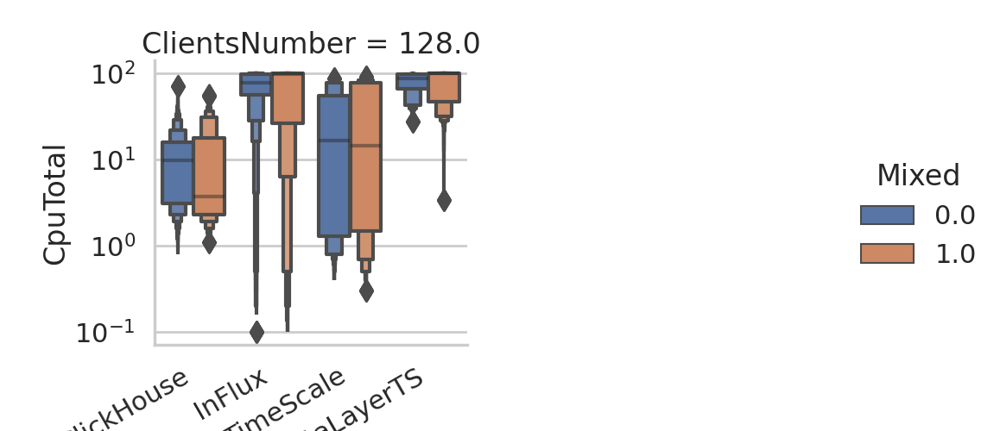

In [102]:
# ok
#
#



print("Agg")
sns.catplot(data=systemmetrics_rates.loc[systemmetrics_rates.Operation.str.contains('Que') & systemmetrics_rates.Operation.str.contains('Rang') == False], x="System", y="CpuTotal",  hue="Mixed",
            kind="boxen", col="ClientsNumber", col_wrap=2,  )
plt.yscale('log')
plt.gcf().autofmt_xdate()

# plt.title("Comparison: Regular vs Irregular Data Querying based on Number of Clients")
plt.savefig(path+'Mix-Q-AGG-sys-rates_DedMix-088.svg',
            format='svg', bbox_inches="tight")
plt.show()
plt.close()
print("RangFull")
sns.catplot(data=systemmetrics_rates.loc[systemmetrics_rates.Mode.str.contains('Limi') == False & systemmetrics_rates.Operation.str.contains('Rang')], x="System", y="CpuTotal",  hue="Mixed",
            kind="boxen", col="ClientsNumber", col_wrap=2,  )
plt.yscale('log')
plt.gcf().autofmt_xdate()

# plt.title("Comparison: Regular vs Irregular Data Querying based on Number of Clients")
plt.savefig(path+'Mix-Q-Range-sys-rates_DedMix-089.svg',
            format='svg', bbox_inches="tight")
plt.show()
plt.close()

print("ingestion")
sns.catplot(data=systemmetrics_rates.loc[systemmetrics_rates.Operation.str.contains('Ing') & systemmetrics_rates.ClientsNumber.isin([128])], x="System", y="CpuTotal",  hue="Mixed",
            kind="boxen", col="ClientsNumber", col_wrap=2, )
plt.yscale('log')
plt.gcf().autofmt_xdate()

# plt.title("Comparison: Regular vs Irregular Data Querying based on Number of Clients")
plt.savefig(path+'Mix-I-sys-rates_C128_DedMix-090.svg',
            format='svg', bbox_inches="tight")
plt.show()
plt.close()

ing


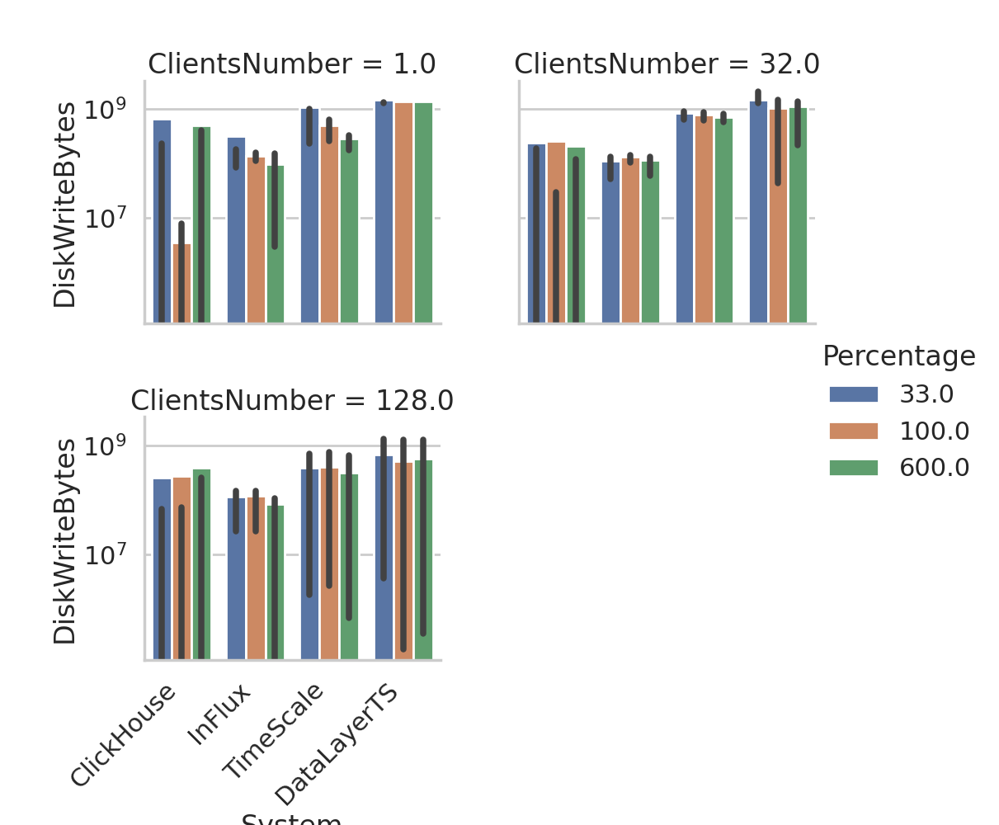

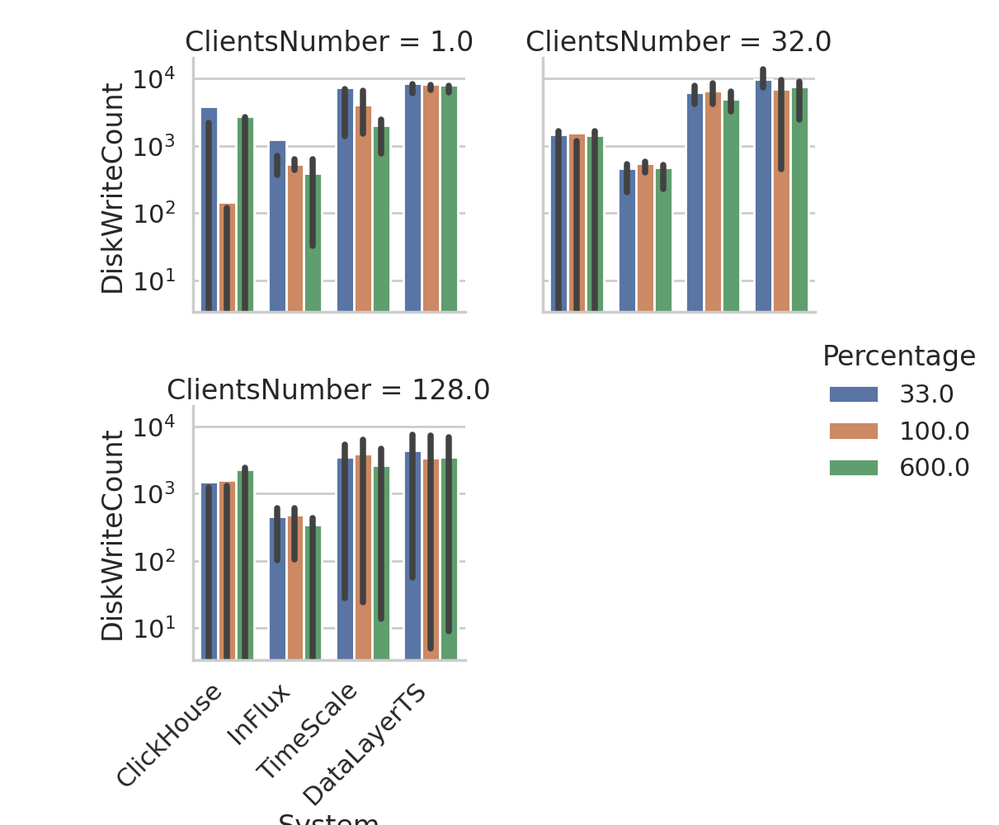

que


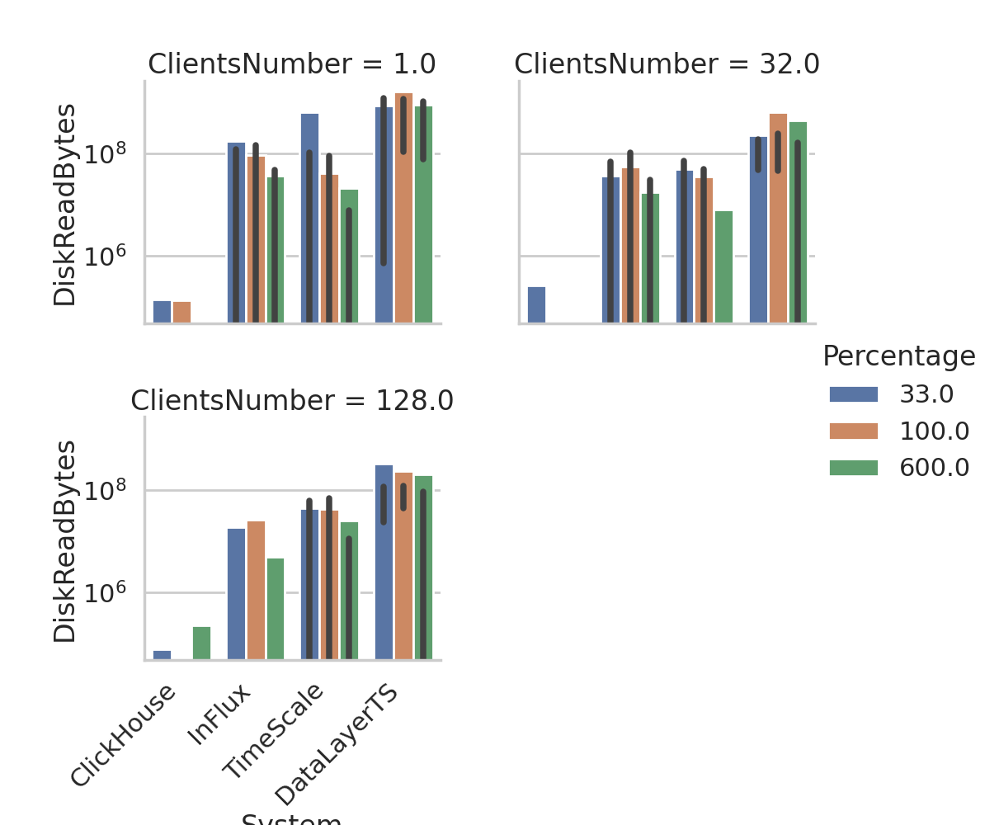

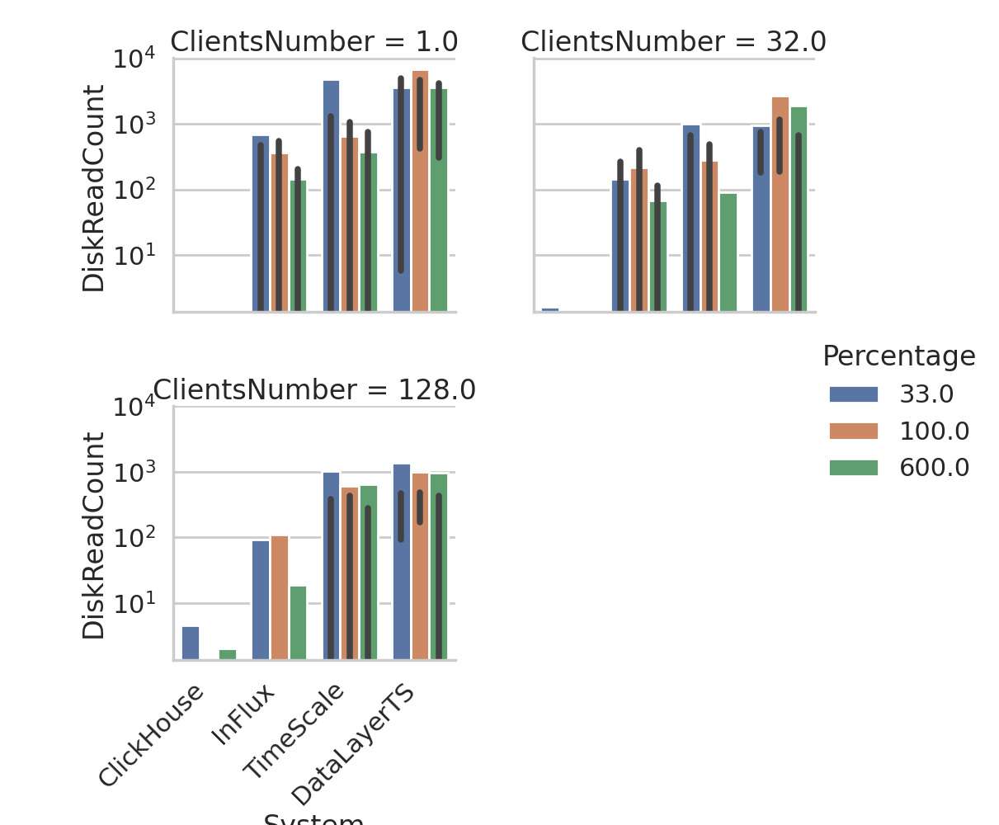

ValueError: Number of rows must be a positive integer, not 0

SystemError: tile cannot extend outside image

Canvas(toolbar=Toolbar(toolitems=[('Home', 'Reset original view', 'home', 'home'), ('Back', 'Back to previous view', 'arrow-left', 'back'), ('Forward', 'Forward to next view', 'arrow-right', 'forward'), ('Pan', 'Left button pans, Right button zooms\nx/y fixes axis, CTRL fixes aspect', 'arrows', 'pan'), ('Zoom', 'Zoom to rectangle\nx/y fixes axis', 'square-o', 'zoom'), ('Download', 'Download plot', 'floppy-o', 'save_figure')]))

SystemError: tile cannot extend outside image

In [22]:
print("ing")
sns.catplot(data=systemmetrics.loc[systemmetrics.Mode.str.contains('Limit') & systemmetrics.Operation.str.contains("Ing")], x="System", y="DiskWriteBytes",  hue="Percentage",
            kind="bar", col="ClientsNumber", col_wrap=2, errorbar=("pi", 50), )
plt.yscale('log')
plt.gcf().autofmt_xdate(rotation=45)# plt.title("Comparison: Regular vs Irregular Data Querying based on Number of Clients")
plt.savefig(path+'Mix-I-sysDiskWrites-rates_DedMix_perc-091.svg',
            format='svg', bbox_inches="tight")
plt.show()
plt.close()

sns.catplot(data=systemmetrics.loc[systemmetrics.Mode.str.contains('Limit') & systemmetrics.Operation.str.contains("Ing")], x="System", y="DiskWriteCount",  hue="Percentage",
            kind="bar", col="ClientsNumber", col_wrap=2, errorbar=("pi", 50), )
plt.yscale('log')
plt.gcf().autofmt_xdate(rotation=45)# plt.title("Comparison: Regular vs Irregular Data Querying based on Number of Clients")
plt.savefig(path+'Mix-I-sysDiskCount-rates_DedMix_perc-092.svg',
            format='svg', bbox_inches="tight")
plt.show()
plt.close()
print("que")
sns.catplot(data=systemmetrics.loc[systemmetrics.Mode.str.contains('Limit') & systemmetrics.Operation.str.contains("Q")], x="System", y="DiskReadBytes",  hue="Percentage",
            kind="bar", col="ClientsNumber", col_wrap=2, errorbar=("pi", 50), )
plt.yscale('log')
plt.gcf().autofmt_xdate(rotation=45)
# plt.title("Comparison: Regular vs Irregular Data Querying based on Number of Clients")
plt.savefig(path+'Mix-Q-sysDiskReads-rates_DedMix_perc-093.svg',
            format='svg', bbox_inches="tight")
plt.show()
plt.close()

sns.catplot(data=systemmetrics.loc[systemmetrics.Mode.str.contains('Limit') & systemmetrics.Operation.str.contains("Q")], x="System", y="DiskReadCount",  hue="Percentage",
            kind="bar", col="ClientsNumber", col_wrap=2, errorbar=("pi", 50), )
plt.yscale('log')
plt.gcf().autofmt_xdate(rotation=45)
# plt.title("Comparison: Regular vs Irregular Data Querying based on Number of Clients")
plt.savefig(path+'Mix-Q-sysDiskCount-rates_DedMix_perc-094.svg',
            format='svg', bbox_inches="tight")
plt.show()
plt.close()


sns.catplot(data=systemmetrics.loc[systemmetrics.Operation.str.contains('Que') & systemmetrics.ClientsNumber.isin([128])], x="System", y="CpuTotal",  hue="Mixed",
            kind="bar", col="IsAggregation", col_wrap=2,  )
plt.yscale('log')
plt.gcf().autofmt_xdate(rotation=45)

# plt.title("Comparison: Regular vs Irregular Data Querying based on Number of Clients")
plt.savefig(path+'Mix-Q-sys-rates_C128_DedMix-087.svg',
            format='svg', bbox_inches="tight")
plt.show()
plt.close()

# 
#
#
#
#


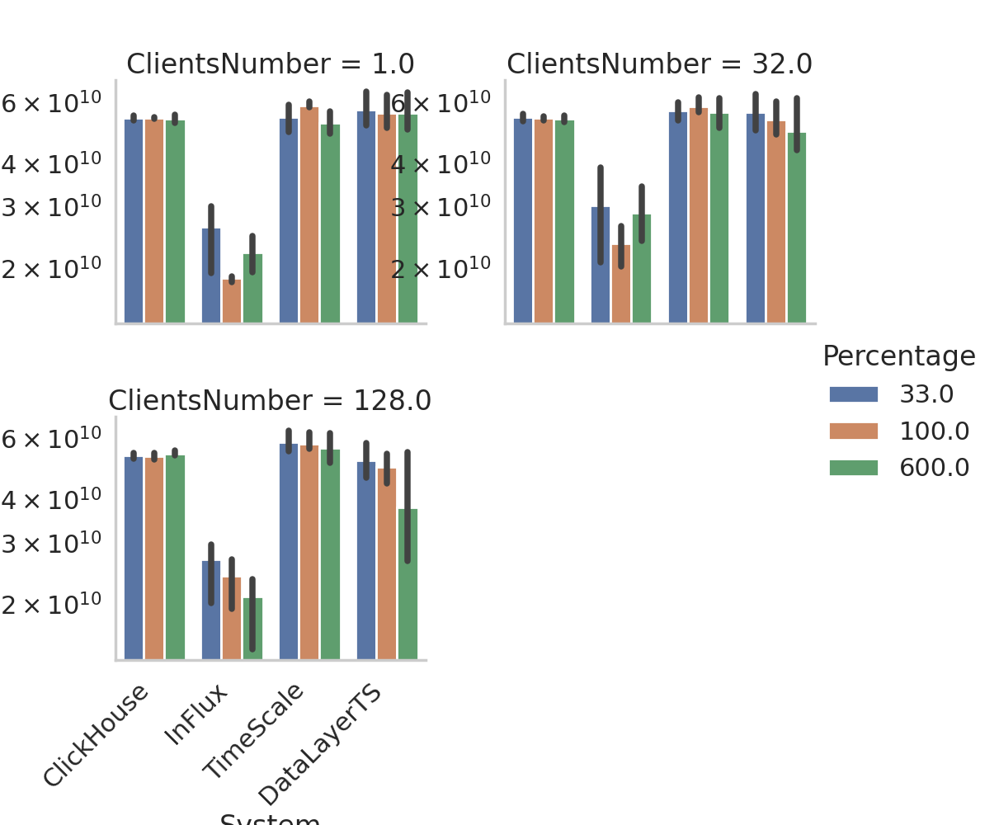

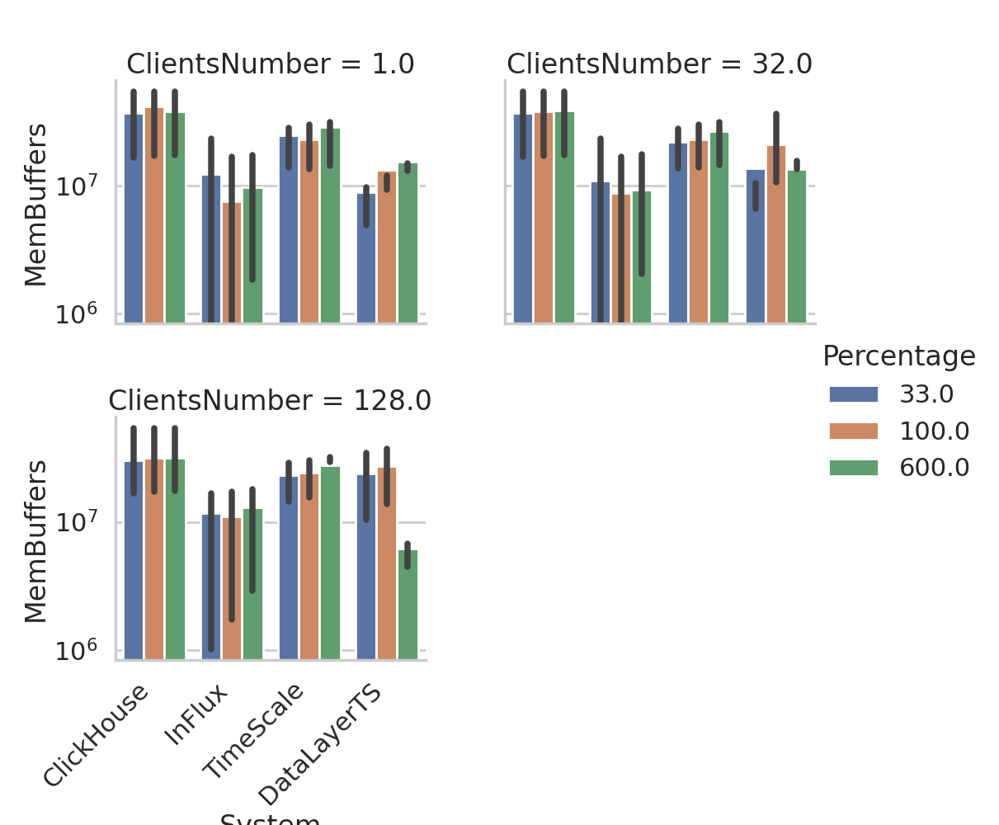

RangeFul


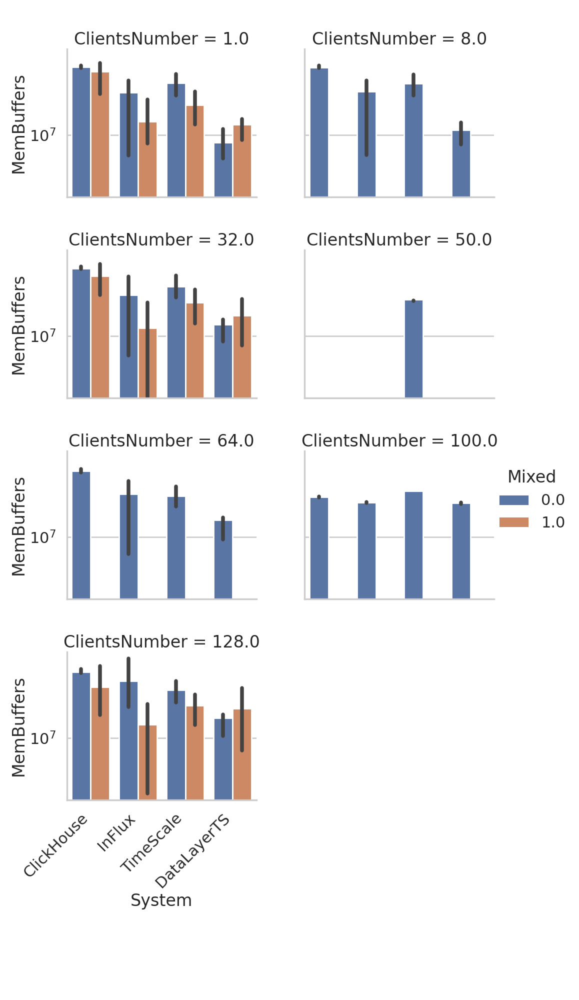

agg


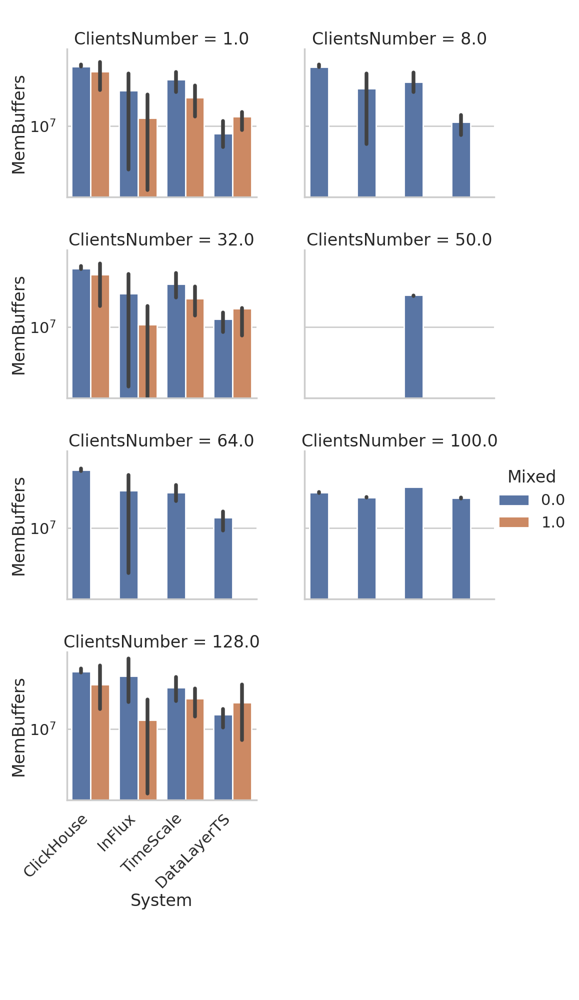

ValueError: Number of rows must be a positive integer, not 0

SystemError: tile cannot extend outside image

Canvas(toolbar=Toolbar(toolitems=[('Home', 'Reset original view', 'home', 'home'), ('Back', 'Back to previous view', 'arrow-left', 'back'), ('Forward', 'Forward to next view', 'arrow-right', 'forward'), ('Pan', 'Left button pans, Right button zooms\nx/y fixes axis, CTRL fixes aspect', 'arrows', 'pan'), ('Zoom', 'Zoom to rectangle\nx/y fixes axis', 'square-o', 'zoom'), ('Download', 'Download plot', 'floppy-o', 'save_figure')]))

SystemError: tile cannot extend outside image

In [20]:

sns.catplot(data=systemmetrics.loc[systemmetrics.Mode.str.contains('Limit')], x="System", y="MemCached",  hue="Percentage",
            kind="bar", col="ClientsNumber", col_wrap=2, errorbar=("pi", 50), )
plt.yscale('log')
plt.gcf().autofmt_xdate(rotation=45)# plt.title("Comparison: Regular vs Irregular Data Querying based on Number of Clients")
plt.savefig(path+'Mix-Q-sysMemCache-rates_DedMix_perc-095.svg',
            format='svg', bbox_inches="tight")
plt.show()
plt.close()
sns.catplot(data=systemmetrics.loc[systemmetrics.Mode.str.contains('Limit')], x="System", y="MemBuffers",  hue="Percentage",
            kind="bar", col="ClientsNumber", col_wrap=2, errorbar=("pi", 50), )
plt.yscale('log')
# plt.title("Comparison: Regular vs Irregular Data Querying based on Number of Clients")
plt.gcf().autofmt_xdate(rotation=45)

plt.savefig(path+'Mix-Q-sysMemTotal-rates_DedMix_perc-096.svg',
            format='svg', bbox_inches="tight")
plt.show()
plt.close()
print("RangeFul")
sns.catplot(data=systemmetrics.loc[systemmetrics.Operation.str.contains('Ran') & systemmetrics.Mode.str.contains('Lim') == False], x="System", y="MemBuffers",  hue="Mixed",
            kind="bar", col="ClientsNumber", col_wrap=2, errorbar=("pi", 50), )
plt.yscale('log')
# plt.title("Comparison: Regular vs Irregular Data Querying based on Number of Clients")
plt.gcf().autofmt_xdate(rotation=45)

plt.savefig(path+'Mix-Q-sysMemTotal-rates_DedMix_CN-097.svg',
            format='svg', bbox_inches="tight")
plt.show()
plt.close()
print("agg")
sns.catplot(data=systemmetrics.loc[systemmetrics.Operation.str.contains('Qu') & systemmetrics.Operation.str.contains('Rang') == False], x="System", y="MemBuffers",  hue="Mixed",
            kind="bar", col="ClientsNumber", col_wrap=2, errorbar=("pi", 50), )
plt.yscale('log')
# plt.title("Comparison: Regular vs Irregular Data Querying based on Number of Clients")
plt.gcf().autofmt_xdate(rotation=45)

plt.savefig(path+'Mix-Q-sysMemTotal-rates_DedMix_CN-098.svg',
            format='svg', bbox_inches="tight")
plt.show()
plt.close()


sns.catplot(data=systemmetrics.loc[systemmetrics.Operation.str.contains('Q') & systemmetrics.Mode.str.contains('mix') & systemmetrics.ClientsNumber.isin([128])], x="System", y="MemBuffers",  hue="Mixed",
            kind="bar",   col_wrap=2, errorbar=("pi", 95), )
plt.yscale('log')
# plt.title("Comparison: Regular vs Irregular Data Querying based on Number of Clients")
plt.gcf().autofmt_xdate(rotation=45)

plt.savefig(path+'Mix-Q-sysMemBuff-rates_C128__DedMix-098,1.svg',
            format='svg', bbox_inches="tight")
plt.show()
plt.close()

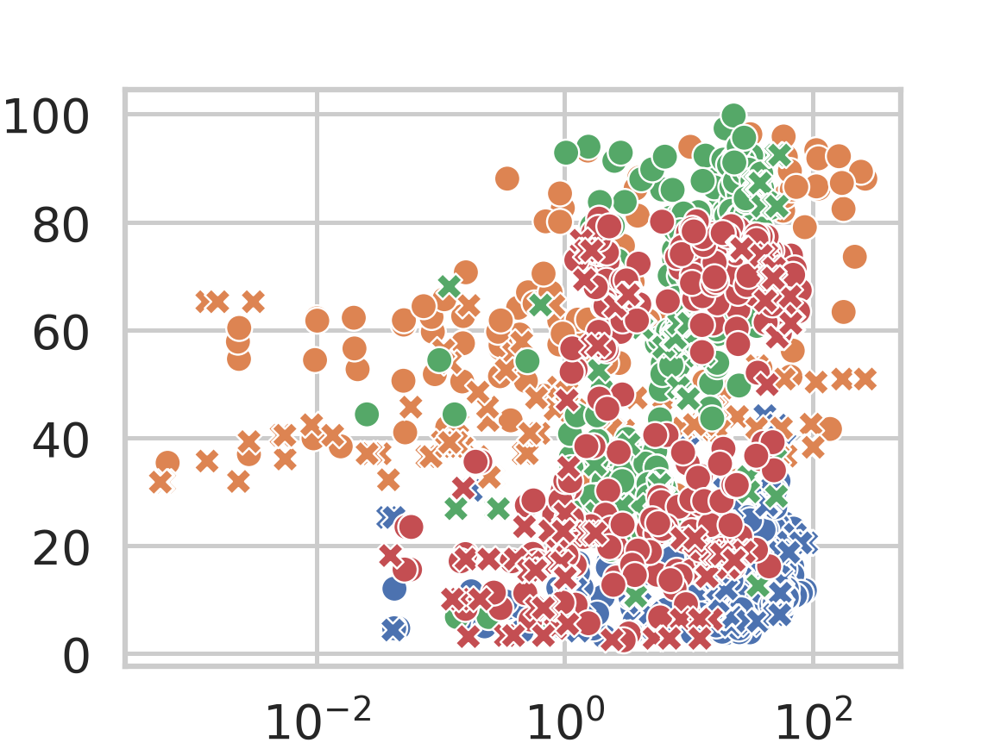

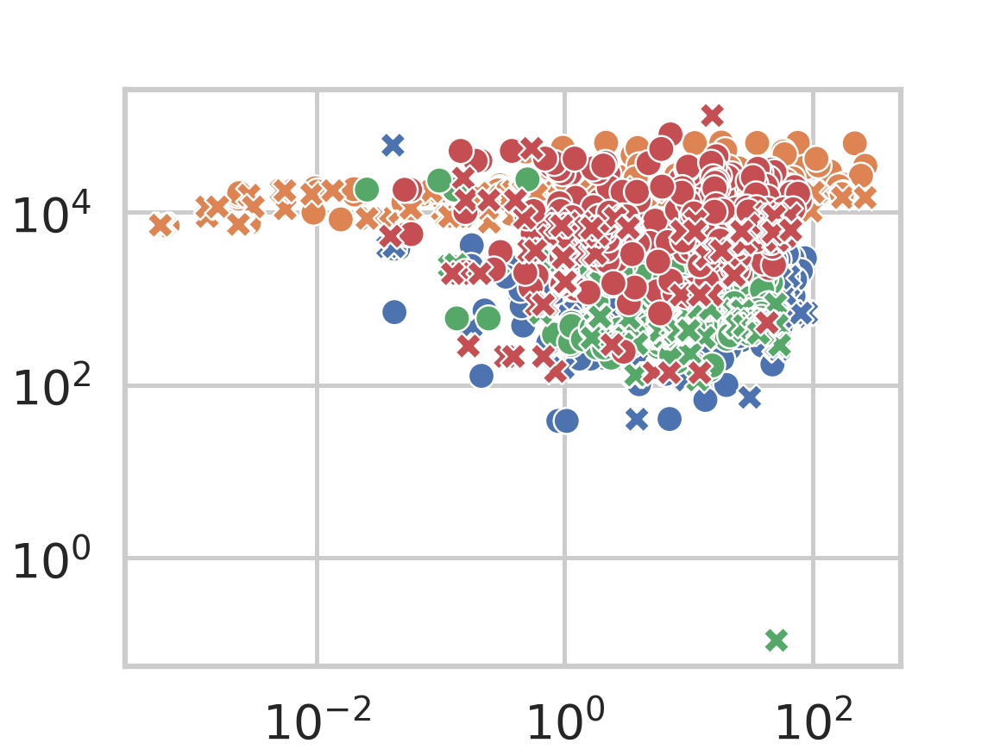

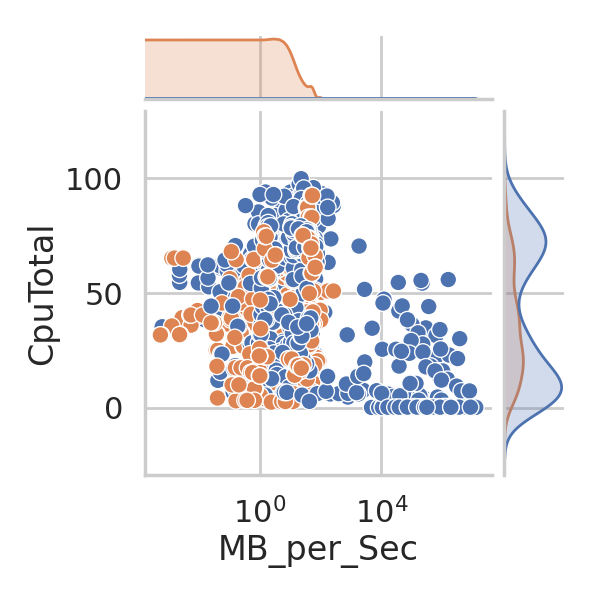

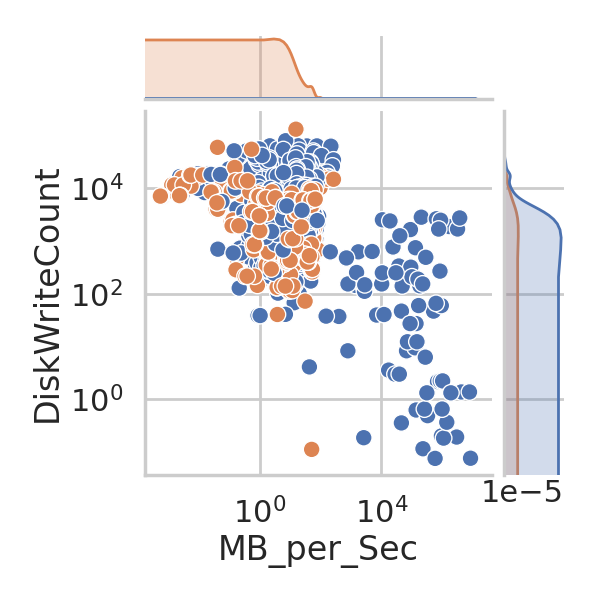

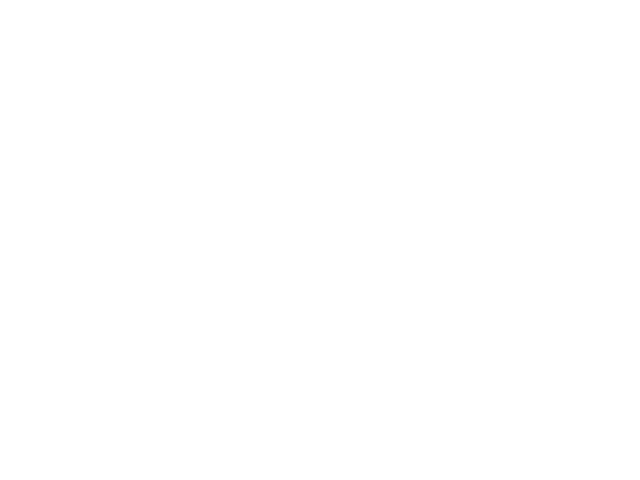

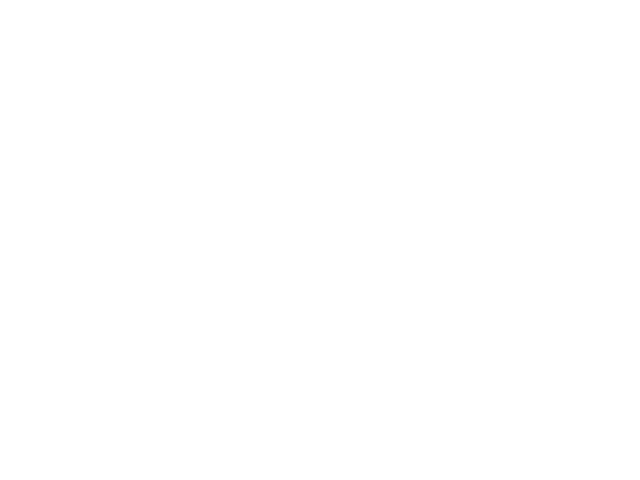

In [ ]:
plt.figure("CPU-vs-Bandwidth-Pair")
# plt.title("CPU-vs-Bandwidth-Pair")
sns.scatterplot(Combinded_ingestion, x="MB_per_Sec",
                y="CpuTotal", hue="System", style="Mixed")
plt.xscale("log")
plt.legend(loc='center right', bbox_to_anchor=(1.855, 0.5))

plt.savefig(path+'MixI-CPU-vs-Bandwidth_Pair-099.svg',
            format='svg', bbox_inches="tight")
plt.show()
plt.close()


plt.figure("DiskIO-vs-Bandwidth")
# plt.title("DiskIO-vs-Bandwidth")
sns.scatterplot(Combinded_ingestion, x="MB_per_Sec",
                y="DiskWriteCount", hue="System", style="Mixed")
plt.xscale("log")
plt.yscale("log")
plt.legend(loc='center right', bbox_to_anchor=(1.855, 0.5))

plt.savefig(path+'MixI-DiskIO-vs-Bandwidth-scatter-100.svg',
            format='svg', bbox_inches="tight")
plt.show()
plt.close()


plt.figure("CPU-vs-Bandwidth-Pair")
# plt.title("CPU-vs-Bandwidth-Pair")
sns.jointplot(Combinded_ingestion, x="MB_per_Sec", y="CpuTotal", hue="Mixed")
plt.xscale("log")
plt.legend(loc='center right', bbox_to_anchor=(1.9, 0.5))

plt.savefig(path+'MIxI-joint-CPU-vs-Bandwidth_Pair-101.svg',
            format='svg', bbox_inches="tight")
plt.show()
plt.close()


plt.figure("DiskIO-vs-Bandwidth")
# plt.title("DiskIO-vs-Bandwidth")
sns.jointplot(Combinded_ingestion, x="MB_per_Sec",
              y="DiskWriteCount", hue="Mixed")
plt.xscale("log")
plt.yscale("log")
plt.legend(loc='center right', bbox_to_anchor=(1.9, 0.5))

plt.savefig(path+'MixI-joint-DiskIO-vs-Bandwidth-102.svg',
            format='svg', bbox_inches="tight")
plt.show()
plt.close()

# Queries 


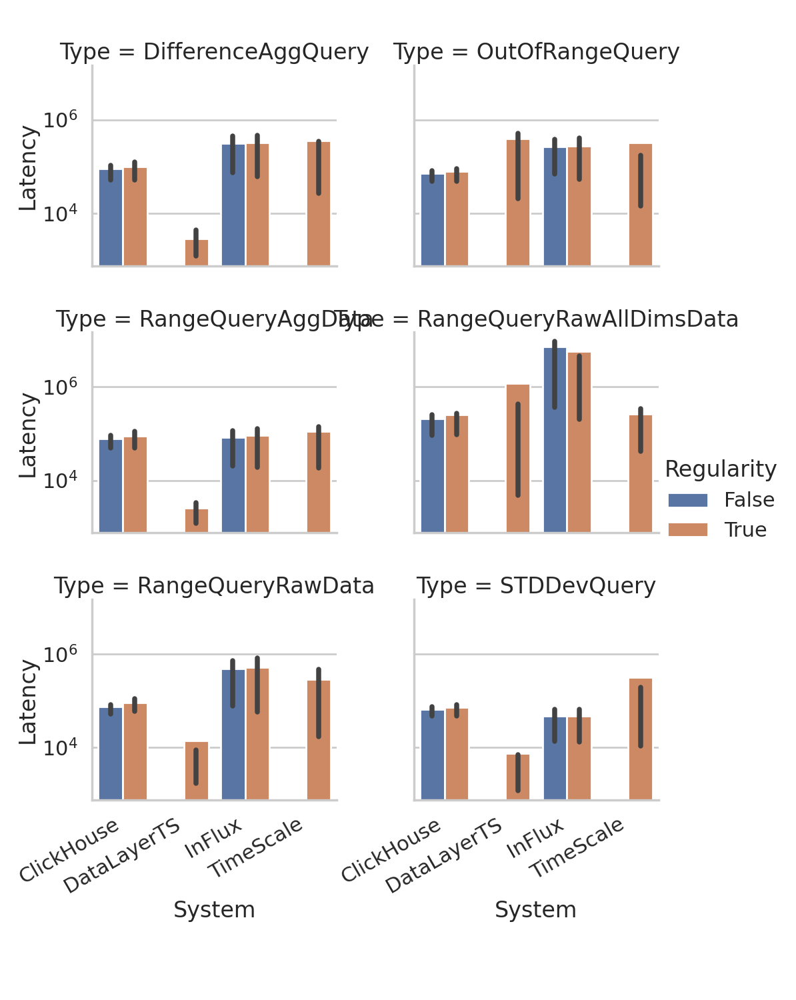

In [23]:

sns.catplot(data=results_ratesQ.rename(columns={"Operation": "Type"}), x="System", y="Latency",  hue="Regularity",
            kind="bar", col="Type", col_wrap=2, errorbar=("pi", 50))
plt.yscale('log')
plt.gcf().autofmt_xdate()
plt.savefig(path+'!Q_rates_regularity-Latency-Operation-103.svg',
            format='svg', bbox_inches="tight")
plt.show()
plt.close()

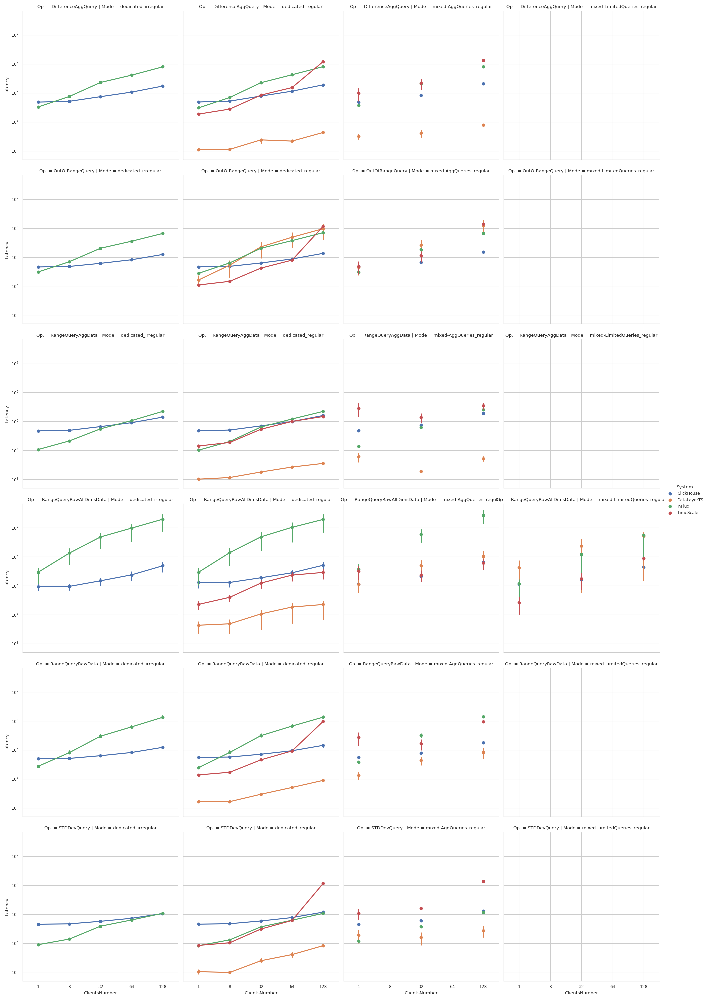

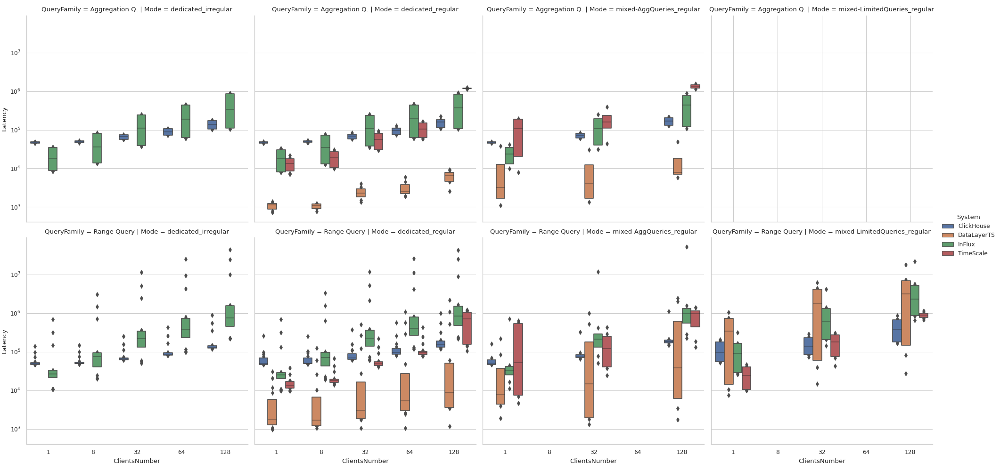

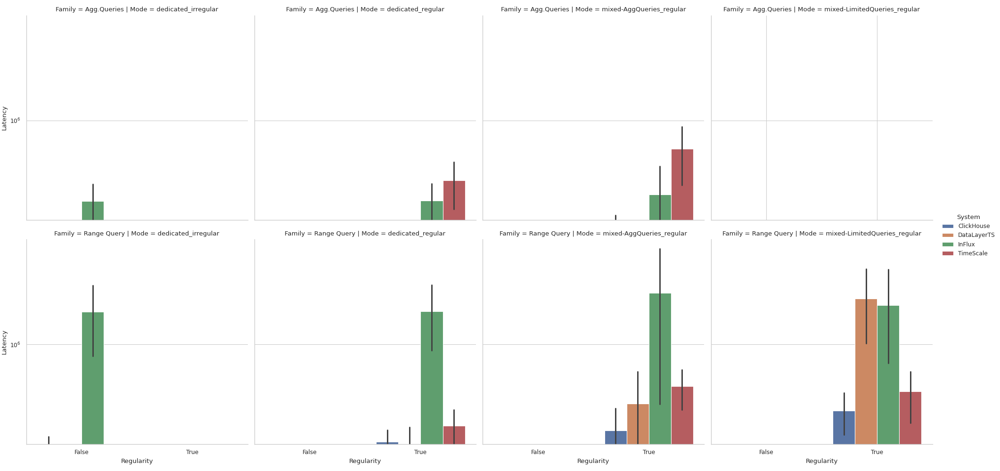

ValueError: min() arg is an empty sequence

In [25]:
sns.set_context("paper")

# #Batchsize

sns.catplot(data=results_ratesQ.rename(columns={"Operation": "Op."}), x="ClientsNumber", y="Latency",  hue="System",
            kind="point", row="Op.",  errorbar=("pi", 50), col="Mode")
plt.yscale('log')
# plt.title("Comparison: Regular vs Irregular Data Querying based on Number of Clients")
plt.savefig(path+'Q_rates_reg-All-CN-104.svg',
            format='svg', bbox_inches="tight")
plt.show()
plt.close()


sns.catplot(data=results_ratesQ.rename(columns={"IsAggregation": "QueryFamily"}), x="ClientsNumber", y="Latency",  hue="System",
            kind="boxen", row="QueryFamily",   errorbar=("pi", 50), col="Mode")
plt.yscale('log')
# plt.title("Comparison: Regular vs Irregular Data Querying based on Number of Clients")
plt.savefig(path+'Q_rates_reg-AggIO-CN-105.svg',
            format='svg', bbox_inches="tight")
plt.show()
plt.close()


sns.set_context("poster")
# sns.set_theme("whitegrid")

sns.catplot(data=results_ratesQ_Ded.rename(columns={"IsAggregation": "Family"}).replace({"Aggregation Q.": "Agg.Queries"}), x="System", y="Latency",  hue="Regularity",
            kind="bar",     errorbar=("ci", 95), col="Family")
plt.yscale('log')
# plt.title("Comparison: Regular vs Irregular Data Querying based on Number of Clients")
plt.savefig(path+'!Qded-ratesReg-AggIO-ReG-bar-106.svg',
            format='svg', bbox_inches="tight")
plt.show()
plt.close()


 



sns.catplot(data=results_ratesQ.rename(columns={"IsAggregation": "Query_Type"}).replace({"Aggregation Q.": "Agg.Queries"}).assign(Mode_and_System=lambda x: x.Regularity.map({"True": "regular", "False": "irregular"})+" TS: " + x.System), x="Query_Type", y="Latency",  hue="Mode_and_System",
            kind="bar",  errorbar=("ci", 95))
plt.yscale('log')
# plt.title("Comparison: Regular vs Irregular Data Querying based on Number of Clients")
plt.savefig(path+'!QratesReg-AggIO-ReG-bar-106,1.svg',
            format='svg', bbox_inches="tight")
plt.show()
plt.close()

            System                 Mode           Operation  ClientsNumber  \
0       ClickHouse  dedicated_irregular  DifferenceAggQuery              1   
1       ClickHouse  dedicated_irregular  DifferenceAggQuery              1   
2       ClickHouse  dedicated_irregular  DifferenceAggQuery              1   
3       ClickHouse  dedicated_irregular  DifferenceAggQuery              1   
4       ClickHouse  dedicated_irregular  DifferenceAggQuery              1   
...            ...                  ...                 ...            ...   
142917   TimeScale    dedicated_regular         STDDevQuery            128   
142918   TimeScale    dedicated_regular         STDDevQuery            128   
142919   TimeScale    dedicated_regular         STDDevQuery            128   
142920   TimeScale    dedicated_regular         STDDevQuery            128   
142921   TimeScale    dedicated_regular         STDDevQuery            128   

        BatchSize_x  Amount_of_Values  Mixed_x  Percentage_x Pa

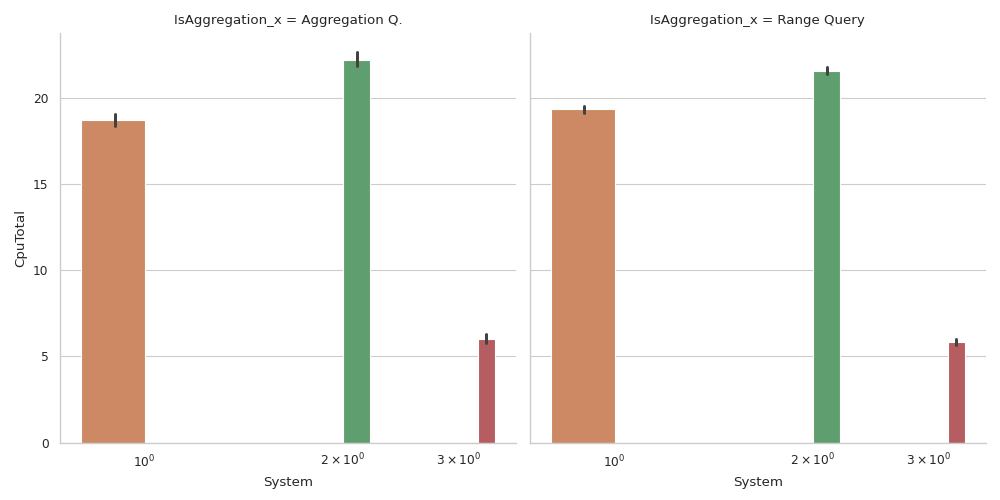

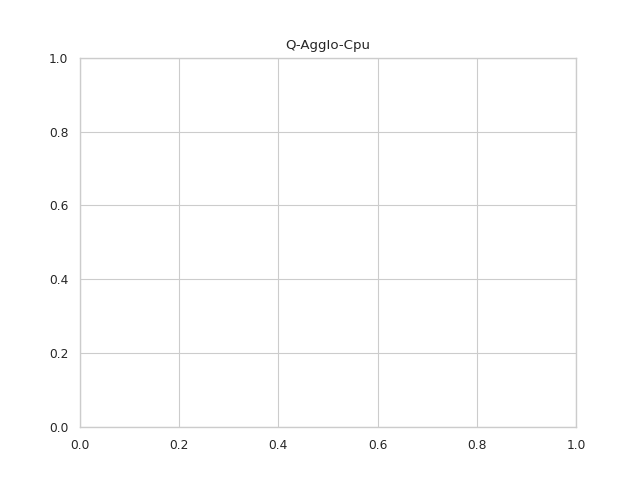

In [26]:
# print(resultQueries)


print(combinedQ_DED)
plt.figure("Q-AggIo-Cpu")
plt.title("Q-AggIo-Cpu")
sns.catplot(combinedQ_DED, x="System", y="CpuTotal", col="IsAggregation_x", kind="bar",
            hue="System",)
plt.xscale("log")
plt.legend(loc='center right', bbox_to_anchor=(1.9, 0.5))

plt.savefig(path+'Q_rates-AggIo-Cpu-107.svg',
            format='svg', bbox_inches="tight")
plt.show()
plt.close()

In [30]:
# latency


show_query_stat('RangeQueryRawData', results)
show_query_stat('RangeQueryRawAllDimsData', results)

In [32]:
show_query_stat('OutOfRangeQuery', results)

In [33]:
show_query_stat('STDDevQuery', results)

In [34]:
show_query_stat('RangeQueryAggData', results)

In [35]:
show_query_stat('DifferenceAggQuery', results)

## Multidim Query stats

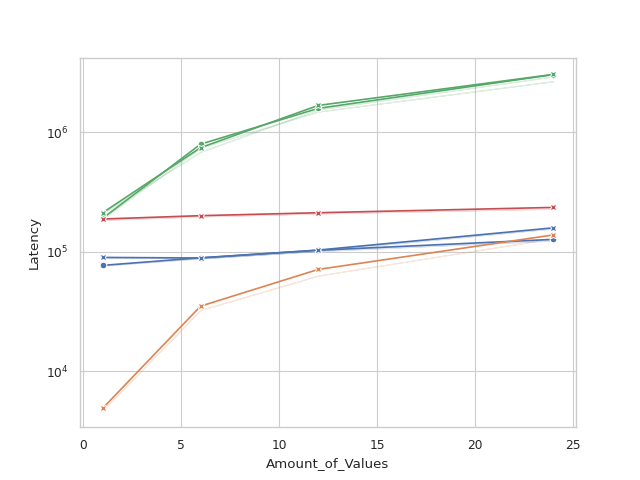

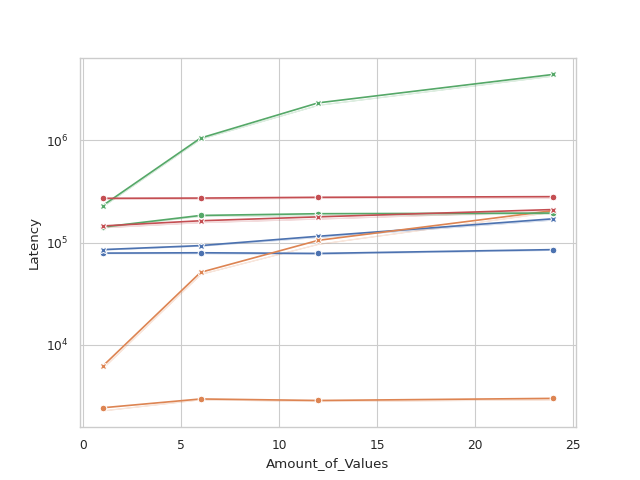

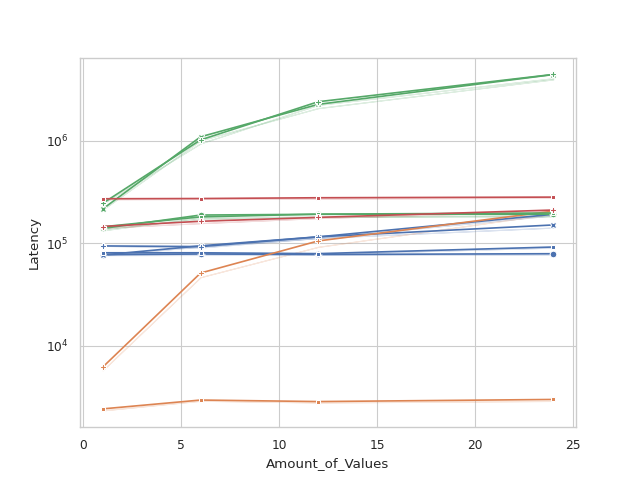

In [36]:

plt.figure("Q-Dim-Mode")
# plt.title("Latency across various Amount_of_Values and Modes")

sns.lineplot(data=results_ratesQ_Ded, x="Amount_of_Values", y="Latency",  errorbar=("ci", 0.001),
             hue="System", style="Mode", markers=True, dashes=False)
plt.yscale('log')
plt.legend(loc='center right', bbox_to_anchor=(1.865, 0.5))

plt.savefig(path+'Q-Dim-Reg-108.svg', format='svg', bbox_inches="tight")  # svg
plt.show()
plt.close()


plt.figure("Q-Dim-Mode")
sns.set_context("poster")
sns.lineplot(data=results_ratesQ_Ded, x="Amount_of_Values", y="Latency", errorbar=("ci", 0.01),
             hue="System", style="IsAggregation", markers=True, dashes=False)
plt.yscale('log')
plt.legend(loc='center right', bbox_to_anchor=(1.856, 0.5))

plt.savefig(path+'!Q-Dim-Agg-109.svg', format='svg',
            bbox_inches="tight")  # svg
plt.show()
plt.close()

result_ratesQ_Ded_RegAgg = results_ratesQ_Ded.assign(RegAgg=lambda x: "Reg: "+x.Regularity.replace(
    {True: 'True', False: 'False'}) + ", Agg: " + x.IsAggregation.replace({True: 'True', False: 'False'}))

plt.figure("Q-Dim-Mode")
# plt.title("Latency across various Amount_of_Values and Modes")

sns.lineplot(data=result_ratesQ_Ded_RegAgg, x="Amount_of_Values", errorbar=("ci", 0.001),
             y="Latency", hue="System", style="RegAgg", markers=True, dashes=False)
plt.yscale('log')
plt.legend(loc='center right', bbox_to_anchor=(2.251, 0.5))

plt.savefig(path+'Q-Dim-Reg-Agg-110.svg',
            format='svg', bbox_inches="tight")  # svg
plt.show()
plt.close()

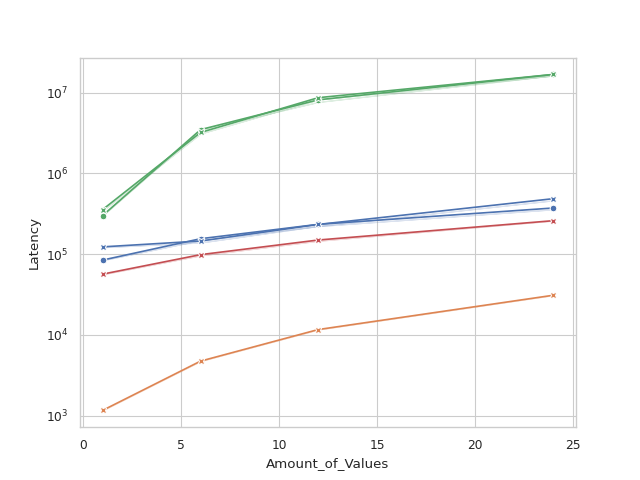

In [37]:


plt.figure("Q-Dim-Op-A")
# plt.title("Latency across various Amount_of_Values for RangeQueryAllDims")

sns.lineplot(data=results_ratesQ_Ded.loc[results_ratesQ_Ded['Operation'].str.contains(
    'RangeQueryRawAllDimsData')], x="Amount_of_Values", y="Latency", hue="System", style="Mode", errorbar=("ci", 0.001), markers=True, dashes=False)
plt.yscale('log')
plt.legend(loc='center right', bbox_to_anchor=(1.865, 0.5))

plt.savefig(path+'Q-Dim-Alldim-111.svg',
            format='svg', bbox_inches="tight")  # svg
plt.show()
plt.close()

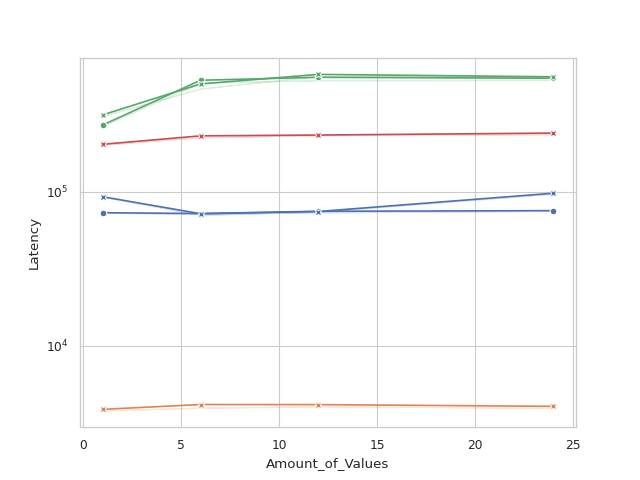

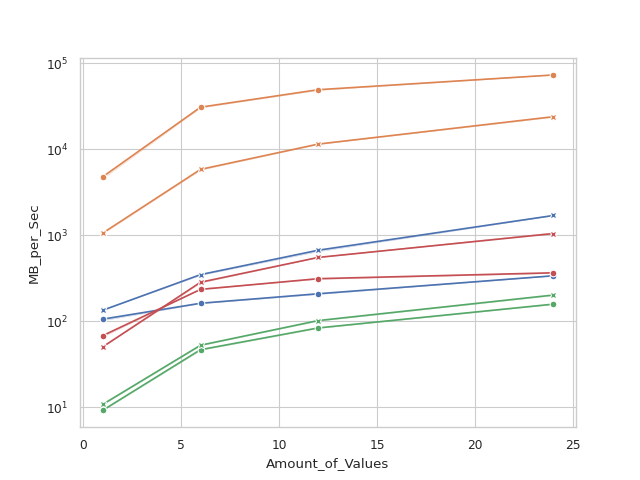

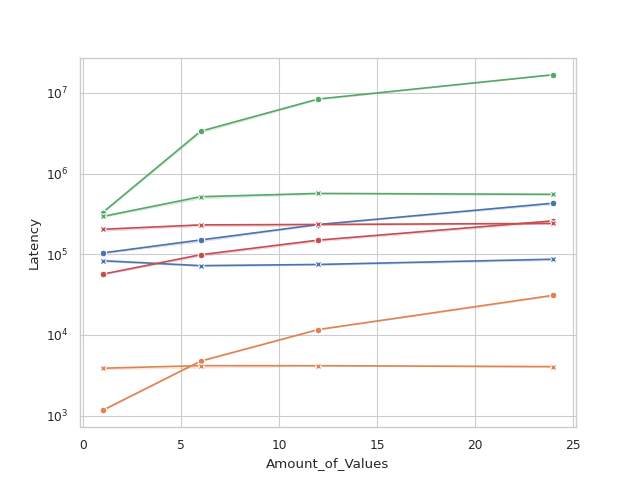

/tmp/ipykernel_317649/456568384.py:44: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  result_ratesQ_Ded2["Latency_per_Sent_Values"] = result_ratesQ_Ded2.apply(


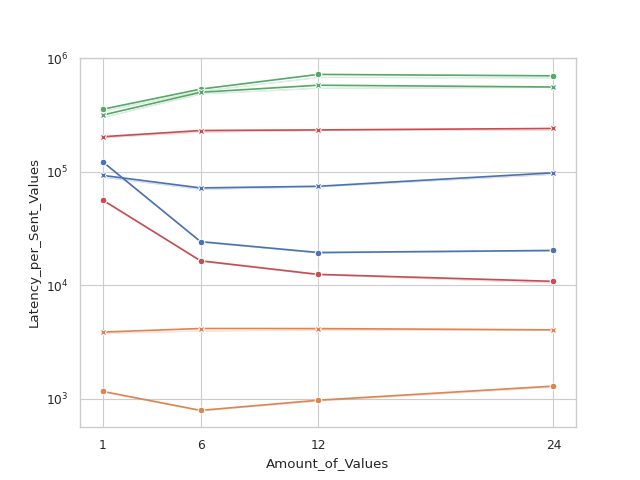

In [38]:


plt.figure("Q-Dim-Op-1")
# plt.title("RangeQueryRaw of 1 val. across various 'thick' tables")

sns.lineplot(data=results_ratesQ_Ded.loc[results_ratesQ_Ded['Operation'].str.contains(
    'RangeQueryRawData')], x="Amount_of_Values", y="Latency", hue="System", style="Mode", markers=True,  errorbar=("ci", 0.01), dashes=False)
plt.yscale('log')
plt.legend(loc='center right', bbox_to_anchor=(1.865, 0.5))

plt.savefig(path+'Q-Dim-oneDim-112.svg',
            format='svg', bbox_inches="tight")  # svg
plt.show()
plt.close()
plt.close()
plt.figure("Q-Dim-Op-1-AGG-mb")
sns.lineplot(data=results_ratesQ_Ded.loc[results_ratesQ_Ded['Operation'].str.contains('RangeQueryRawData') | results_ratesQ_Ded['Operation'].str.contains(
    'AllDim')], x="Amount_of_Values", y="MB_per_Sec", hue="System", errorbar=("ci", 0.01), style="Operation", markers=True, dashes=False)
plt.yscale('log')
plt.legend(loc='center right', bbox_to_anchor=(2.15, 0.5))

plt.savefig(path+'!Q-Dim-oneorallDim-MB-113.svg',
            format='svg', bbox_inches="tight")  # svg
plt.show()
plt.close()
plt.close()
plt.close()
plt.figure("Q-Dim-Op-1-AGG-lat")
# plt.title("RangeQueryRaw ")

sns.lineplot(data=results_ratesQ_Ded.loc[results_ratesQ_Ded['Operation'].str.contains('RangeQueryRawData') | results_ratesQ_Ded['Operation'].str.contains(
    'AllDim')], x="Amount_of_Values", y="Latency", hue="System", errorbar=("ci", 0.01), style="Operation", markers=True, dashes=False)
plt.yscale('log')
plt.legend(loc='center right', bbox_to_anchor=(2.15, 0.5))

plt.savefig(path+'Q-Dim-oneorallDim-114.svg',
            format='svg', bbox_inches="tight")  # svg
plt.show()
plt.close()


plt.figure("Q-Dim-Op-1-AGG-lin")
sns.set_context("poster")
result_ratesQ_Ded2 = results_ratesQ_Ded
# result_ratesQ_Ded2["Latency_per_Sent_Values"]=result_ratesQ_Ded2.apply( lambda x: x.Latency/x.Amount_of_Values if x.Operation.str.contains('AllDim')==True else  x.Latency )
result_ratesQ_Ded2["Latency_per_Sent_Values"] = result_ratesQ_Ded2.apply(
    lambda row: row.Latency/row.Amount_of_Values if 'AllDim' in row['Operation'] else row.Latency, axis=1)

# is it faster to retrieve data singularly or as groupt values, in variously thick groups
sns.lineplot(data=result_ratesQ_Ded2.loc[result_ratesQ_Ded2['Operation'].str.contains('RangeQueryRawData') | result_ratesQ_Ded2['Operation'].str.contains(
    'AllDim')].loc[result_ratesQ_Ded2['Mode'].str.contains('_reg')], x="Amount_of_Values", y="Latency_per_Sent_Values", hue="System", errorbar=("ci", 0.01), style="Operation", markers=True, dashes=False)
plt.yscale('log')

plt.legend(loc='center right', bbox_to_anchor=(2.15, 0.5))
plt.xticks([1, 6, 12, 24])
plt.savefig(path+'!Q-Dim-oneorallDim-latPval-115.svg',
            format='svg', bbox_inches="tight")  # svg
plt.show()
plt.close()

## Query System Metrics


### regurlar vs irregular transaction system usage 


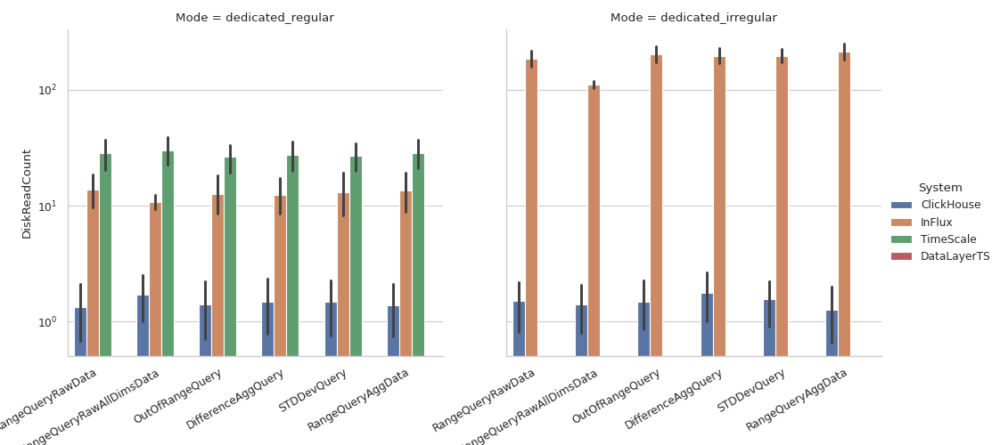

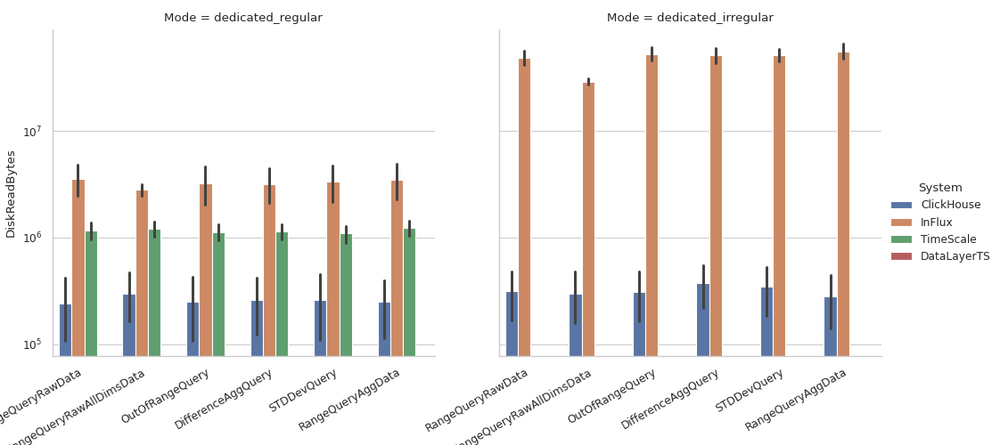

In [39]:
systemmetricsDED_R = systemmetricsDED[systemmetricsDED['Operation'].str.contains(
    "Query")]


# plt.figure("Q-Disk-Read-COunt-OP")
sns.catplot(data=systemmetricsDED_R, kind="bar", x='Operation',
            y="DiskReadCount", hue="System", col='Mode')
plt.gcf().autofmt_xdate()
plt.yscale('log')

plt.savefig(path+'QreadCount-116.svg', format='svg', bbox_inches="tight")
plt.show()
plt.close()


# plt.figure("Qu-Disk-Read-Bytes-OP")
sns.catplot(data=systemmetricsDED_R, kind="bar", x='Operation',
            y="DiskReadBytes", hue="System", col='Mode')
plt.gcf().autofmt_xdate()
plt.yscale('log')

plt.savefig(path+'QreadBytes-117.svg', format='svg', bbox_inches="tight")
plt.show()
plt.close()

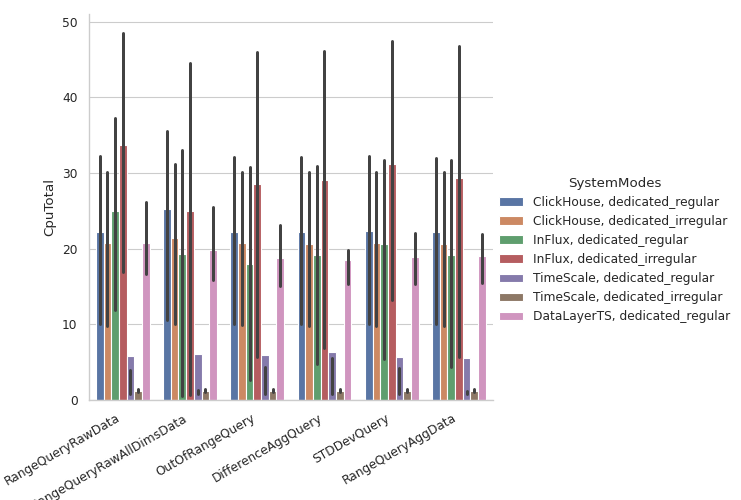

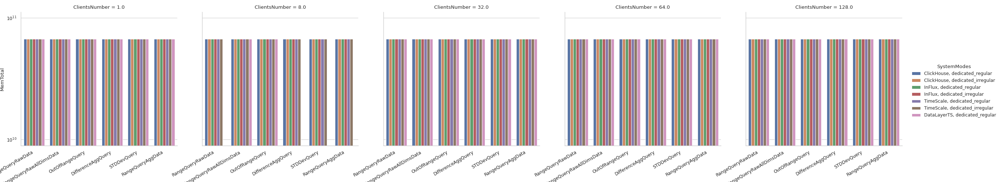

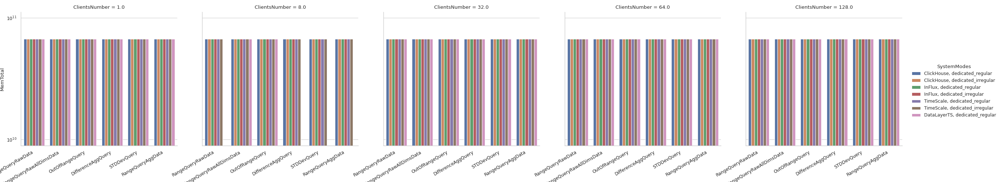

In [41]:
systemmetricsDED_R = systemmetricsDED_R.assign(
    SystemModes=lambda x: x.System+", "+x.Mode)

sns.set_context("paper")
plt.figure("Q-CPU-OP")
plt.title("Cpu query")
sns.catplot(data=systemmetricsDED_R, kind="bar", x='Operation',
            y="CpuTotal", hue="SystemModes", errorbar=("pi", 50))
plt.gcf().autofmt_xdate()
plt.savefig(path+'cpu-query-118.svg', format='svg', bbox_inches="tight")
plt.show()
plt.close()


plt.figure("Q-Mem-OP")
plt.title("Cpu query")
sns.catplot(data=systemmetricsDED_R, kind="bar", x='Operation',
            y="MemTotal", hue="SystemModes", col='ClientsNumber', errorbar=("pi", 50))
plt.gcf().autofmt_xdate()
plt.yscale('log')

plt.savefig(path+'cpu-query-119.svg', format='svg', bbox_inches="tight")
plt.show()
plt.close()


plt.figure("Q-Mem-Mode-OP")
plt.title("Cpu query")
sns.catplot(data=systemmetricsDED_R, kind="bar", x="Operation", col='ClientsNumber',
            y="MemTotal", hue="SystemModes", errorbar=("pi", 50))
plt.gcf().autofmt_xdate()
plt.yscale('log')

plt.savefig(path+'cpu-query-120.svg', format='svg', bbox_inches="tight")
plt.show()
plt.close()

#  Storage

In [42]:
# gruppiere alle consecutiven TS-DB compos für popDay
#


# consecutives = systemmetrics['Timestamp','System'].diff().ne(0).cumsum()
# df['a'].groupby(consecutives).agg(list)

# storage= systemmetrics.loc[systemmetrics.Mode.str.contains("pop")&systemmetrics.Operation.str.contains("Ing")].groupby(['Timestamp','System', 'Regularity','Amount_of_Values'], as_index=False).max().assign(FsFull= lambda x: (x.FsSize-x.FsFree) / 1000000 )


# sns.catplot(data=storage, x="System", y="FsFull",  hue="Regularity",
#             kind="bar", col="Amount_of_Values", col_wrap=2, errorbar=("pi", 50), )
# plt.yscale('linear')
# # plt.title("Comparison: Regular vs Irregular Data Querying based on Number of Clients")
# plt.savefig(path+'Storage-Reg-Dim-121.svg', format='svg', bbox_inches="tight")
# plt.show()
# plt.close()

# 